In [695]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import numpy as np
import scirpy as ir
import matplotlib as mpl
from collections import Counter
import matplotlib.ticker as ticker
from matplotlib.ticker import FuncFormatter, PercentFormatter
mpl.rcParams['font.family'] = 'Arial'
figPath = "NKTCL-figure-2.18"
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14

In [2]:
nktcl_ir = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-ir-EBV.h5ad")
adata_concat = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-gex-EBV-3.8.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/anndata/utils.py:334: ExperimentalFeatureWarning: Support for Awkward Arrays is currently experimental. Behavior may change in the future. Please report any issues you may encounter!
  warnings.warn(msg, category, stacklevel=stacklevel)
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [ ]:
# read the existing analysis files
dataPath = "/data/NKTCL/NKTCL_Multi/analysis"
adata_T = sc.read_h5ad(f"{dataPath}/NKTCL-T-4.4.h5ad")
adata_CD8T = sc.read_h5ad(f"{dataPath}/NKTCL-CD8T-4.4.h5ad")
adata_CD4T = sc.read_h5ad(f"{dataPath}/NKTCL-CD4T-3.18.h5ad")

In [3]:
adata_T = adata_concat[adata_concat.obs['anno-pca'].isin(
  ['T cells', 'Immune mixed'])]

In [706]:
def clu(adata, key_added="leiden-1", 
        n_neighbors=50, n_pcs=30, 
        rep='X_pca_harmony', 
        do_har=False, 
        max_iter=20, 
        do_scrublet=False, 
        har_key='batch', 
        resolution=1):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
    sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
    if do_har and len(adata.obs[har_key].cat.categories) > 1:
        sc.external.pp.harmony_integrate(adata, key=har_key,max_iter_harmony=max_iter)
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    else:
        print("Evaluating neighbors only...")
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=resolution, key_added=key_added)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1899: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
2025-03-08 12:38:06,328 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-08 12:38:59,195 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-08 12:39:04,511 - harmonypy - INFO - Iteration 1 of 20
2025-03-08 12:40:03,637 - harmonypy - INFO - Iteration 2 of 20
2025-03-08 12:40:43,977 - harmonypy - INFO - Iteration 3 of 20
2025-03-08 12:41:14,887 - harmonypy - INFO - Iteration 4 of 20
2025-03-08 12:41:40,260 - harmonypy - INFO - Iteration 5 of 20
2025-03-08 12:42:01,042 - harmonypy - INFO - Converged after

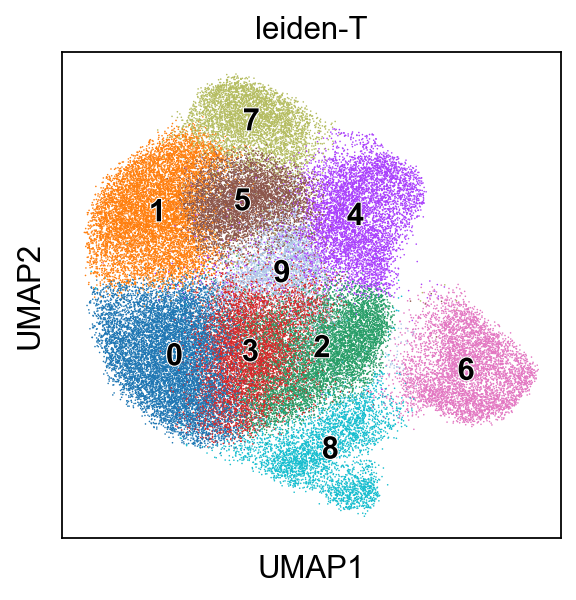

In [5]:
adata_T = clu(adata_T, key_added='leiden-T', do_har=True)

In [32]:
sc.tl.rank_genes_groups(adata_T, groupby='anno-subTfixed')
sc.tl.dendrogram(adata_T, groupby='anno-subTfixed')


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


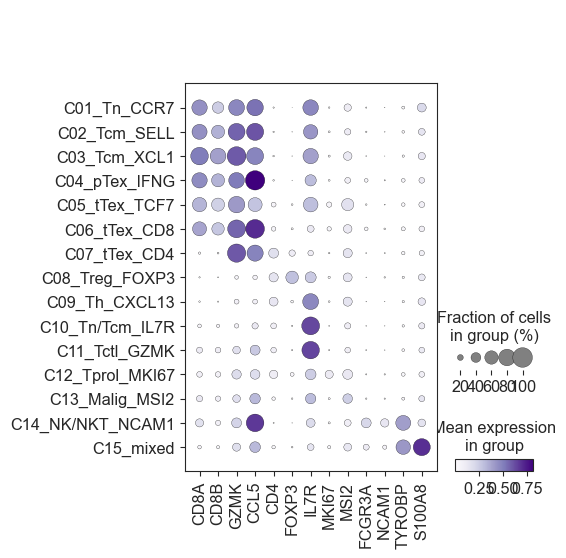

In [692]:
fig, ax = plt.subplots(1,1,figsize=(4.5,6))
sc.pl.dotplot(adata_T, groupby='anno-subTfixed',  cmap='Purples', var_names=[
  'CD8A', 'CD8B', 'GZMK', 'CCL5','CD4', "FOXP3",'IL7R','MKI67','MSI2', 'FCGR3A','NCAM1', 'TYROBP','S100A8'], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
fig.savefig(f"{figPath}/NKTCL-Tmarkers.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


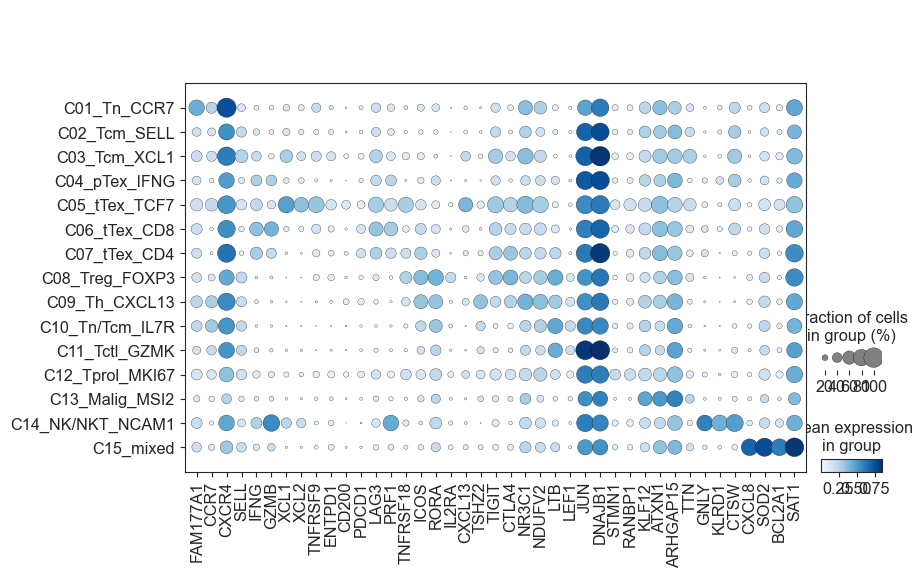

In [694]:
fig, ax = plt.subplots(1,1,figsize=(9,6))
sc.pl.dotplot(adata_T, groupby='anno-subTfixed',  cmap='Blues', var_names=[
    'FAM177A1','CCR7', 'CXCR4', 'SELL','IFNG','GZMB', "XCL1", "XCL2",'TNFRSF9','ENTPD1','CD200', 'PDCD1',"LAG3", 'PRF1',  
    'TNFRSF18', 'ICOS', 'RORA',
  'IL2RA','CXCL13','TSHZ2', 'TIGIT', "CTLA4", 'NR3C1', 'NDUFV2','LTB','LEF1', 'JUN','DNAJB1',"STMN1", 
  'RANBP1','KLF12','ATXN1','ARHGAP15', 'TTN', 'GNLY', 'KLRD1','CTSW','CXCL8', 'SOD2', 'BCL2A1', 'SAT1'], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
fig.savefig(f"{figPath}/NKTCL-Tvariables.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


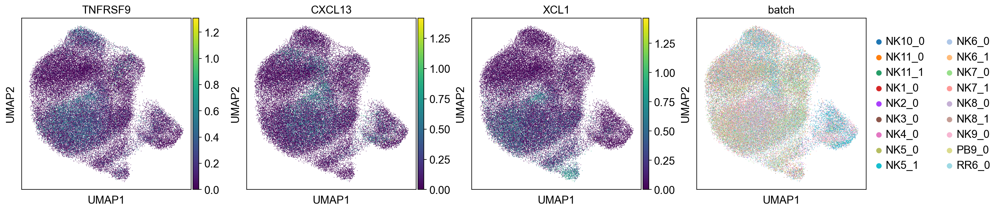

In [44]:
sc.pl.umap(adata_T, color=['TNFRSF9','CXCL13','XCL1','batch'])

In [ ]:
adata_T.obs['annotation'] = adata_T.obs['leiden-T']

In [ ]:
adata_Tsave = adata_T.copy()

In [ ]:
adata_T.var_names = list(adata_T.var_names)
adata_T.var_names_make_unique()

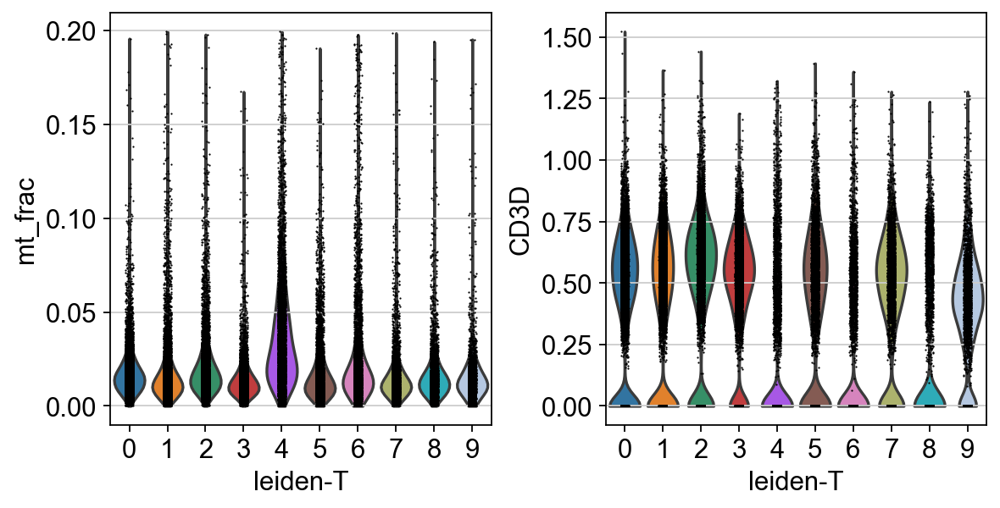

In [ ]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3']
sc.tl.score_genes(adata_T, gene_list=exgenes, score_name='exhaustion')
sc.tl.score_genes(adata_T, gene_list=cytogenes, score_name='cytotoxicity')

In [ ]:
mdata_T = mu.MuData({'gex': adata_T, "airr":nktcl_ir})
mdata_T

MuData object with n_obs × n_vars = 80538 × 33727
  2 modalities
    gex:	59153 x 33727
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'proliferation', 'anno-subT1', 'anno-focus'
      var:	'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-T_colors', 'anno-Tfixed_colors', 'anno-pca_colors', 'anno-subT1_colors', 'anno-subT_colors', 'anno-subTfixed_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-pca', 'dendrogram_anno-subTfixed', 'dendrogram_leiden-T', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-T_colors', 'leiden-pca_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'treatment_colors', 'umap', 'airr:clone_id_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'Raw'
      obsp:	'connectivities', 'distances'
    airr:	60443 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'scirpy_version', 'ir_dist_nt_identity', 'clone_id'
      obsm:	'airr', 'chain_indices'

  0%|          | 0/43615 [00:00<?, ?it/s]

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


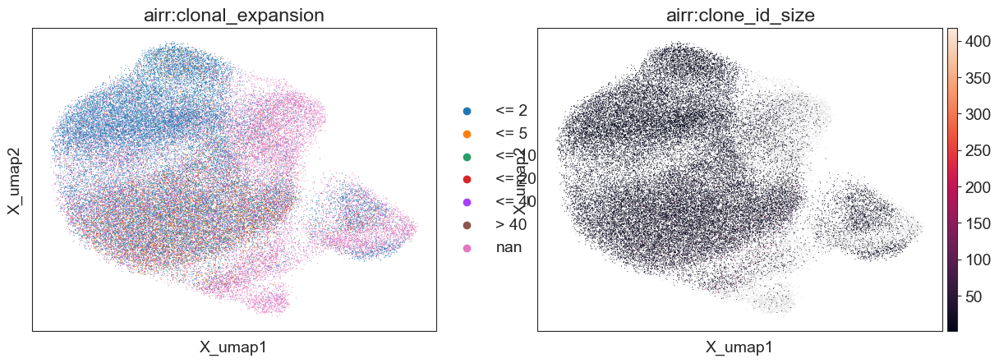

In [ ]:
ir.pp.index_chains(mdata_T)
ir.tl.chain_qc(mdata_T)
ir.pp.ir_dist(mdata_T, metric="identity", sequence="nt", key_added="ir_dist_nt_identity", n_jobs=8)
ir.tl.define_clonotypes(mdata_T, key_added="clone_id", same_v_gene=False, dual_ir='primary_only',receptor_arms="all" )
ir.tl.clonal_expansion(mdata_T, target_col="clone_id", key_added="clonal_expansion", breakpoints=[2,5,10,20,40])
mu.pl.embedding(mdata_T, basis='gex:umap',color=['airr:clonal_expansion', 'airr:clone_id_size'])

In [33]:
adata_T.var_names = list(adata_T.var_names)
adata_T.var_names_make_unique()
adata_T.var_names.is_unique

True

In [586]:
adata_T.obs['cnv_status'] = adata_concat.obs['cnv_status']
adata_T.obs['cnv_score'] = adata_concat.obs['cnv_score']

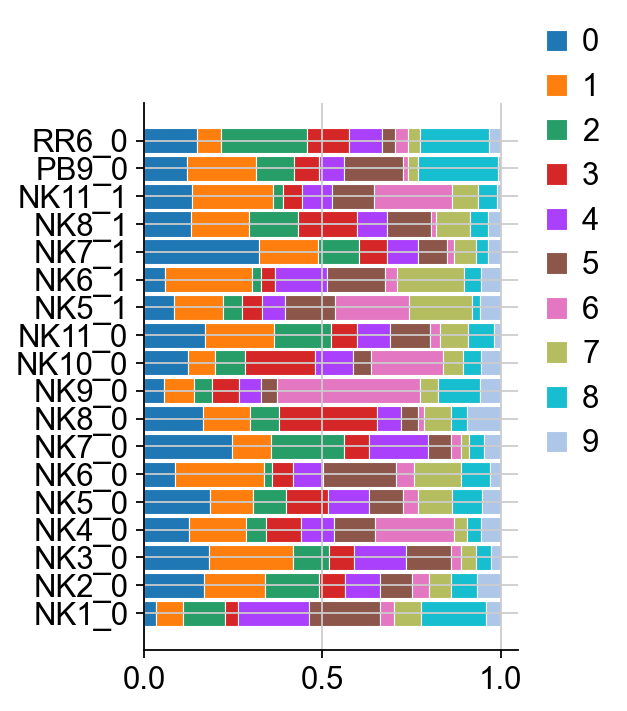

In [606]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_T.obs['leiden-T'].unique())
cell_types.sort()
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_T[(adata_T.obs["leiden-T"] == ct) & (adata_T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(3, 4.5))
propPlot(age_df, ax=ax0, barlabels=barlabels)

In [34]:
adata_T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-gexT-2.19.h5ad")

Seperate CD4T, CD8T and MalignantT

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


Evaluating neighbors only...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


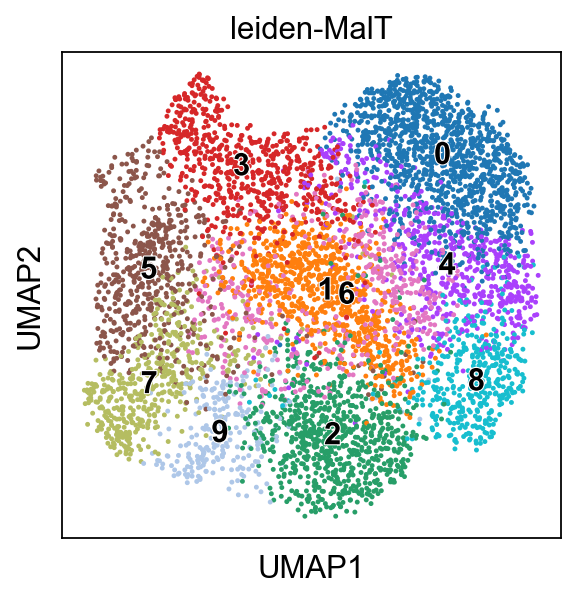

In [612]:
adata_MalT = adata_T[adata_T.obs['leiden-T'].isin(['4'])]
adata_MalT = clu(adata_MalT, key_added='leiden-MalT', do_har=False, rep='X_pca')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


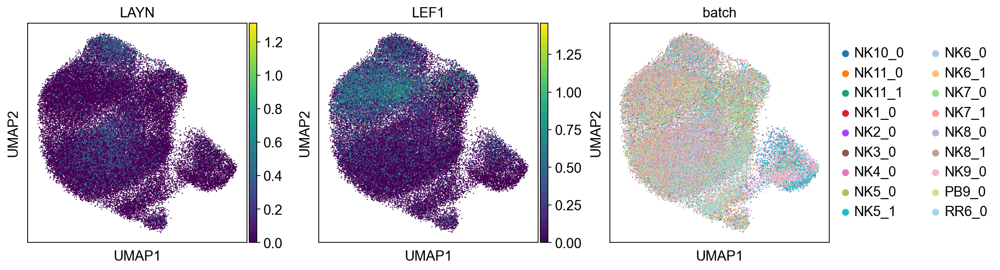

In [689]:
sc.pl.umap(adata_T, color=['LAYN','LEF1','batch'], size=5)

In [ ]:
adata_CD8T = adata_T[adata_T.obs['leiden-T'].isin(['0', '2', '3', '9'])]
adata_CD8T = clu(adata_CD8T, key_added='leiden-CD8T', do_har=True)

In [ ]:
adata_CD4T = adata_T[adata_T.obs['leiden-T'].isin(['1', '5', '7'])]
adata_CD4T = clu(adata_CD4T, key_added='leiden-CD4T', do_har=True)

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
2025-03-09 13:14:51,099 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-09 13:15:17,243 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-09 13:15:17,440 - harmonypy - INFO - Iteration 1 of 20
2025-03-09 13:15:31,613 - harmonypy - INFO - Iteration 2 of 20
2025-03-09 13:15:47,426 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


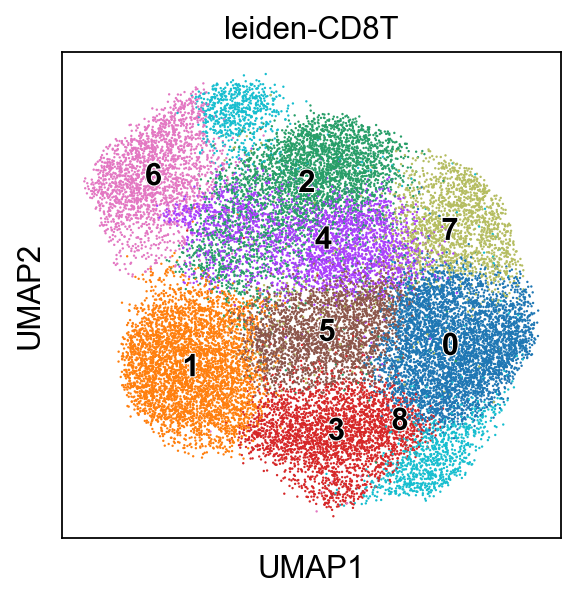

In [609]:
adata_CD8T = clu(adata_CD8T, key_added='leiden-CD8T', do_har=True)

In [ ]:
sc.tl.leiden(adata_CD8T, resolution=1.2, key_added='leiden-CD8T-1.2')
sc.tl.leiden(adata_CD8T, resolution=1.3, key_added='leiden-CD8T-1.3')
sc.tl.leiden(adata_CD8T, resolution=1.4, key_added='leiden-CD8T-1.4')
sc.tl.leiden(adata_CD8T, resolution=1.6, key_added='leiden-CD8T-1.6')
sc.tl.leiden(adata_CD8T, resolution=2.0, key_added='leiden-CD8T-2.0')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


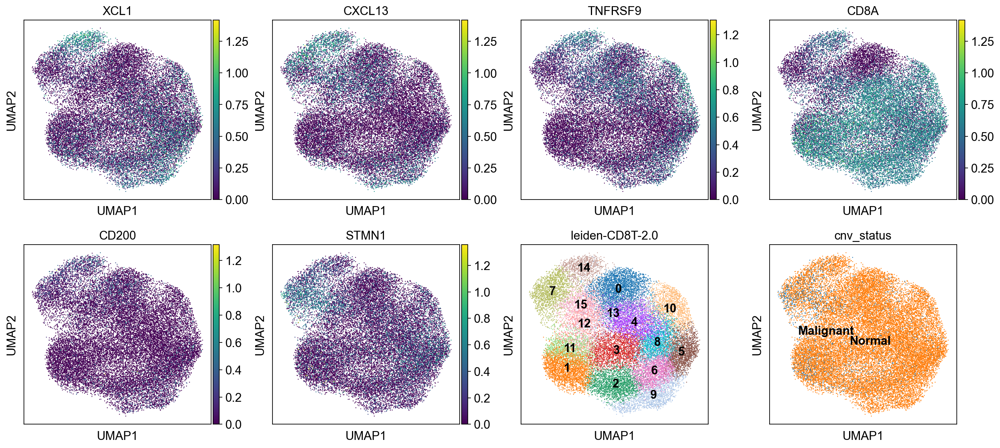

In [644]:
sc.pl.umap(adata_CD8T, color=['XCL1', 'CXCL13', 'TNFRSF9', 'CD8A', 'CD200', 'STMN1','leiden-CD8T-2.0', 'cnv_status'], legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


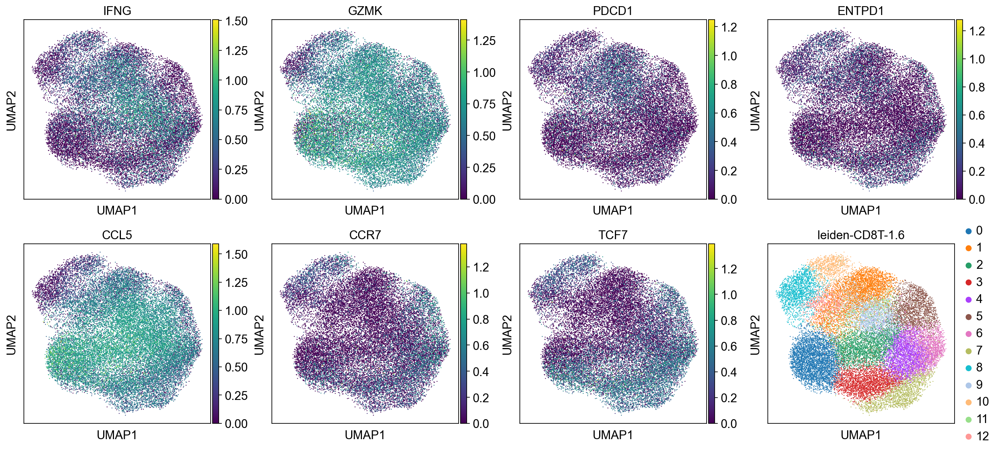

In [641]:
sc.pl.umap(adata_CD8T, color=['IFNG', 'GZMK', 'PDCD1', 'ENTPD1', 'CCL5', 'CCR7','TCF7','leiden-CD8T-1.6'])

In [12]:
def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

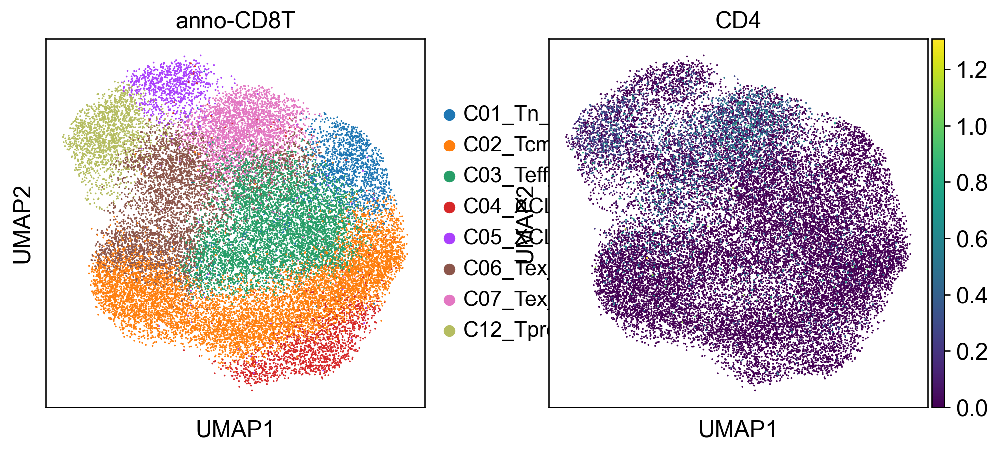

In [1522]:
annot = {
  'C01_Tn_CCR7':['10'],  # CCR7
  'C02_Tcm_SELL': ['1','2','5', '6'],  # SELL,IL7R
  'C03_Teff_IFNG':['3', '4', '8'], # IFNG
  'C04_XCL1_CD200-': ['9'], # XCL1, CD200+
  'C05_XCL1_CD200+': ['14'], # XCL1, CD200+
  'C06_Tex_CD8':['15', '12', '13', '11'], # CD8
  'C07_Tex_CD4':['0'], # CD4
  'C12_Tprol_MKI67':['7'], # MKI67
}
adata_CD8T = anno(adata=adata_CD8T, obsKey='anno-CD8T', obsVal='leiden-CD8T-2.0', annoDict=annot)
sc.pl.umap(adata_CD8T, color=['anno-CD8T', 'CD4'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


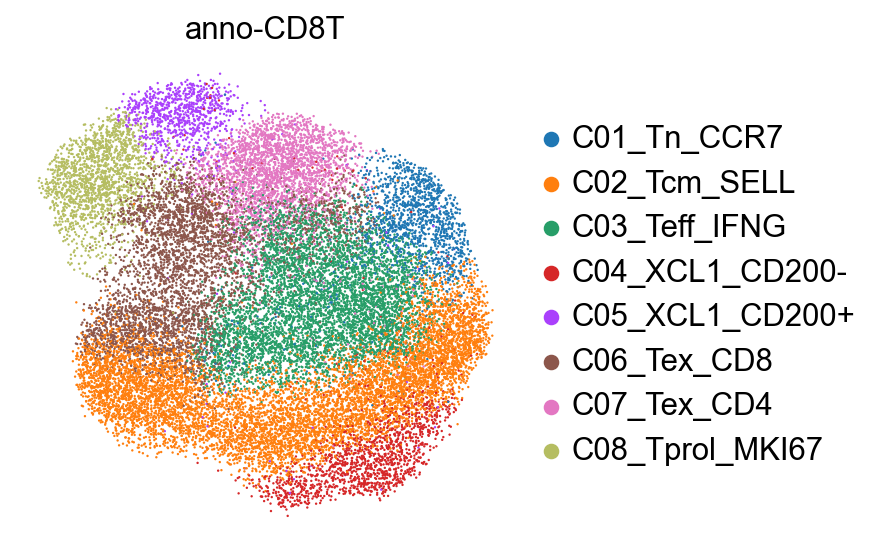

In [648]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T, color=['anno-CD8T'], show=False, ax=ax)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-CD8T_annotation.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


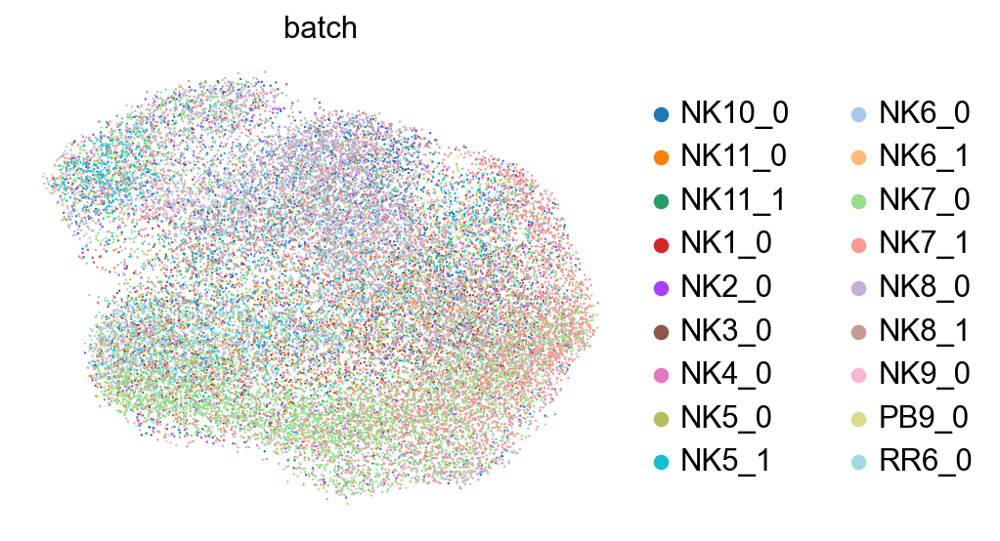

In [649]:
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
sc.pl.umap(adata_CD8T, color=['batch'], show=False, ax=ax)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-CD8T_batch.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


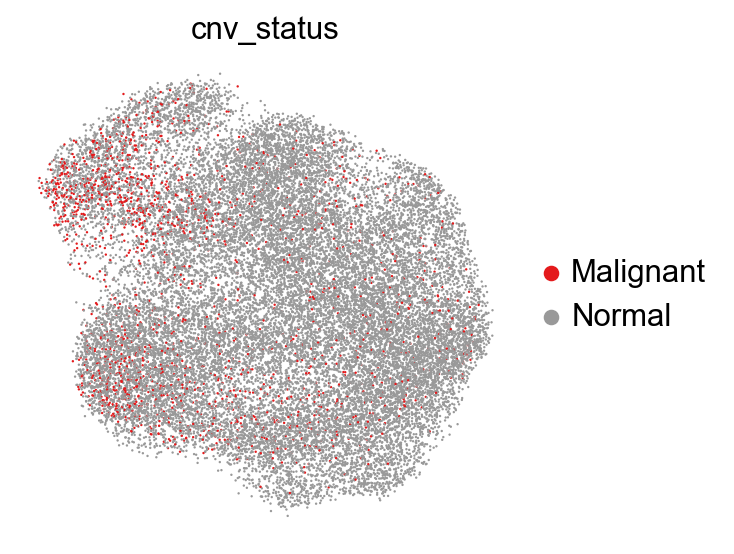

In [651]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T, color=['cnv_status'], show=False, ax=ax, palette='Set1')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-CD8T_cnv_status.png', dpi=400, bbox_inches='tight')

[Text(0, 0, 'C01_Tn_CCR7'),
 Text(1, 0, 'C02_Tcm_SELL'),
 Text(2, 0, 'C03_Teff_IFNG'),
 Text(3, 0, 'C04_XCL1_CD200-'),
 Text(4, 0, 'C05_XCL1_CD200+'),
 Text(5, 0, 'C06_Tex_CD8'),
 Text(6, 0, 'C07_Tex_CD4'),
 Text(7, 0, 'C08_Tprol_MKI67')]

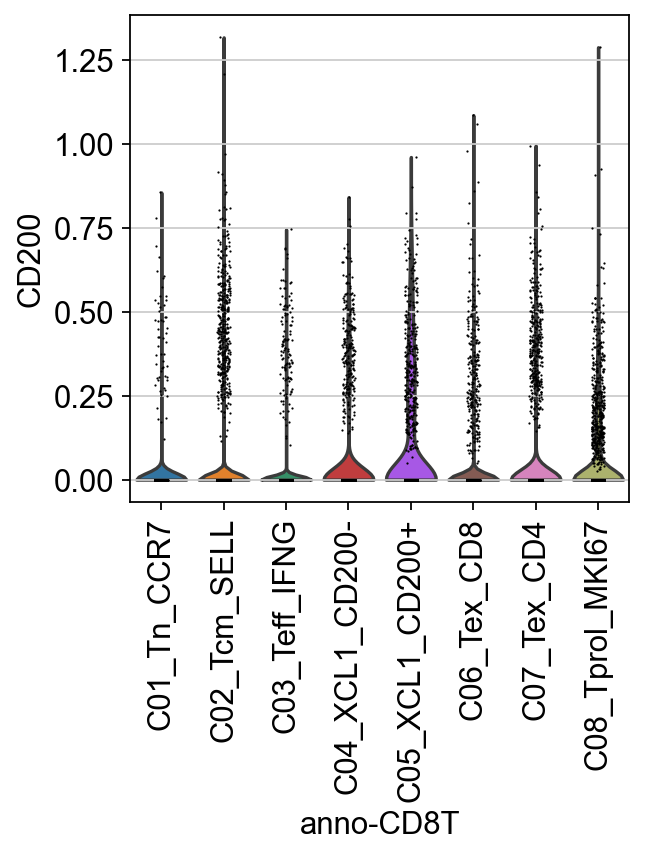

In [652]:
fig, ax = plt.subplots(figsize=(4, 4))
sc.pl.violin(adata_CD8T, keys=['CD200'], groupby='anno-CD8T', ax=ax, show=False)
ax.set_xticklabels(adata_CD8T.obs['anno-CD8T'].cat.categories, rotation=90)

In [ ]:
for gene in ['CD3D', 'CD8A', 'CD4', 'CTLA4', 
             'LAG3', 'PDCD1', 'TIGIT', 'HAVCR2', 
             'SELL', 'CXCL13','IFNG', 'GZMK', 
             'XCL1','CCR7', 'IL7R', 'CCL5']:
  fig, ax = plt.subplots(1, 1, figsize=(5.8, 4))
  sc.pl.umap(adata_CD8T, color=gene,size=5, ax=ax, show=False)
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_ylabel("")
  # ax.legend(  handletextpad=0.5, frameon=False,
  #                     borderpad=0.6,
  #                     columnspacing=1.3,
  #                     handlelength=0.65, fontsize=12)
  fig.savefig(f"{figPath}/S1b-{gene}.png", dpi=400, bbox_inches='tight')

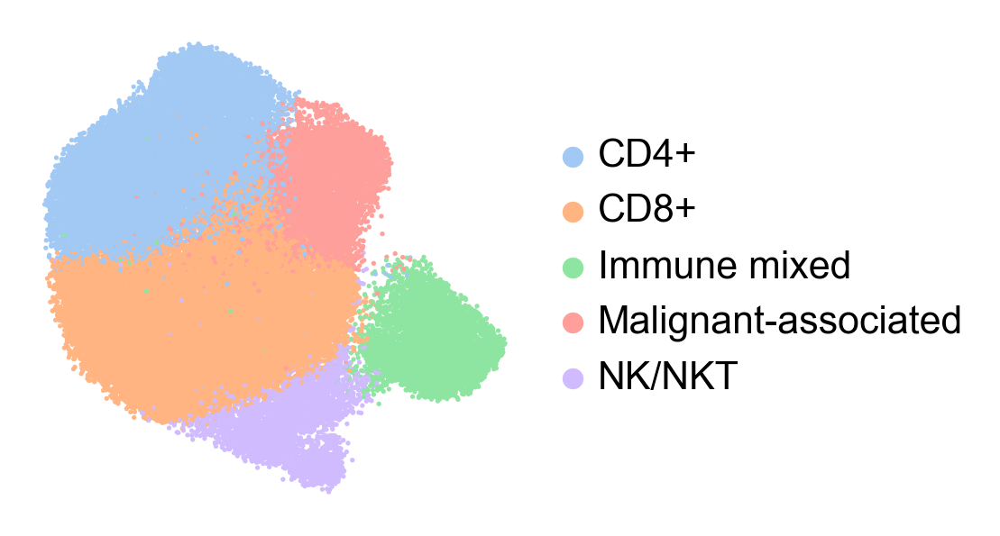

In [ ]:
annot = {
  "CD4+": ['1', '5', '7'],
  "CD8+": ['0', '2', '3', '9'],
  "Malignant-associated": ['4'],
  "NK/NKT": ['8'],
  "Immune mixed": ['6'],
}
adata_T = anno(adata_T, annot, 'anno-T', 'leiden-T')

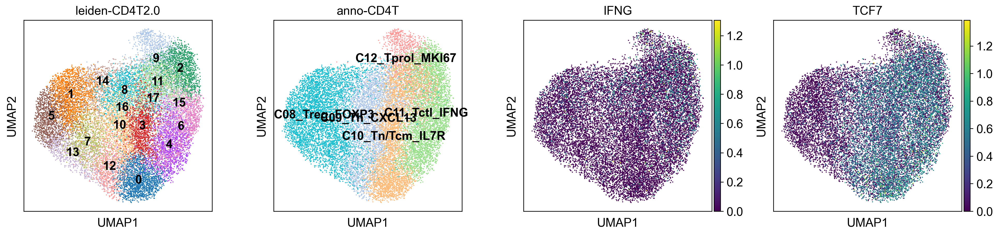

In [1550]:
sc.pl.umap(adata_CD4T, color=['leiden-CD4T2.0', 'anno-CD4T', 'IFNG', 'TCF7'], legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


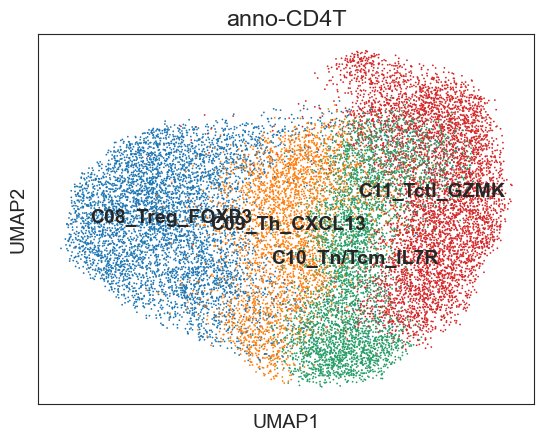

In [668]:
annot = {
  "C08_Treg_FOXP3": ['1', '5', '7', '13', '14'],
  "C09_Th_CXCL13": ['8', '10', '12', '16'],
  "C10_Tn/Tcm_IL7R": ['0', '3', '11', '17'],
  "C11_Tctl_GZMK": ['2', '4', '6', '9','15'],
}
adata_CD4T = anno(adata_CD4T, annot, 'anno-CD4T', 'leiden-CD4T2.0')
sc.pl.umap(adata_CD4T, color=['anno-CD4T'], legend_loc='on data')

In [666]:
annot = {
  "C08_Treg_FOXP3": ['1', '5', '7', '13', '14'],
  "C09_Th_CXCL13": ['8', '10', '12', '16'],
  "C10_Tn/Tcm_IL7R": ['0', '3', '11', '17'],
  "C11_Tctl_GZMK": ['2', '4', '6','15'],
  "C12_Tprol_MKI67": ['9'],
}
adata_CD4T = anno(adata_CD4T, annot, 'anno-CD4T1', 'leiden-CD4T2.0')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


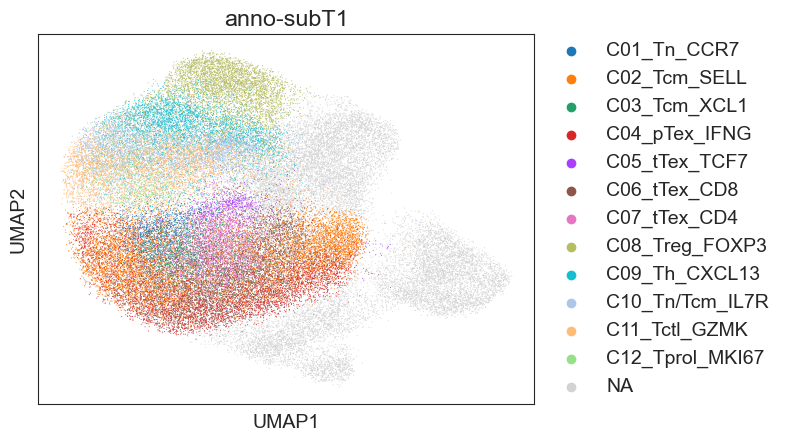

In [669]:
adata_T.obs['anno-subT'] = pd.concat([adata_CD4T.obs['anno-CD4T'], adata_CD8T.obs['anno-CD8T']], axis=0)
adata_T.obs['anno-subT1'] = pd.concat([adata_CD4T.obs['anno-CD4T1'], adata_CD8T.obs['anno-CD8T']], axis=0)
sc.pl.umap(adata_T, color=['anno-subT1'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


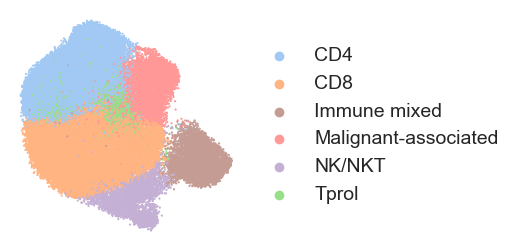

In [678]:
# fix the initial annotations of CD4 and CD8
annot = {
  "CD8": ['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4'],
  "CD4": [ 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK'],
  "Tprol": ['C12_Tprol_MKI67'],
}
adata_T.obs["anno-Tfixed"] = list(adata_T.obs["anno-T"])
adata_T = anno(adata_T, annot, "anno-Tfixed", 'anno-subT1', default=None)
adata_T = anno(adata_T, {'Tprol':['CD8+']}, "anno-Tfixed", 'anno-Tfixed', default=None)
import seaborn as sns
fig, ax = plt.subplots(1, 1, figsize=(3, 3))
palette = ["#a1c9f4","#ffb482",'#c49c94','#ff9896','#c5b0d5','#98df8a']
sc.pl.umap(adata_T, color=['anno-Tfixed'],palette=palette, size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_T_clonal1.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


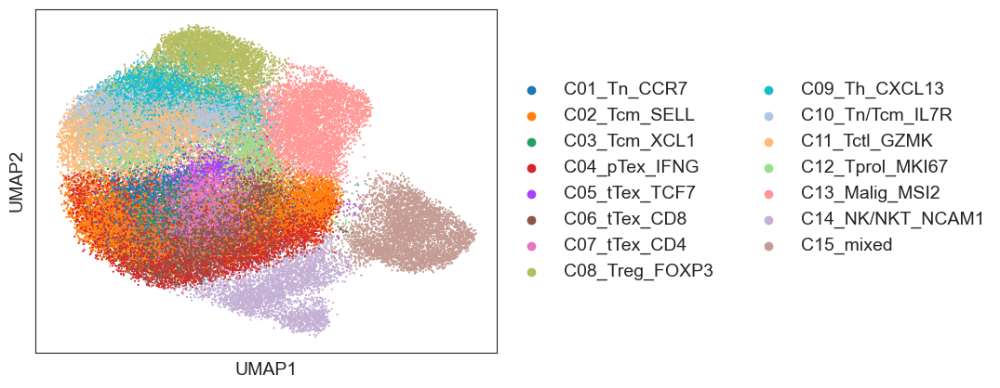

In [681]:
annot = {
  "C12_Tprol_MKI67": ['Tprol',],
  "C13_Malig_MSI2": ['Malignant-associated',],
  "C14_NK/NKT_NCAM1": ['NK/NKT'],
  "C15_mixed": ['Immune mixed'],
}
adata_T.obs["anno-subTfixed"] = list(adata_T.obs["anno-subT1"])
adata_T = anno(adata_T, annot, "anno-subTfixed", 'anno-Tfixed', default=None)
sc.pl.umap(adata_T, color=['anno-subTfixed'],palette=sc.pl.palettes.vega_20_scanpy, size=10,title='')

In [1555]:
adata_CD8T1 = adata_T[adata_T.obs['anno-Tfixed'] == 'CD8']
adata_CD4T1 = adata_T[adata_T.obs['anno-Tfixed'] == 'CD4']
adata_CD8T1.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.4.h5ad")
adata_CD4T1.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-4.4.h5ad")

In [1556]:
adata_CD8T1 = adata_CD8T
adata_CD8T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.4.h5ad")

In [16]:
def propPlot(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, 0), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_xlabel('Cell proportions')
    else:
        ax.yaxis.set_visible(False)
    ax.set_ylabel(xlabel)
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

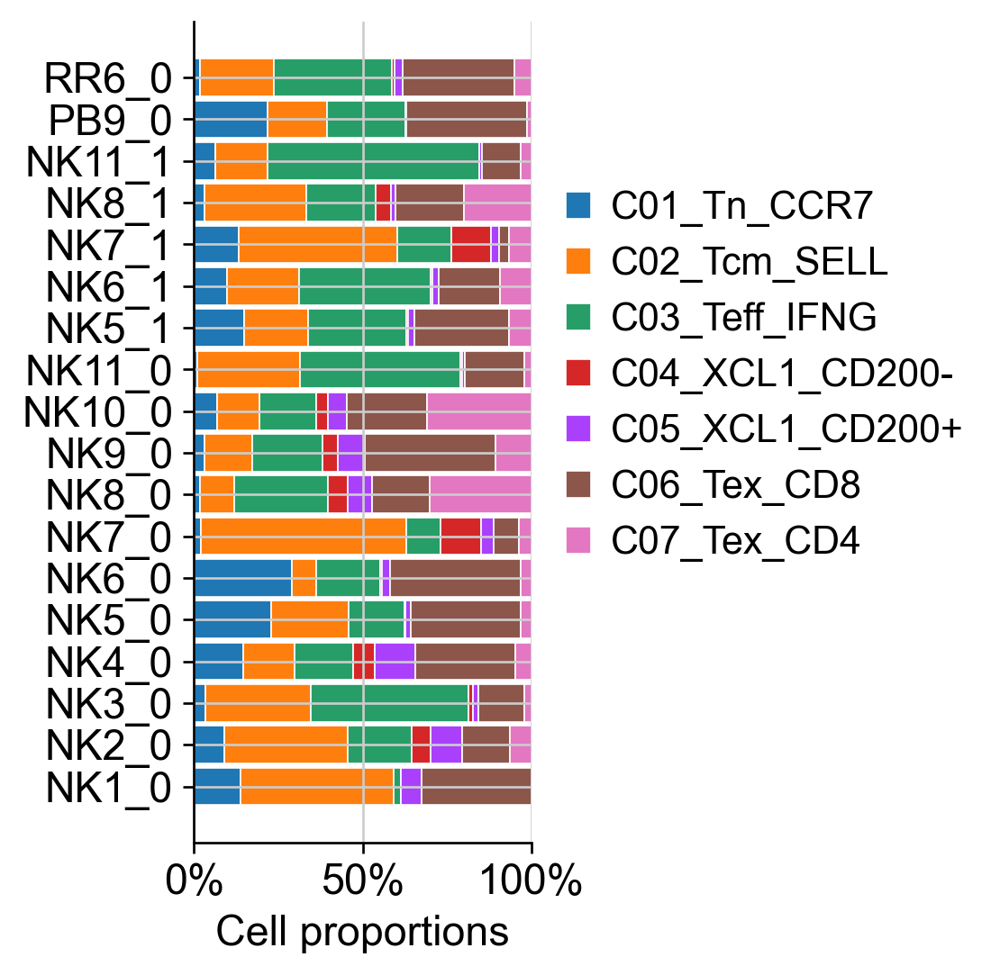

In [1558]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_CD8T.obs['anno-subTfixed'].unique())
cell_types.sort()
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD8T[(adata_CD8T.obs["anno-subTfixed"] == ct) & (adata_CD8T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(2, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', show_y=True)
fig0.savefig(f"{figPath}/EBV-CD8T_proportions.svg",bbox_inches='tight')

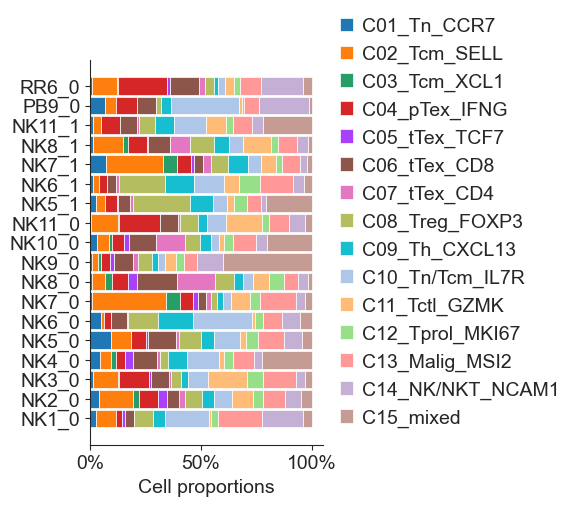

In [683]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_T.obs['anno-subTfixed'].unique())
cell_types.sort()
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_T[(adata_T.obs["anno-subTfixed"] == ct) & (adata_T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(3, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', show_y=True)
fig0.savefig(f"{figPath}/EBV-T_proportions1.svg",bbox_inches='tight')

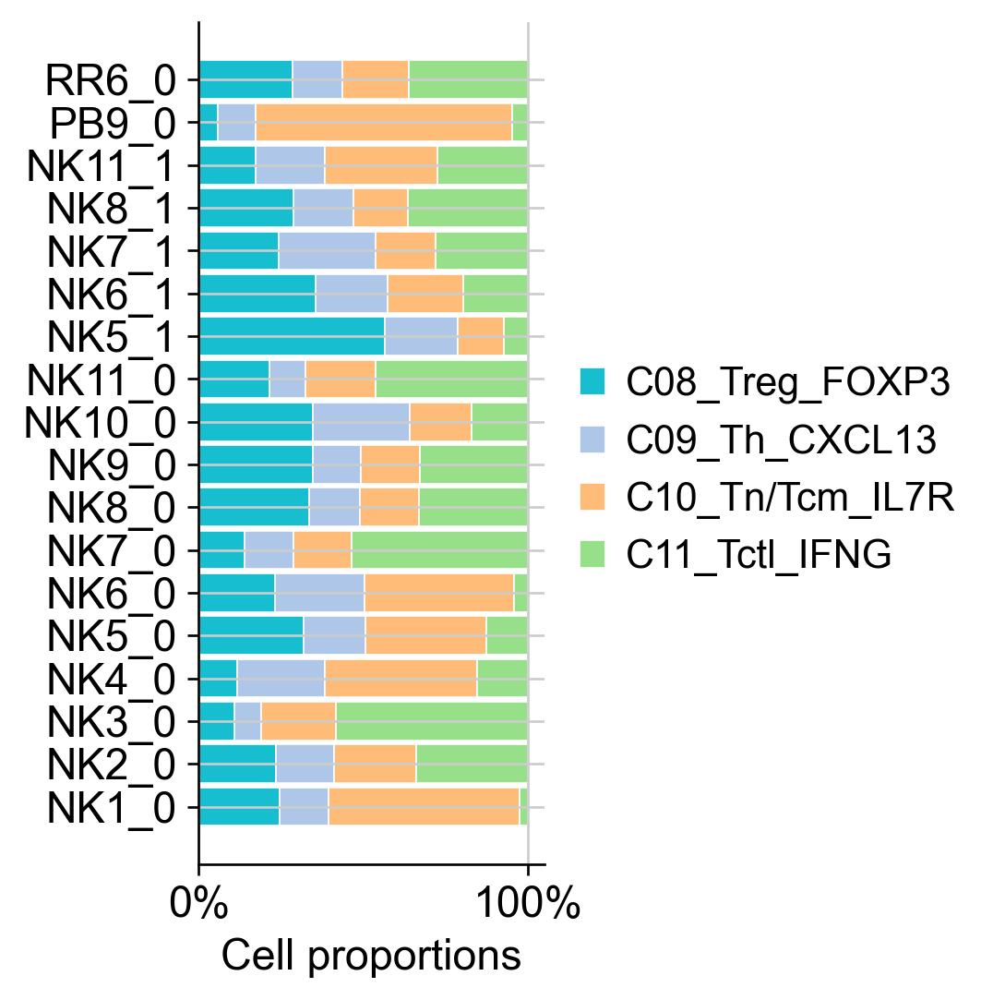

In [1560]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_CD4T.obs['anno-CD4T'].unique())
cell_types.sort()
colors = sc.pl.palettes.vega_20_scanpy[8:]
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD4T[(adata_CD4T.obs["anno-CD4T"] == ct) & (adata_CD4T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(2, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', show_y=True, colors=colors)
fig0.savefig(f"{figPath}/EBV-CD4T_proportions.svg",bbox_inches='tight')

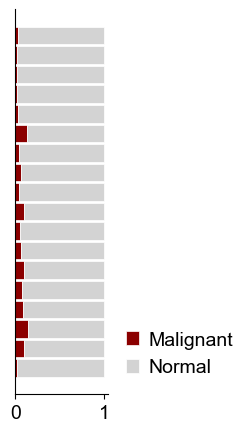

In [25]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_CD8T.obs['cnv_status'].unique())
cell_types.sort()
colors=['darkred', 'lightgrey']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD8T[(adata_CD8T.obs['cnv_status'] == ct) & (adata_CD8T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.2, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, show_y=False, xlabel="")
fig0.savefig(f"{figPath}/EBV-CD8T_cnv_proportions.svg",bbox_inches='tight')

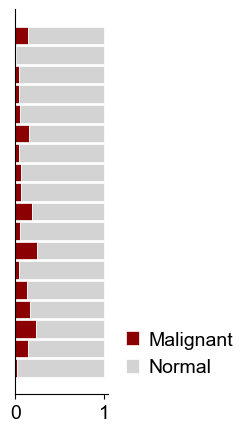

In [26]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
cell_types = list(adata_CD4T.obs['cnv_status'].unique())
cell_types.sort()
colors=['darkred', 'lightgrey']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_CD4T[(adata_CD4T.obs['cnv_status'] == ct) & (adata_CD4T.obs["batch"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.2, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, show_y=False, xlabel="")
fig0.savefig(f"{figPath}/EBV-CD4T_cnv_proportions.svg",bbox_inches='tight')

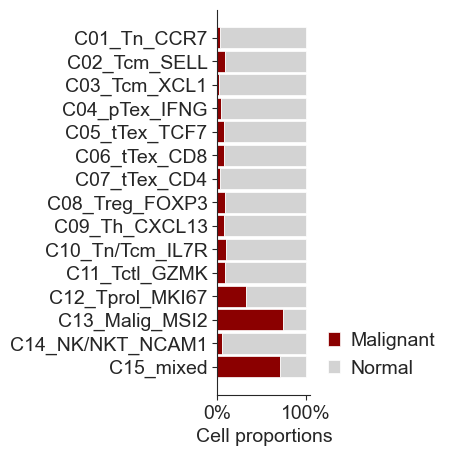

In [685]:
barlabels = list(adata_T.obs['anno-subTfixed'].cat.categories)
barlabels.reverse()
cell_types = list(adata_T.obs['cnv_status'].unique())
cell_types.sort()
colors=['darkred', 'lightgrey']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([len(adata_T[(adata_T.obs['cnv_status'] == ct) & (adata_T.obs["anno-subTfixed"] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.2, 5))
propPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, show_y=True, xlabel="")
fig0.savefig(f"{figPath}/EBV-T_cnv_proportions.svg",bbox_inches='tight')

In [128]:
adata_CD8T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-gexCD8T-2.19.h5ad")

In [1435]:
adata_CD4T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-3.18.h5ad")

In [1562]:
mdata_CD8T = mu.MuData({'gex': adata_CD8T, "airr":nktcl_ir})
mdata_CD8T

MuData object with n_obs × n_vars = 66124 × 33727
  2 modalities
    gex:	24411 x 33727
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'leiden-CD8T1'
      var:	'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-T_colors', 'anno-Tfixed_colors', 'anno-pca_colors', 'anno-subTfixed_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-pca', 'dendrogram_leiden-T', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-CD8T1_colors', 'leiden-T_colors', 'leiden-pca_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'treatment_colors', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'Raw'
      obsp:	'connectivities', 'distances'
    airr:	60443 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'scirpy_version', 'ir_dist_nt_identity', 'clone_id'
      obsm:	'airr', 'chain_indices'

In [508]:
mdata_CD4T = mu.MuData({'gex': adata_CD4T, "airr":nktcl_ir})
mdata_CD4T

MuData object with n_obs × n_vars = 64458 × 33727
  2 modalities
    gex:	18347 x 33727
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'leiden-CD4T', 'leiden-CD4T1.5', 'leiden-CD4T1.6', 'leiden-CD4T1.7', 'leiden-CD4T1.8', 'leiden-CD4T2.0', 'anno-CD4T', 'anno-focus'
      var:	'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-CD4T_colors', 'anno-T_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-pca', 'dendrogram_leiden-T', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-CD4T1.5_colors', 'leiden-CD4T2.0_colors', 'leiden-CD4T_colors', 'leiden-T_colors', 'leiden-pca_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'treatment_colors', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'Raw'
      obsp:	'connectivities', 'distances'
    airr:	60443 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'scirpy_version', 'ir_dist_nt_identity', 'clone_id'
      obsm:	'airr', 'chain_indices'

  0%|          | 0/43615 [00:00<?, ?it/s]

/home/rzh/BCY/lib/python3.10/site-packages/scirpy/tl/_clonotypes.py:308: DeprecationWarning: Graph.clusters() is deprecated; use Graph.connected_components() instead
  part = g.clusters(mode="weak")


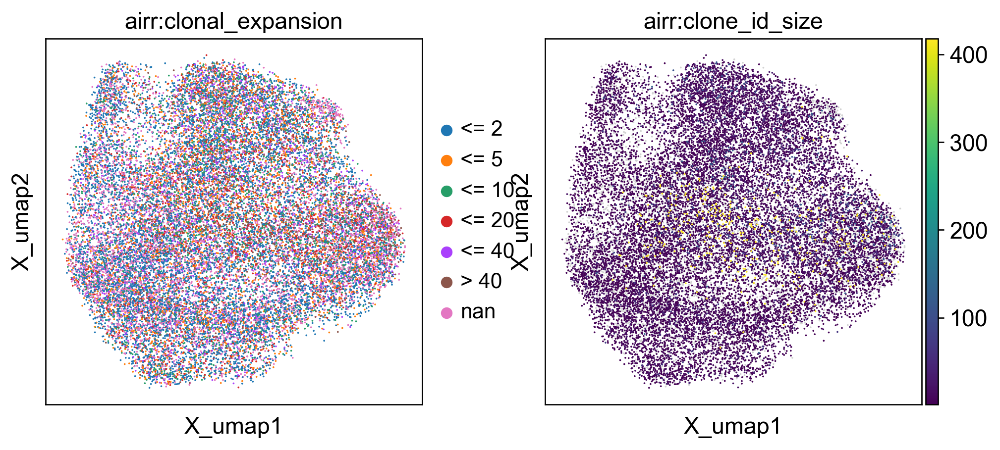

In [1564]:
ir.pp.ir_dist(mdata_CD8T, metric="identity", sequence="nt", key_added="ir_dist_nt_identity", n_jobs=8)
ir.tl.define_clonotypes(mdata_CD8T, key_added="clone_id", same_v_gene=False, dual_ir='primary_only',receptor_arms="all" )
ir.tl.clonal_expansion(mdata_CD8T, target_col="clone_id", key_added="clonal_expansion", breakpoints=[2,5,10,20,40])
mu.pl.embedding(mdata_CD8T, basis='gex:umap',color=['airr:clonal_expansion', 'airr:clone_id_size'])

In [ ]:
ir.pp.ir_dist(mdata_CD4T, metric="identity", sequence="nt", key_added="ir_dist_nt_identity", n_jobs=8)
ir.tl.define_clonotypes(mdata_CD4T, key_added="clone_id", same_v_gene=False, dual_ir='primary_only',receptor_arms="all" )
ir.tl.clonal_expansion(mdata_CD4T, target_col="clone_id", key_added="clonal_expansion", breakpoints=[2,5,10,20,40])
mu.pl.embedding(mdata_CD4T, basis='gex:umap',color=['airr:clonal_expansion', 'airr:clone_id_size'])

In [1566]:
mdata_CD8T.obs['gex:clonal_size'] = mdata_CD8T.obs['airr:clonal_expansion']
adata_CD8T.obs['clonal_size'] = mdata_CD8T.obs['airr:clonal_expansion']
annot = {
  40: ['<= 40','> 40'],
  20: ['<= 20'],
  10: ['<= 10'],
  5: ['<= 5'],
  3: ['<= 2'],
}
adata_CD8T = anno(adata_CD8T, annot, 'spot_size', 'clonal_size', 2)

In [ ]:
mdata_CD4T.obs['gex:clonal_size'] = mdata_CD4T.obs['airr:clonal_expansion']
adata_CD4T.obs['clonal_size'] = mdata_CD4T.obs['airr:clonal_expansion']
annot = {
  40: ['<= 40','> 40'],
  20: ['<= 20'],
  10: ['<= 10'],
  5: ['<= 5'],
  3: ['<= 2'],
}
adata_CD4T = anno(adata_CD4T, annot, 'spot_size', 'clonal_size', 2)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


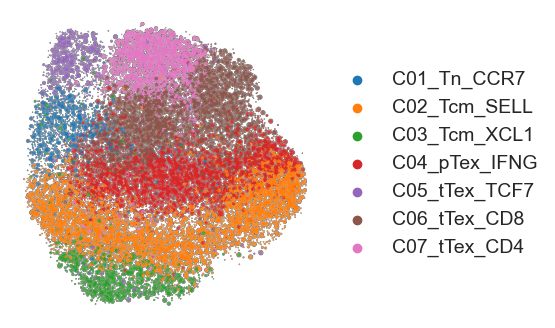

In [659]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T,color=['anno-CD8T'], 
           size=adata_CD8T.obs['spot_size'], 
           alpha=0.8, add_outline=True, 
           outline_color=('#5c5a5a','lightgrey'),
           outline_width=(0.15,0.02),
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD8T_clonal.png', dpi=400, bbox_inches='tight')

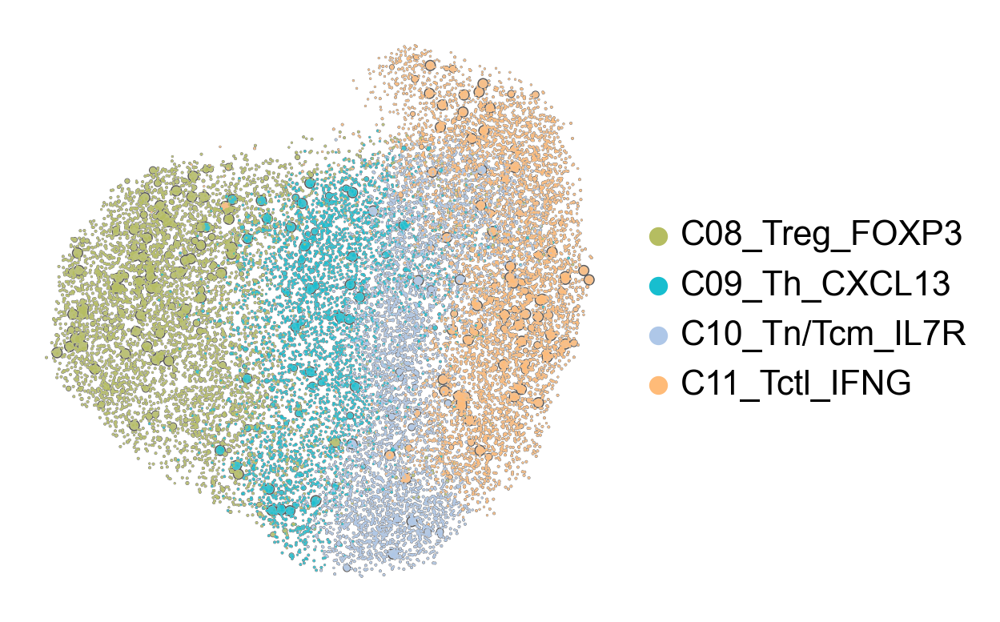

In [1582]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T,color=['anno-CD4T'], 
           palette = sc.pl.palettes.vega_20_scanpy[7:],
           size=adata_CD4T.obs['spot_size'], 
           alpha=0.8, add_outline=True, 
           outline_color=('#5c5a5a','lightgrey'),
           outline_width=(0.15,0.02),
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD4T_clonal.png', dpi=400, bbox_inches='tight')

In [507]:
adata_CD4T

AnnData object with n_obs × n_vars = 18347 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'leiden-CD4T', 'leiden-CD4T1.5', 'leiden-CD4T1.6', 'leiden-CD4T1.7', 'leiden-CD4T1.8', 'leiden-CD4T2.0', 'anno-CD4T', 'anno-focus'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-CD4T_colors', 'anno-T_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-pca', 'dendrogram_leiden-T', 'hvg', 'leiden', 'leiden-1_colors', 'leide

In [1425]:
mdata_T.obs['gex:clonal_size'] = mdata_T.obs['airr:clonal_expansion']
adata_T.obs['clonal_size'] = mdata_T.obs['airr:clonal_expansion']
annot = {
  30: ['<= 40','> 40'],
  20: ['<= 20'],
  10: ['<= 10'],
  5: ['<= 5'],
  3: ['<= 2'],
}
adata_T = anno(adata_T, annot, 'spot_size', 'clonal_size', 2)

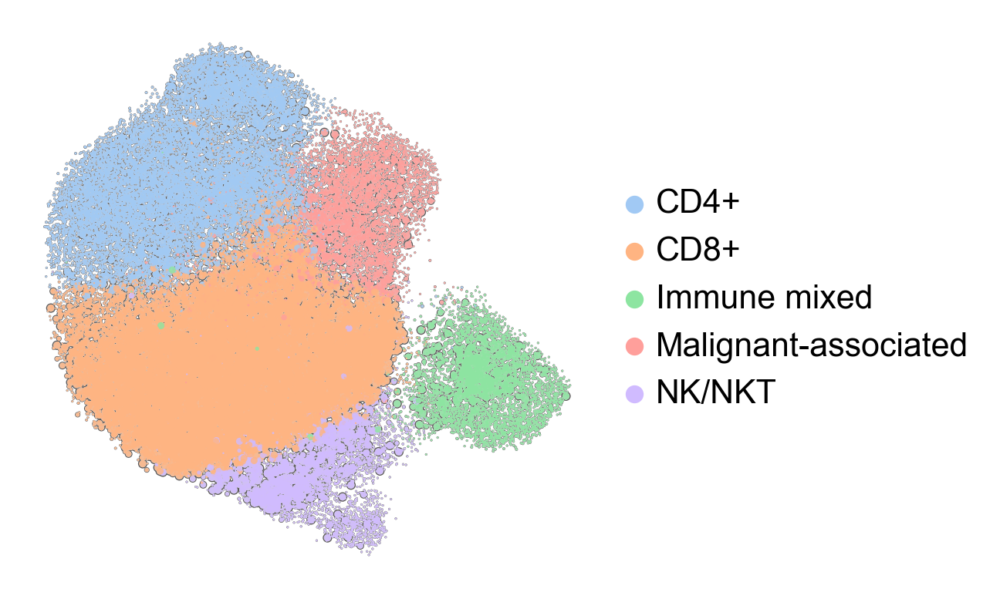

In [1426]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_T,color=['anno-T'], 
           size=adata_T.obs['spot_size'], 
           alpha=0.8, add_outline=True, 
           outline_color=('#5c5a5a','lightgrey'),
           outline_width=(0.15,0.02),
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_T_clonal.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


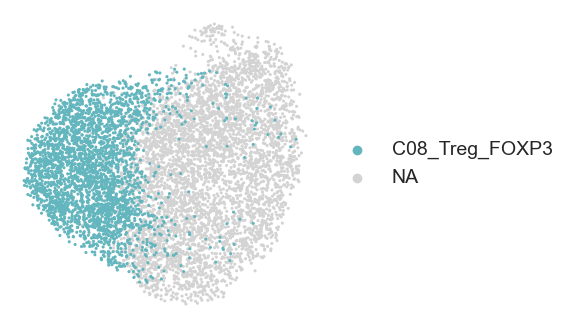

In [515]:
adata_CD4T.obs['anno-focus'] = adata_CD4T[adata_CD4T.obs['anno-CD4T'].isin([ 'C08_Treg_FOXP3'])].obs['anno-CD4T']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T[adata_CD4T.obs['treatment'].isin(['Post'])],color=['anno-focus'], 
          palette=['#64b6be', 'lightgray'],size=20,
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD4T_clonal_Post.png', dpi=400, bbox_inches='tight')

In [519]:
adata1 = adata_CD4T[adata_CD4T.obs['treatment'].isin(['Pre'])]
len(adata1[adata1.obs['anno-CD4T'].isin(['C08_Treg_FOXP3',])]), len(adata1)

(2075, 9667)

In [520]:
adata1 = adata_CD4T[adata_CD4T.obs['treatment'].isin(['Post'])]
len(adata1[adata1.obs['anno-CD4T'].isin(['C08_Treg_FOXP3',])]), len(adata1)

(2996, 7569)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


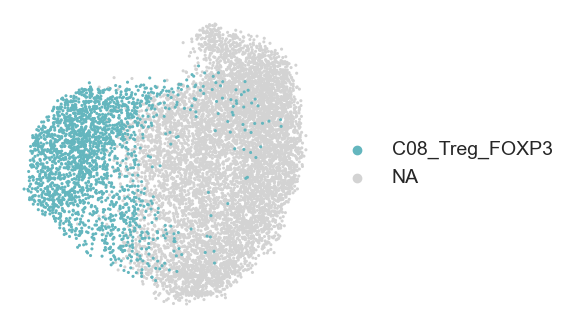

In [513]:
adata_CD4T.obs['anno-focus'] = adata_CD4T[adata_CD4T.obs['anno-CD4T'].isin([ 'C08_Treg_FOXP3'])].obs['anno-CD4T']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T[adata_CD4T.obs['treatment'].isin(['Pre'])],color=['anno-focus'], 
          palette=['#64b6be', 'lightgray'], size=20,
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD4T_clonal_Pre.png', dpi=400, bbox_inches='tight')

In [643]:
adata_CD8T.obs['anno-CD8T'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_Tex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4'],
      dtype='object')

In [611]:
adata_CD8T1 = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-3.18.h5ad")
adata_CD8T1

AnnData object with n_obs × n_vars = 26064 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'leiden-CD8T', 'leiden-CD8T-1.2', 'leiden-CD8T-1.3', 'leiden-CD8T-1.4', 'leiden-CD8T-1.6', 'leiden-CD8T-2.0', 'anno-CD8T', 'clonal_size', 'spot_size', 'proliferation', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'CytoTRACE2_Potency_colors', 'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno

In [674]:
adata_CD8T.obs['anno-CD8T'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4'],
      dtype='object')

In [644]:
annot = {
  'C01_Tn_CCR7':['10'],  # CCR7
  'C02_Tcm_SELL': ['1','2','5', '6'],  # SELL,IL7R
  'C03_Tcm_XCL1': ['9'], # XCL1, CD200+
  'C04_pTex_IFNG':['3', '8', '11', ], # IFNG
  'C05_tTex_TCF7': ['14'], # XCL1, CD200+
  'C06_tTex_CD8':['15', '12', '13','4',], # CD8
  'C07_tTex_CD4':['0'], # CD4
}
adata_CD8T = anno(adata=adata_CD8T, obsKey='anno-CD8T', obsVal='leiden-CD8T-2.0', annoDict=annot)

In [645]:
adata_CD8T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.18.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


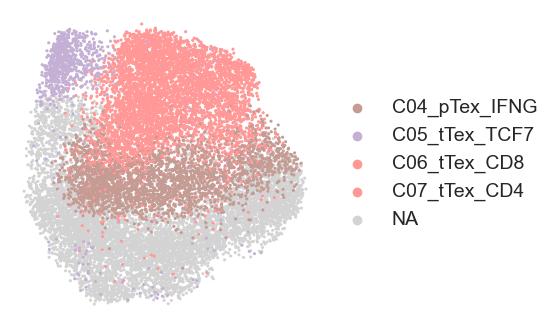

In [655]:
adata_CD8T.obs['anno-focus'] = adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG','C05_tTex_TCF7', 'C07_tTex_CD4','C06_tTex_CD8'])].obs['anno-CD8T']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T[adata_CD8T.obs['treatment'].isin(['Pre'])],color=['anno-focus'], 
          palette=['#c49c94','#c5b0d5','#ff9896','#ff9896', 'lightgray'], size=20,
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD8T_clonal_Pre.png', dpi=400, bbox_inches='tight')

In [658]:
adata1 = adata_CD8T[adata_CD8T.obs['treatment'].isin(['Pre'])]
Counter(adata1.obs['anno-focus'])

Counter({nan: 7153,
         'C06_tTex_CD8': 3221,
         'C04_pTex_IFNG': 2721,
         'C07_tTex_CD4': 1901,
         'C05_tTex_TCF7': 786})

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


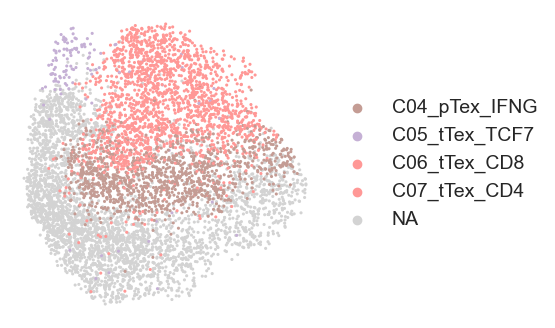

In [652]:
adata_CD8T.obs['anno-focus'] = adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG','C05_tTex_TCF7', 'C07_tTex_CD4','C06_tTex_CD8'])].obs['anno-CD8T']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD8T[adata_CD8T.obs['treatment'].isin(['Post'])],color=['anno-focus'], 
          palette=['#c49c94','#c5b0d5','#ff9896','#ff9896', 'lightgray'], size=20,
           title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_CD8T_clonal_Post.png', dpi=400, bbox_inches='tight')

In [ ]:

adata1 = adata_CD8T[adata_CD8T.obs['treatment'].isin(['Post'])]
Counter(adata1.obs['anno-focus'])

Counter({nan: 3355,
         'C04_pTex_IFNG': 1163,
         'C06_tTex_CD8': 1125,
         'C07_tTex_CD4': 679,
         'C05_tTex_TCF7': 122})

In [561]:
adata_NK = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-NK-4.5.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


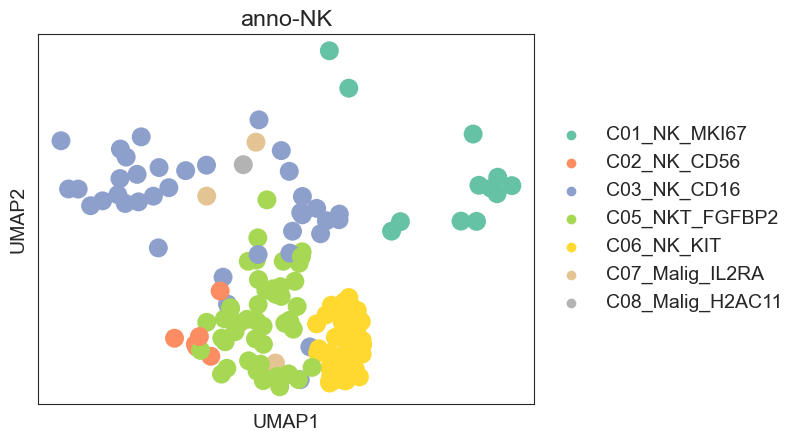

In [566]:
sc.pl.umap(adata_NK[adata_NK.obs['batch'].isin(['NK5_1'])], color=['anno-NK'])

In [568]:
mdata_NK  = mu.MuData({'gex': adata_NK, "airr":nktcl_ir})
mdata_NK

MuData object with n_obs × n_vars = 81112 × 33727
  2 modalities
    gex:	23666 x 33727
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'cnv_status', 'cnv_score', 'leiden-T', 'LMP-1', 'leiden-NK', 'leiden-NK1', 'LMP-1.1', 'anno-NK', 'leiden-NK2', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'proliferation', 'inflammatory_score', 'stress_score', 'exhaustion_score', 'cytotoxicity_score', 'EBV', 'anno-fixed'
      var:	'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'anno-NK_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-NK', 'dendrogram_anno-pca', 'dendrogram_leiden-NK1', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-NK1_colors', 'leiden-NK2_colors', 'leiden-NK_colors', 'leiden-pca_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'treatment_colors', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'Raw'
      obsp:	'connectivities', 'distances'
    airr:	60443 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'scirpy_version', 'ir_dist_nt_identity', 'clone_id'
      obsm:	'airr', 'chain_indices'

  0%|          | 0/43615 [00:00<?, ?it/s]

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


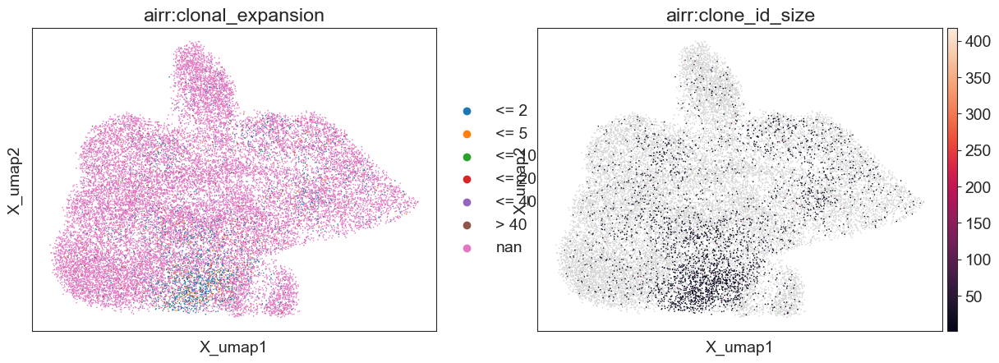

In [569]:
ir.pp.ir_dist(mdata_NK, metric="identity", sequence="nt", key_added="ir_dist_nt_identity", n_jobs=8)
ir.tl.define_clonotypes(mdata_NK, key_added="clone_id", same_v_gene=False, dual_ir='primary_only',receptor_arms="all" )
ir.tl.clonal_expansion(mdata_NK, target_col="clone_id", key_added="clonal_expansion", breakpoints=[2,5,10,20,40])
mu.pl.embedding(mdata_NK, basis='gex:umap',color=['airr:clonal_expansion', 'airr:clone_id_size'])

In [570]:
adata_NK

AnnData object with n_obs × n_vars = 23666 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'cnv_status', 'cnv_score', 'leiden-T', 'LMP-1', 'leiden-NK', 'leiden-NK1', 'LMP-1.1', 'anno-NK', 'leiden-NK2', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'proliferation', 'inflammatory_score', 'stress_score', 'exhaustion_score', 'cytotoxicity_score', 'EBV', 'anno-fixed'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'anno-NK_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-NK', 'dendrogram_anno-pca', 'dendrogram_leiden-NK1', 'hvg', 'leiden', 'leiden-1_colors'

In [571]:
mdata_NK.obs['gex:clonal_size'] = mdata_NK.obs['airr:clonal_expansion']
adata_NK.obs['clonal_size'] = mdata_NK.obs['airr:clonal_expansion']
annot = {
  40: ['<= 40','> 40'],
  20: ['<= 20'],
  10: ['<= 10'],
  5: ['<= 5'],
  3: ['<= 2'],
}
adata_NK = anno(adata_NK, annot, 'spot_size', 'clonal_size', 2)

In [ ]:
adata1 = adata_NK[adata_NK.obs['batch'].isin(['NK6_1'])]
len(adata1[adata1.obs['anno-subTfixed'].isin(['C03_Teff_IFNG'])])/ len(adata1)

0.47434435575826683

In [559]:
adata1 = adata_CD8T[adata_CD8T.obs['batch'].isin(['NK11_1'])]
len(adata1[adata1.obs['anno-subTfixed'].isin(['C03_Teff_IFNG'])])/ len(adata1)

0.627906976744186

In [95]:
def countPlot(age_df, barlabels, ax, 
            colors=sc.pl.palettes.default_20, 
            xlabel='Patient ID',  
            mode='count',  
            show_label=True, bar_label='total', show_y=True):
    all_df = age_df.sum(axis=1)
    if mode == 'count':
        age_normdf = pd.DataFrame([age_df.loc[i,:] for i in barlabels], index=barlabels)
    else:
        age_normdf = pd.DataFrame([age_df.loc[i,:] / all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    if bar_label == 'total':
        counts = [int(val) for val in all_df]
    elif bar_label == 'topRate':
        counts = (age_df.iloc[:, 0] / (age_df.iloc[:, 0] + age_df.iloc[:, 1])).fillna(0)
        counts = counts[barlabels]
        counts = [round(val, 2) for val in counts]
    elif bar_label == 'expRate':
        counts = ((age_df.iloc[:, 0] + age_df.iloc[:, 1]) / (age_df.iloc[:, 0] + age_df.iloc[:, 1] + age_df.iloc[:, 2])).fillna(0)
        counts = counts[barlabels]
        counts = [round(val, 2) for val in counts]
    else:
        counts = [int(val) for val in age_normdf.loc[:, age_normdf.columns[0]]]
    if show_label:
        ax.bar_label(rects, counts, 
                    label_type='edge', color='#7f3730', fontsize=10)
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1.2, 0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    ax.set_ylabel(xlabel)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)
    if not show_y:
        ax.set_yticks([])
    # def ks(x, pos):
    #     return '%1.1fk' % (x*1e-3)
    # ax.xaxis.set_major_formatter(FuncFormatter(ks))
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

In [87]:
def get_expand_clonotypes(mdata_CD8T, groupby='gex:anno-CD8T', ntop=5):
  batches = mdata_CD8T.obs[groupby].cat.categories
  cloneCounts = {}
  for ct in list(batches):
    _mdata = mdata_CD8T[mdata_CD8T.obs[groupby] == ct]
    expanded_clonotypes = _mdata.obs[_mdata.obs["airr:clone_id_size"] > 1]["airr:clone_id"]
    clonotype_counts = pd.Series(expanded_clonotypes.value_counts())
    cloneCounts[ct] = clonotype_counts
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
  bcr = mdata_CD8T.obs[[groupby,'airr:cells_with_TCRs']]
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
  bcr = bcr.dropna()
  bcr_df = ir.tl.summarize_clonal_expansion(mdata_CD8T, groupby=groupby, normalize=False, summarize_by='cell')
  bcr_df['clonally_expanded'] = bcr_df['<= 2'] + bcr_df['> 2']
  bcr_df['T cells with TCR'] = bcr_df['<= 1']
  bcr_df[f'Top expanded'] = [cloneCounts[x].nlargest(ntop).sum() for x in bcr_df.index]
  barlabels = mdata_CD8T.obs[groupby].cat.categories
  cell_types = list(bcr['cells_with_TCRs'].unique())
  cell_types.sort()
  age_df = pd.DataFrame(columns = list(cell_types))
  for bar in barlabels:
      d1 = pd.DataFrame([len(bcr.loc[(bcr['cells_with_TCRs'] == ct) & (bcr[groupby] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
      age_df = pd.concat([age_df, d1])
  age_df = pd.concat([age_df, bcr_df[['clonally_expanded', 'T cells with TCR', f'Top expanded']]], axis=1)
  age_df = age_df.fillna(0)
  age_df = age_df[[f'Top expanded', 'clonally_expanded', 'T cells with TCR', 'without']]
  age_df['clonally_expanded'] = age_df['clonally_expanded'] - age_df[f'Top expanded']
  return age_df, cloneCounts

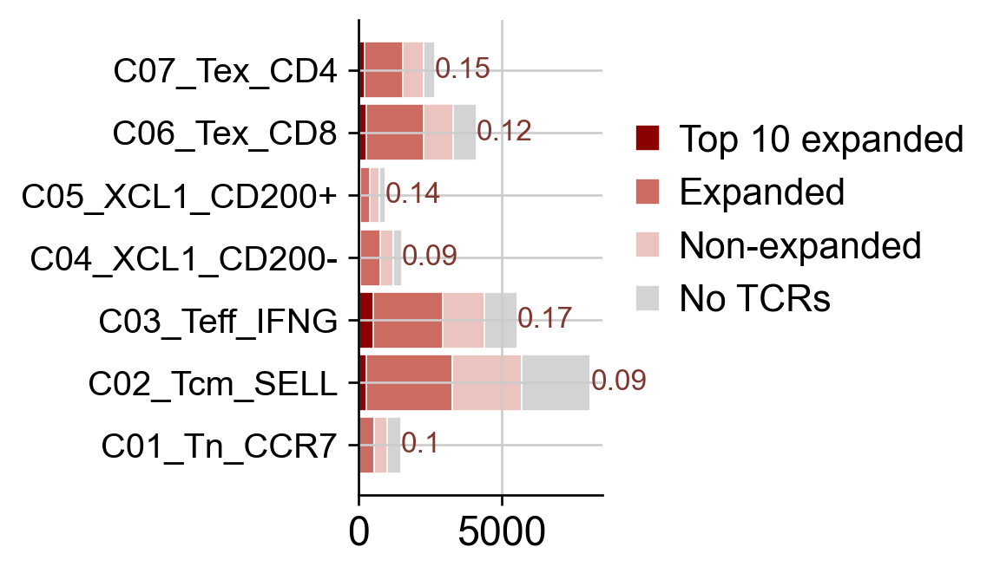

In [1577]:
age_df = get_expand_clonotypes(mdata_CD8T, groupby='gex:anno-CD8T', ntop=10)
fig0, ax0 = plt.subplots(figsize=(1.5, 3))
colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
age_df.columns = ['Top 10 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = mdata_CD8T.obs['gex:anno-CD8T'].cat.categories
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='')
fig0.savefig(f"{figPath}/EBV-CD8TCR-counts.svg",bbox_inches='tight')

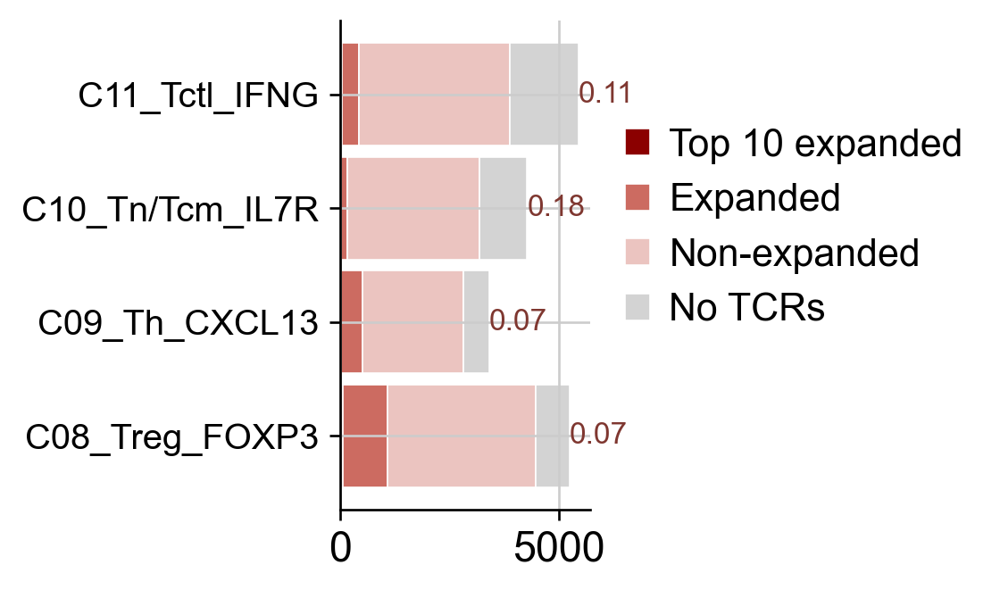

In [1578]:
age_df1 = get_expand_clonotypes(mdata_CD4T, groupby='gex:anno-CD4T', ntop=10)
fig0, ax0 = plt.subplots(figsize=(1.5, 3))
colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
age_df1.columns = ['Top 10 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = mdata_CD4T.obs['gex:anno-CD4T'].cat.categories
countPlot(age_df1, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='')
fig0.savefig(f"{figPath}/EBV-CD4TCR-counts.svg",bbox_inches='tight')

In [690]:
adata_T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-4.18.h5ad")

/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/2158934188.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)


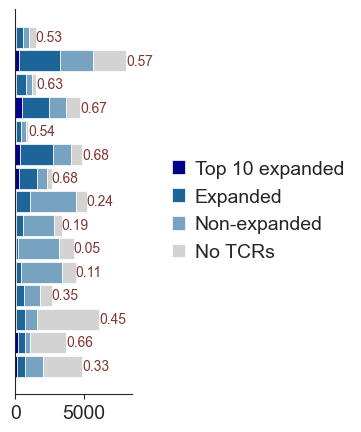

In [691]:
age_df, _ = get_expand_clonotypes(mdata_T, groupby='gex:anno-subTfixed', ntop=10)
age_df = age_df.sort_index(ascending=False)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
# colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 10 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = age_df.index
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='expRate', xlabel='', mode='count', show_y=False)
fig0.savefig(f"{figPath}/EBV-TCR-counts.svg",bbox_inches='tight')

/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/2158934188.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)


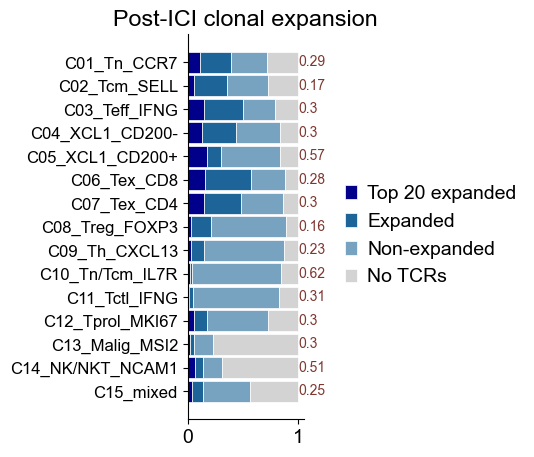

In [256]:
age_df, _ = get_expand_clonotypes(mdata_T[mdata_T.obs['gex:treatment'].isin(['Post'])], groupby='gex:anno-subTfixed', ntop=20)
age_df = age_df.sort_index(ascending=False)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
# colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 20 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = age_df.index
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='', mode='prop')
ax0.set_title("Post-ICI clonal expansion")
fig0.savefig(f"{figPath}/EBV-TCR-prop-Post.svg",bbox_inches='tight')

/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/2158934188.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)


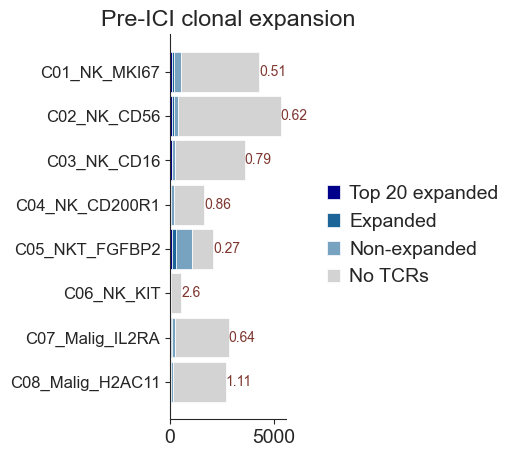

In [578]:
age_df, _ = get_expand_clonotypes(mdata_NK[mdata_NK.obs['gex:treatment'].isin(['Pre', 'PBMC'])], groupby='gex:anno-NK', ntop=20)
age_df = age_df.sort_index(ascending=False)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
# colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 20 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = age_df.index
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='', mode='count')
ax0.set_title("Pre-ICI clonal expansion")
fig0.savefig(f"{figPath}/EBV-NKTCR-prop-Pre.svg",bbox_inches='tight')

/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/2158934188.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)


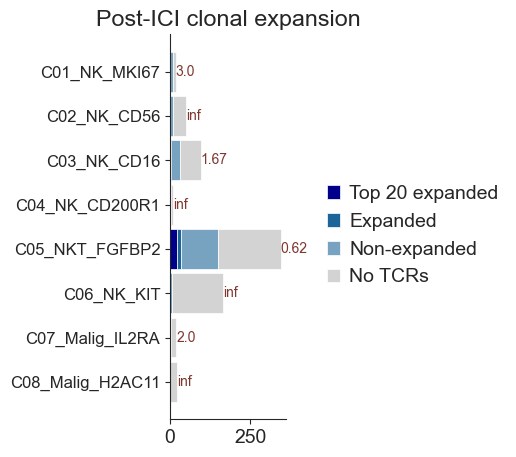

In [577]:
age_df, _ = get_expand_clonotypes(mdata_NK[mdata_NK.obs['gex:treatment'].isin(['Post'])], groupby='gex:anno-NK', ntop=5)
age_df = age_df.sort_index(ascending=False)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
# colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 20 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = age_df.index
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='', mode='count')
ax0.set_title("Post-ICI clonal expansion")
fig0.savefig(f"{figPath}/EBV-NKTCR-prop-Post.svg",bbox_inches='tight')

/tmp/ipykernel_3008400/763480478.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/763480478.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/2158934188.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=12)


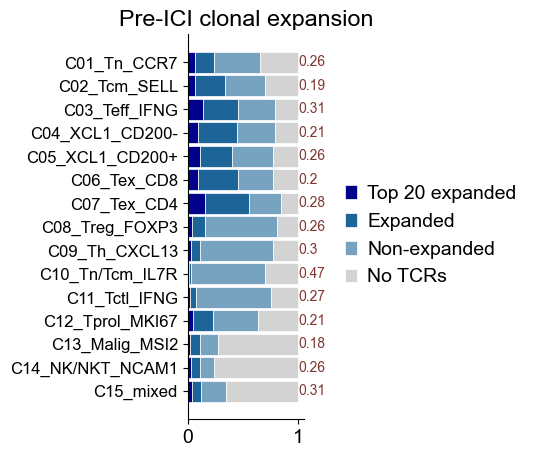

In [105]:
age_df = get_expand_clonotypes(mdata_T[mdata_T.obs['gex:treatment'].isin(['Pre', 'PBMC'])], groupby='gex:anno-subTfixed', ntop=20)
age_df = age_df.sort_index(ascending=False)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
# colors=['darkred','#cc6b61', '#ebc4c0', 'lightgrey']
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 20 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = age_df.index
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='', mode='prop')
ax0.set_title("Pre-ICI clonal expansion")
fig0.savefig(f"{figPath}/EBV-TCR-prop-Pre.svg",bbox_inches='tight')

In [330]:
mdata_CD8Tex = mdata_T
# mdata_CD8Tex = mdata_T[mdata_T.obs['gex:anno-subTfixed'].isin(['C06_Tex_CD8', 'C07_Tex_CD4', 'C03_Teff_IFNG', 'C12_Tprol_MKI67'])]
mdata_CD8Tex = mdata_CD8Tex[mdata_CD8Tex.obs['gex:batch'].isin(['NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1','NK11_1', 'RR6_0'])]

In [ ]:
def shannon_entropy(probabilities):
    entropy = -np.sum(probabilities * np.log(probabilities))
    return entropy

def clonality(probabilities):
    entropy = shannon_entropy(probabilities)
    return 1 - entropy / np.log(len(probabilities))

In [ ]:
from sklearn.metrics import auc
import seaborn as sns
mdata_CD8Tex.obs['gex:total'] = '1'
mdata_CD8Tex.obs['gex:total'] = mdata_CD8Tex.obs['gex:total'].astype('category')
_, cc_pre = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Pre'])], groupby='gex:anno-subTfixed', ntop=20)
_, cc_post = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Post'])], groupby='gex:anno-subTfixed', ntop=20)

/tmp/ipykernel_3008400/2841603490.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8Tex.obs['gex:total'] = '1'
/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:ce

/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bcr['cells_with_TCRs'] = ['with' if x == True else 'without' for x in bcr['airr:cells_with_TCRs']]
/tmp/ipykernel_3008400/3905587142.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_CD8T.obs['airr:cells_with_TCRs'] = mdata_CD8T.obs['airr:clone_id_size'] > 0
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

post:4.467840631146709, pre:3.593387667019445
post:3.917325952923904, pre:3.8513647306802916
post:1.3862943611198906, pre:1.2658567518727373
post:4.128946535765667, pre:3.7020280265059298


/tmp/ipykernel_3008400/1620304133.py:9: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_pre = cloneCounts_pre[common_clone].sort_values(ascending=False)
/tmp/ipykernel_3008400/1620304133.py:10: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)
/tmp/ipykernel_3008400/1620304133.py:9: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_pre = cloneCounts_pre[common_clone].sort_values(ascending=False)
/tmp/ipykernel_3008400/1620304133.py:10: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)
/tmp/ipykernel_3008400/1620304133.py:9: FutureWarning: Passing a s

post:4.505400558132141, pre:4.222831173036006
post:2.0794415416798357, pre:1.9085352816435597


/tmp/ipykernel_3008400/1620304133.py:9: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_pre = cloneCounts_pre[common_clone].sort_values(ascending=False)
/tmp/ipykernel_3008400/1620304133.py:10: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)


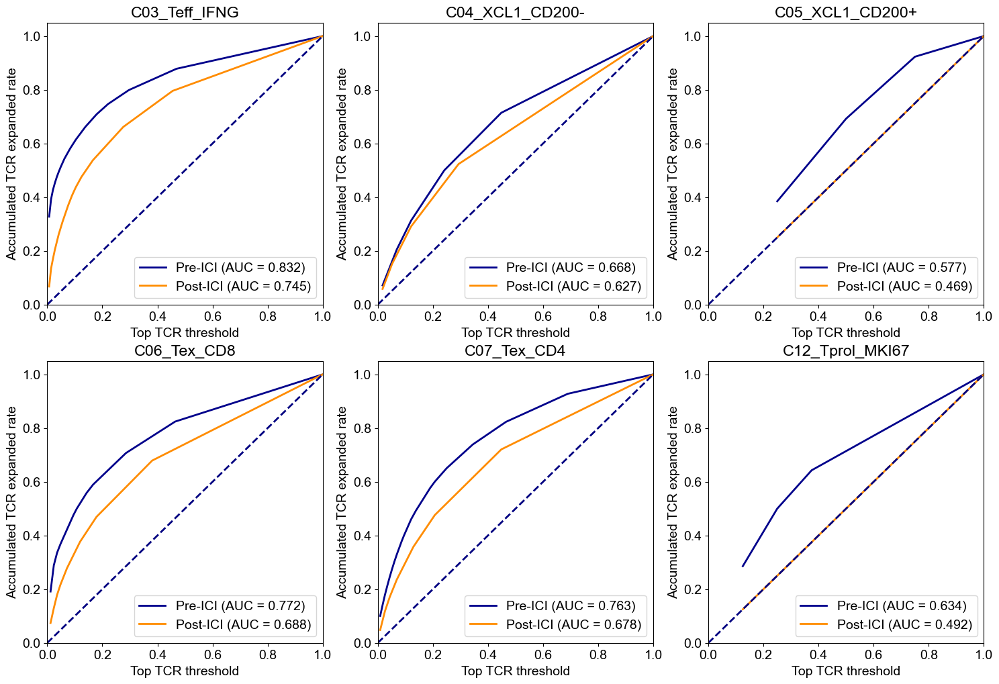

In [331]:
_, cc_pre = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Pre'])], groupby='gex:anno-subTfixed', ntop=20)
_, cc_post = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Post'])], groupby='gex:anno-subTfixed', ntop=20)
fig, ax = plt.subplots(2, 3, figsize=(18,12))
for i,p in enumerate(['C03_Teff_IFNG', 'C04_XCL1_CD200-',
       'C05_XCL1_CD200+', 'C06_Tex_CD8', 'C07_Tex_CD4', 'C12_Tprol_MKI67']): # ['5', '6', '7', '8', '11']
  cloneCounts_pre = cc_pre[p]
  cloneCounts_post = cc_post[p]
  common_clone = set(cloneCounts_post.index).intersection(cloneCounts_pre.index)
  cloneCounts_pre = cloneCounts_pre[common_clone].sort_values(ascending=False)
  cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)
  # AUC pre
  AUC_pre = pd.DataFrame(list(cloneCounts_pre.cumsum()), columns=['cumsum'])
  AUC_pre['P'] = np.array(list(cloneCounts_pre)) / sum(cloneCounts_pre)
  AUC_pre['TPR'] = AUC_pre['cumsum'] / sum(cloneCounts_pre)
  AUC_pre['FPR'] = np.array(range(1, len(AUC_pre)+1))/len(AUC_pre)
  # AUC_pre['TPR'] = AUC_pre['cumsum']
  # AUC_pre['FPR'] = np.array(range(1, len(AUC_pre)+1))
  # AUC post
  AUC_post = pd.DataFrame(list(cloneCounts_post.cumsum()), columns=['cumsum'])
  AUC_post['P'] = np.array(list(cloneCounts_post)) / sum(cloneCounts_post)
  AUC_post['TPR'] = AUC_post['cumsum'] / sum(cloneCounts_post)
  AUC_post['FPR'] = np.array(range(1, len(AUC_post)+1))/len(AUC_post)
  # AUC_post['TPR'] = AUC_post['cumsum']
  # AUC_post['FPR'] = np.array(range(1, len(AUC_post)+1))
  auc_pre = auc(AUC_pre['FPR'],AUC_pre['TPR']) if len(AUC_pre) >=2 else 0
  auc_post = auc(AUC_post['FPR'],AUC_post['TPR']) if len(AUC_post) >=2 else 0
  print(f"post:{shannon_entropy(AUC_post['P'])}, pre:{shannon_entropy(AUC_pre['P'])}")
  x, y = int(i/3), i%3
  sns.lineplot(ax=ax[x][y], data=AUC_pre, x='FPR', y='TPR', label='Pre-ICI (AUC = %0.3f)' % auc_pre, lw=2, color='darkblue')
  sns.lineplot(ax=ax[x][y], data=AUC_post, x='FPR', y='TPR', label='Post-ICI (AUC = %0.3f)' % auc_post, lw=2, color='darkorange')
  sns.lineplot(ax=ax[x][y], x=[0, 1], y=[0, 1], lw=2, linestyle='--', color='navy')
  ax[x][y].set_xlim([0.0, 1.00])
  ax[x][y].set_ylim([0.0, 1.05])
  ax[x][y].set_xlabel('Top TCR threshold')
  ax[x][y].set_ylabel('Accumulated TCR expanded rate')
  ax[x][y].set_title(f'{p}')
  ax[x][y].legend(loc="lower right")
fig.savefig(f"{figPath}/Clonal-Expansion-Anno.svg", bbox_inches='tight')

/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_3008400/3905587142.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


NK5 Clonality post:0.26668297200019353, pre:0.12255624111936403
NK6 Clonality post:0.04156313380339671, pre:0.10456548465767035
Common_clone:{'28574', '28235', '28231', '28423', '28158', '28198', '28517', '28269'}
NK7 Clonality post:0.0632469543073595, pre:0.09029544098758269
NK8 Clonality post:0.06381161666054924, pre:0.11487018515525349
NK11 Clonality post:0.3330044024635227, pre:0.666775669487036


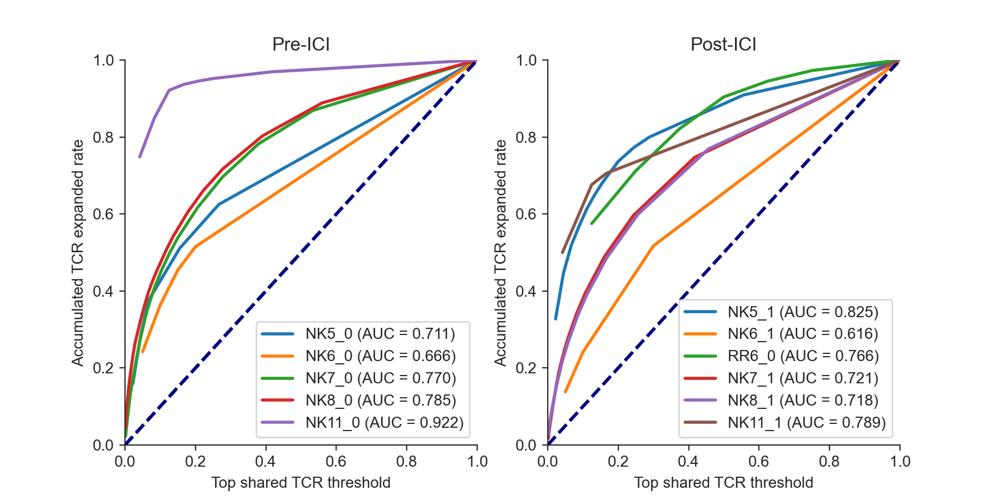

In [404]:
_, cc_pre = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Pre'])], groupby='gex:batch', ntop=20)
_, cc_post = get_expand_clonotypes(mdata_CD8Tex[mdata_CD8Tex.obs['gex:treatment'].isin(['Post', 'Recu'])], groupby='gex:batch', ntop=20)
pres_clones = []
fig, ax = plt.subplots(1, 2, figsize=(9,4.5))
for i,p in enumerate(['5', '6', '7', '8', '11']): # ['5', '6', '7', '8', '11']
  cloneCounts_pre = cc_pre[f'NK{p}_0']#[cc_pre[f'NK{p}_0'] >= 1]
  cloneCounts_post = cc_post[f'NK{p}_1']#[cc_post[f'NK{p}_1'] >= 1]
  total_pre = sum(cc_pre[f'NK{p}_0'])
  total_post = sum(cc_post[f'NK{p}_1'])
  common_clone = set(cloneCounts_post.index).intersection(cloneCounts_pre.index)
  cloneCounts_pre = cloneCounts_pre[common_clone].sort_values(ascending=False)
  cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)
  # AUC pre
  AUC_pre = pd.DataFrame(list(cloneCounts_pre.cumsum()), columns=['cumsum'])
  AUC_pre['P'] = np.array(list(cloneCounts_pre)) / sum(cloneCounts_pre)
  AUC_pre['TPR'] = AUC_pre['cumsum'] / sum(cloneCounts_pre)
  AUC_pre['FPR'] = np.array(range(1, len(AUC_pre)+1))/len(AUC_pre)
  # AUC_pre['pos_pre'] = list(zip([0]*len(AUC_pre), AUC_pre['cumsum'] / total_pre))
  # AUC_pre['TPR'] = AUC_pre['cumsum']
  # AUC_pre['FPR'] = np.array(range(1, len(AUC_pre)+1))
  # AUC post
  AUC_post = pd.DataFrame(list(cloneCounts_post.cumsum()), columns=['cumsum'])
  AUC_post['P'] = np.array(list(cloneCounts_post)) / sum(cloneCounts_post)
  AUC_post['TPR'] = AUC_post['cumsum'] / sum(cloneCounts_post)
  AUC_post['FPR'] = np.array(range(1, len(AUC_post)+1))/len(AUC_post)
  # AUC_post['pos_post'] = list(zip([1]*len(AUC_post), AUC_post['cumsum'] / total_post))
  # AUC_post['TPR'] = AUC_post['cumsum']
  # AUC_post['FPR'] = np.array(range(1, len(AUC_post)+1))
  auc_pre = auc(AUC_pre['FPR'],AUC_pre['TPR']) if len(AUC_pre) >=2 else 0
  auc_post = auc(AUC_post['FPR'],AUC_post['TPR']) if len(AUC_post) >=2 else 0
  print(f"NK{p} Clonality post:{clonality(AUC_post['P'])}, pre:{clonality(AUC_pre['P'])}")
  x, y = int(i/2), i%2
  sns.lineplot(ax=ax[0], data=AUC_pre, x='FPR', y='TPR', label=f'NK{p}_0 (AUC = %0.3f)' % auc_pre, lw=2)
  sns.lineplot(ax=ax[1], data=AUC_post, x='FPR', y='TPR', label=f'NK{p}_1 (AUC = %0.3f)' % auc_post, lw=2)
  
  if p == '6':
    cloneCounts_post = cc_post[f'RR{p}_0']#[cc_pre[f'NK{p}_0'] >= 1]
    total_post = sum(cc_post[f'RR{p}_0'])
    common_clone = set(cloneCounts_post.index).intersection(common_clone)
    print(f"Common_clone:{common_clone}")
    cloneCounts_post = cloneCounts_post[common_clone].sort_values(ascending=False)
    AUC_post = pd.DataFrame(list(cloneCounts_post.cumsum()), columns=['cumsum'])
    AUC_post['P'] = np.array(list(cloneCounts_post)) / sum(cloneCounts_post)
    AUC_post['TPR'] = AUC_post['cumsum'] / sum(cloneCounts_post)
    AUC_post['FPR'] = np.array(range(1, len(AUC_post)+1))/len(AUC_post)
    auc_post = auc(AUC_post['FPR'],AUC_post['TPR']) if len(AUC_post) >=2 else 0
    sns.lineplot(ax=ax[1], data=AUC_post, x='FPR', y='TPR', label=f'RR{p}_0 (AUC = %0.3f)' % auc_post, lw=2)
  else:
    pres_clones.extend(common_clone)
  # df = pd.concat([cloneCounts_pre, cloneCounts_post], axis=1)
  # df.columns = ['pre', 'post']
  # df['pre'] = df['pre'] / total_pre
  # df['post'] = df['post'] / total_post
  # for i in range(len(df)):
  #   sns.lineplot(ax=ax[x][y], x=[0, 1], y=[df['pre'][i], df['post'][i]], lw=0.5)

  ax[y].set_xlabel('Top shared TCR threshold')
  ax[y].set_ylabel('Accumulated TCR expanded rate')
  ax[y].legend(loc="lower right")
  ax[y].set_xlim([0.0, 1.0])
  ax[y].set_ylim([0.0, 1.0])
  sns.lineplot(ax=ax[y], x=[0, 1], y=[0, 1], lw=2, linestyle='--', color='navy')
ax[0].set_title('Pre-ICI')
ax[1].set_title('Post-ICI')
ax[0].spines['top'].set_visible(False)
ax[1].spines['top'].set_visible(False)
ax[0].spines['right'].set_visible(False)
ax[1].spines['right'].set_visible(False)
fig.savefig(f"{figPath}/Patient-Clonal-Expansion.svg", bbox_inches='tight')

In [ ]:
def Gexplot_adata(adata, gene, ax, group='treatment'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  sc.pl.violin(adata, keys=[gene], groupby=group, width=.6, ax=ax, show=False)
  groups = data.groupby(group).agg(list)
  group_names = list(data[group].unique())
  f_statistic, pval = stats.f_oneway(groups.loc[group_names[0], gene], 
                                        groups.loc[group_names[1], gene])
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  # 根据 p 值判断是否拒绝原假设
  alpha = 0.05
  if pval < alpha:
      print("拒绝原假设，至少有一组均值与其他组有显著差异。")
      # 进行 Tukey's HSD 配对检验
      tukey = pairwise_tukeyhsd(endog=data[gene], groups=data[group], alpha=alpha)
      print("\nTukey's HSD 配对检验结果:")
      print(tukey)
  else:
      print("不能拒绝原假设，各组均值没有显著差异。")
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.3))
  sns.lineplot(x=[0, 1], y=max(data[gene])+0.3, color='black', linewidth=1.2, ax=ax)
  ax.text(0.5, max(data[gene])+0.3, f"ANOVA F={f_statistic:.3f},p={pval:.2e}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

1074

In [493]:
mdata_pres_noRR = mdata_T[mdata_T.obs['airr:clone_id'].isin(pres_clones)]
responders = ['CXCL13', 'LYST', 'DUSP4', 'GZMK', 'RBPJ', 'HLA-DQA1',]
non_responders = ['FOS', 'GZMH',  'ANXA1', 'CTSC', 'XCL2', 'ZNF683']
sc.tl.score_genes(mdata_pres_noRR['gex'], gene_list=responders, score_name='responders')
sc.tl.score_genes(mdata_pres_noRR['gex'], gene_list=non_responders, score_name='non_responders')

拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  Post    Pre  -0.0106 0.0002 -0.0162 -0.0051   True
----------------------------------------------------
不能拒绝原假设，各组均值没有显著差异。


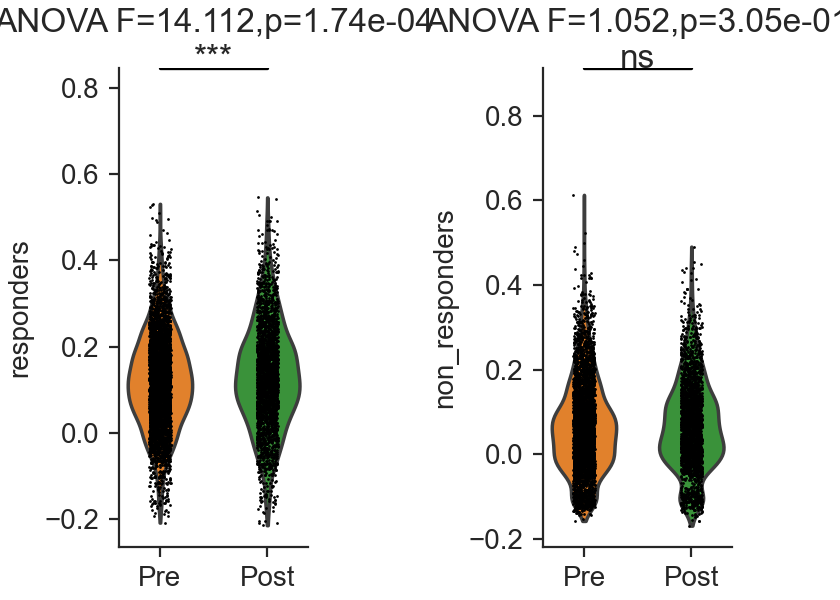

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(4.2,3), constrained_layout=True)
mdata1 = mdata_pres_noRR['gex'][mdata_pres_noRR['gex'].obs['batch'].isin(['NK5_0', 'NK5_1', 'NK7_0', 'NK7_1','NK8_0', 'NK8_1', 'NK11_0', 'NK11_1'])]
mdata1.obs['treatment'] = pd.Categorical(mdata1.obs['treatment'], categories=['Pre', 'Post'],ordered=True)
ax[0] = Gexplot_adata(mdata1, 'responders', ax=ax[0], group='treatment')
ax[1] = Gexplot_adata(mdata1, 'non_responders', ax=ax[1], group='treatment')
ax[0].set_xlabel('')
ax[1].set_xlabel('')
fig.savefig(f"{figPath}/NKall_responders1.svg", bbox_inches='tight')

In [ ]:
mdata_pres = mdata_T[mdata_T.obs['airr:clone_id'].isin(['28574', '28235', '28231', '28423', '28158', '28198', '28517', '28269'])]
mdata_pres.obs['gex:batch']

ATCATGGAGTGGTAAT-1-NK6_0    NK6_0
CACAGGCGTATAAACG-1-NK6_0    NK6_0
CATCGAATCAGCCTAA-1-NK6_0    NK6_0
CATGGCGTCATGCTCC-1-NK6_0    NK6_0
CCAATCCGTAGATTAG-1-NK6_0    NK6_0
                            ...  
GTGCTTCTCAGGTTCA-1-RR6_0      NaN
TAAGTGCTCAGCAACT-1-RR6_0      NaN
TGTGGTAAGTGTACTC-1-RR6_0      NaN
TTTGTCAAGTAGTGCG-1-RR6_0      NaN
TTTGTCACACCGAATT-1-RR6_0      NaN
Name: gex:batch, Length: 115, dtype: category
Categories (18, object): ['NK10_0', 'NK11_0', 'NK11_1', 'NK1_0', ..., 'NK8_1', 'NK9_0', 'PB9_0', 'RR6_0']

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = s

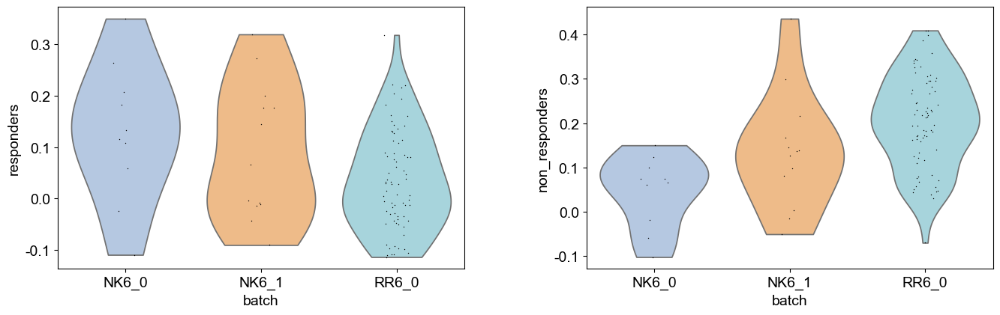

In [ ]:
responders = ['CXCL13', 'LYST', 'DUSP4', 'GZMK', 'RBPJ', 'HLA-DQA1', 'ZNF683',]
non_responders = ['FOS', 'GZMH',  'ANXA1', 'CTSC', 'XCL2']
sc.tl.score_genes(mdata_pres['gex'], gene_list=responders, score_name='responders')
sc.tl.score_genes(mdata_pres['gex'], gene_list=non_responders, score_name='non_responders')
sc.pl.violin(mdata_pres['gex'], keys=['responders', 'non_responders'], groupby='batch')

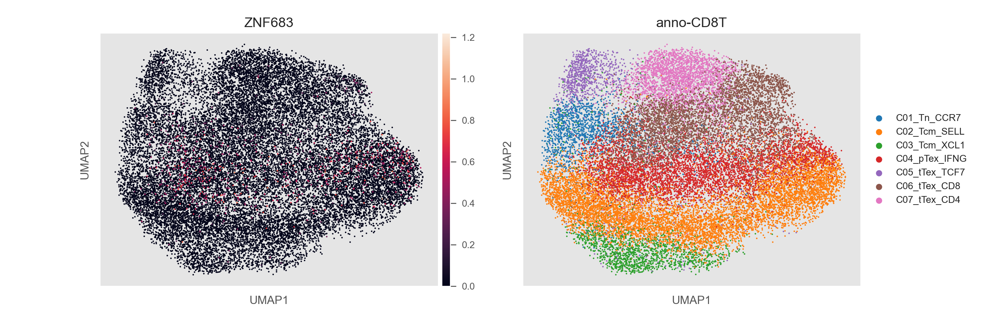

In [ ]:
sc.pl.umap(adata_CD8T, color=['ZNF683', 'anno-CD8T'], size=10)

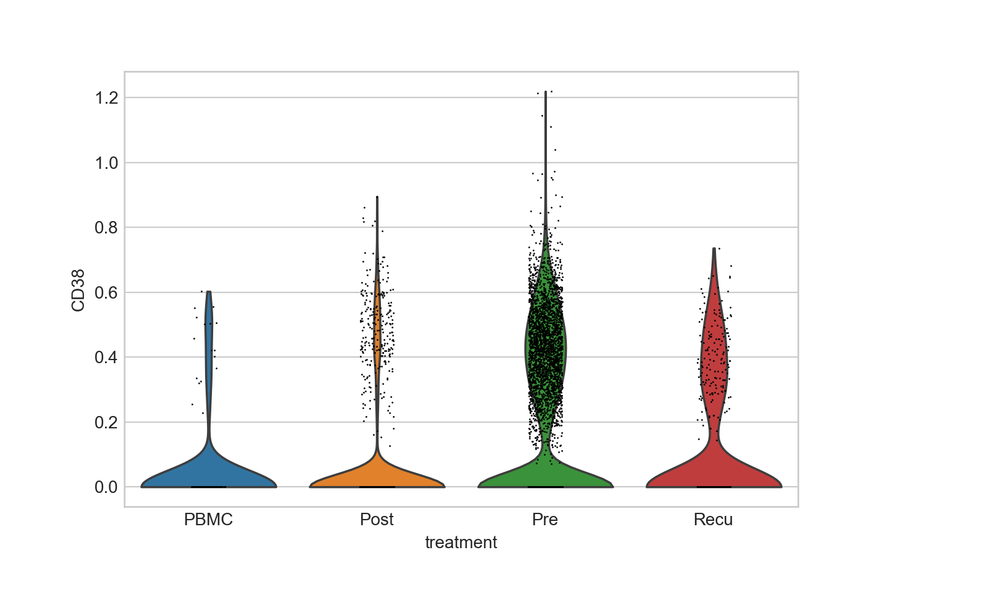

In [1842]:
sc.pl.violin(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin([ 'C06_tTex_CD8', 'C07_tTex_CD4'])], keys=['CD38'], groupby='treatment')

In [ ]:
sc.pl.violin(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG', 'C06_tTex_CD8', 'C07_tTex_CD4'])], keys=['GZMB'], groupby='treatment')

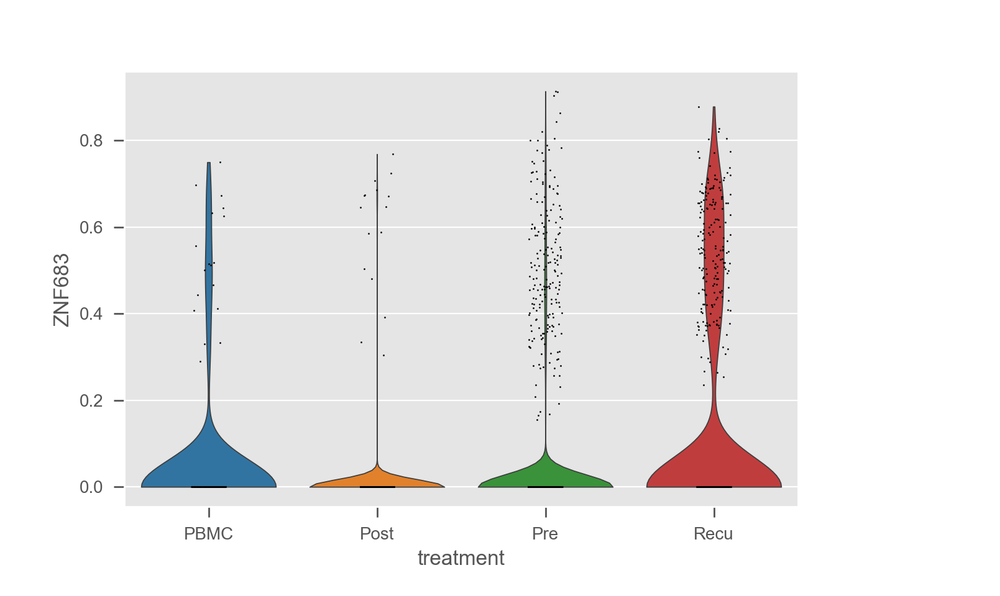

In [ ]:
sc.pl.violin(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG'])], keys=['ZNF683'], groupby='treatment')

/tmp/ipykernel_3008400/976814136.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  PBMC   Post  -0.0504 0.0004  -0.083 -0.0178   True
  PBMC    Pre  -0.0221 0.2725 -0.0535  0.0094  False
  PBMC   Recu   0.0897    0.0  0.0558  0.1235   True
  Post    Pre   0.0284    0.0  0.0149  0.0419   True
  Post   Recu   0.1401    0.0  0.1218  0.1585   True
   Pre   Recu   0.1117    0.0  0.0955   0.128   True
----------------------------------------------------


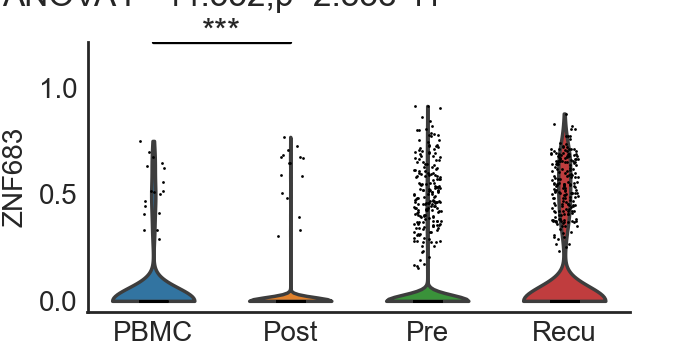

In [1849]:
fig, ax = plt.subplots(1,1, figsize=(3.5,1.75))
ax = Gexplot_adata(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG'])], 'ZNF683', ax=ax, group='treatment')
ax.set_xlabel('')
fig.savefig(f"{figPath}/4b-ZNF683.svg", bbox_inches='tight')

/tmp/ipykernel_3008400/976814136.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj  lower  upper  reject
--------------------------------------------------
  PBMC   Post    0.097 0.0001  0.038 0.1559   True
  PBMC    Pre   0.2573    0.0 0.1998 0.3147   True
  PBMC   Recu   0.3301    0.0 0.2659 0.3942   True
  Post    Pre   0.1603    0.0 0.1419 0.1787   True
  Post   Recu   0.2331    0.0 0.1991 0.2671   True
   Pre   Recu   0.0728    0.0 0.0414 0.1041   True
--------------------------------------------------


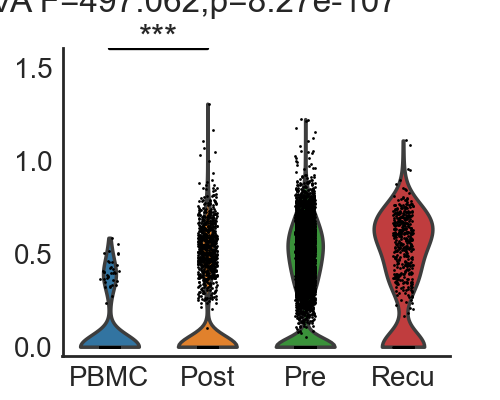

In [1865]:
fig, ax = plt.subplots(1,1, figsize=(2.5, 2))
ax = Gexplot_adata(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4'])], 'LAG3', ax=ax, group='treatment')
ax.set_xlabel('')
fig.savefig(f"{figPath}/4b-LAG3.svg", bbox_inches='tight')

In [ ]:
from scipy import stats
from statsmodels.stats.multicomp import pairwise_tukeyhsd
df = mdata_pres['gex'].obs[['non_responders','batch']]
groups = df.groupby('batch').agg(list)

# 进行单因素方差分析
f_statistic, p_value = stats.f_oneway(groups.loc['NK6_0', 'non_responders'], 
                                      groups.loc['NK6_1', 'non_responders'], 
                                      groups.loc['RR6_0', 'non_responders'])

# 输出结果
print("Non responders ANOVA 结果:\n")
print(f"F 统计量: {f_statistic}")
print(f"P 值: {p_value}")

# 根据 p 值判断是否拒绝原假设
alpha = 0.05
if p_value < alpha:
    print("拒绝原假设，至少有一组均值与其他组有显著差异。")
    # 进行 Tukey's HSD 配对检验
    tukey = pairwise_tukeyhsd(endog=df['non_responders'], groups=df['batch'], alpha=alpha)
    print("\nTukey's HSD 配对检验结果:")
    print(tukey)
else:
    print("不能拒绝原假设，各组均值没有显著差异。")

ANOVA 结果:

F 统计量: 10.874307662025455
P 值: 5.704275804450664e-05
拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
 NK6_0  NK6_1   0.0902 0.1182 -0.0173 0.1977  False
 NK6_0  RR6_0   0.1591 0.0001  0.0729 0.2453   True
 NK6_1  RR6_0   0.0689 0.0888  -0.008 0.1459  False
---------------------------------------------------


In [ ]:
from scipy import stats
from statsmodels.stats.multicomp import pairwise_tukeyhsd
df = mdata_pres['gex'].obs[['responders','batch']]
groups = df.groupby('batch').agg(list)

# 进行单因素方差分析
f_statistic, p_value = stats.f_oneway(groups.loc['NK6_0', 'responders'], 
                                      groups.loc['NK6_1', 'responders'], 
                                      groups.loc['RR6_0', 'responders'])

# 输出结果
print("Responders ANOVA 结果:\n")
print(f"F 统计量: {f_statistic}")
print(f"P 值: {p_value}")

# 根据 p 值判断是否拒绝原假设
alpha = 0.05
if p_value < alpha:
    print("拒绝原假设，至少有一组均值与其他组有显著差异。")
    # 进行 Tukey's HSD 配对检验
    tukey = pairwise_tukeyhsd(endog=df['responders'], groups=df['batch'], alpha=alpha)
    print("\nTukey's HSD 配对检验结果:")
    print(tukey)
else:
    print("不能拒绝原假设，各组均值没有显著差异。")

Responders ANOVA 结果:

F 统计量: 4.231218241215181
P 值: 0.01742855004054817
拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
 NK6_0  NK6_1   -0.037 0.6866 -0.1434  0.0694  False
 NK6_0  RR6_0  -0.0918  0.032 -0.1771 -0.0064   True
 NK6_1  RR6_0  -0.0548 0.2061 -0.1309  0.0214  False
----------------------------------------------------


In [482]:
def Gexplot_adata(adata, gene, ax, group='batch'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  sc.pl.violin(adata, keys=[gene], groupby=group, width=.6, ax=ax, show=False)
  groups = data.groupby(group).agg(list)
  f_statistic, pval = stats.f_oneway(groups.loc['NK6_0', gene], 
                                        groups.loc['NK6_1', gene], 
                                        groups.loc['RR6_0', gene])
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  # 根据 p 值判断是否拒绝原假设
  alpha = 0.05
  if pval < alpha:
      print("拒绝原假设，至少有一组均值与其他组有显著差异。")
      # 进行 Tukey's HSD 配对检验
      tukey = pairwise_tukeyhsd(endog=data[gene], groups=data[group], alpha=alpha)
      print("\nTukey's HSD 配对检验结果:")
      print(tukey)
  else:
      print("不能拒绝原假设，各组均值没有显著差异。")
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.3))
  ax.set_xticklabels(['NK6_0', 'NK6_1', 'RR6_0'])
  sns.lineplot(x=[0, 2], y=max(data[gene])+0.3, color='black', linewidth=1.2, ax=ax)
  ax.text(1, max(data[gene])+0.3, f"ANOVA F={f_statistic:.3f},p={pval:.2e}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
 NK6_0  NK6_1   -0.037 0.6866 -0.1434  0.0694  False
 NK6_0  RR6_0  -0.0918  0.032 -0.1771 -0.0064   True
 NK6_1  RR6_0  -0.0548 0.2061 -0.1309  0.0214  False
----------------------------------------------------
拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
 NK6_0  NK6_1   0.0902 0.1182 -0.0173 0.1977  False
 NK6_0  RR6_0   0.1591 0.0001  0.0729 0.2453   True
 NK6_1  RR6_0   0.0689 0.0888  -0.008 0.1459  False
---------------------------------------------------


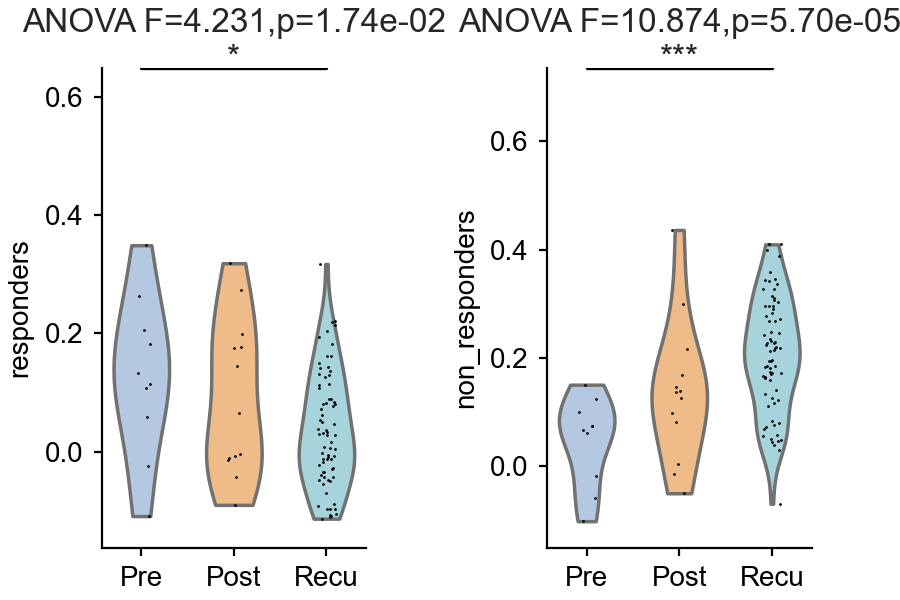

In [484]:
plt.style.use('default')
fig, ax = plt.subplots(1,2, figsize=(4.5,3), constrained_layout=True)
ax[0] = Gexplot_adata(mdata_pres['gex'], 'responders', ax=ax[0], group='batch')
ax[1] = Gexplot_adata(mdata_pres['gex'], 'non_responders', ax=ax[1], group='batch')
ax[0].set_xlabel('')
ax[1].set_xlabel('')
ax[0].set_xticklabels(['Pre', 'Post', 'Recu'])
ax[1].set_xticklabels(['Pre', 'Post', 'Recu'])
ax[0].tick_params(axis='both', which='both', length=3)
ax[1].tick_params(axis='both', which='both', length=3)
fig.savefig(f"{figPath}/NK6_responders.svg", bbox_inches='tight')

In [ ]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

In [ ]:
df1 = []
df2 = []
df3 = []
pids = ['NK5', 'NK6', 'NK7', 'NK8', 'NK11']
for pid in pids:
  pre_NK = adata_NK[adata_NK.obs['batch'] == f'{pid}_0']
  post_NK = adata_NK[adata_NK.obs['batch'] == f'{pid}_1']
  pre_T = adata_T[adata_T.obs['batch'] == f'{pid}_0']
  post_T = adata_T[adata_T.obs['batch'] == f'{pid}_1']
  pre_mNK1, post_mNK1 = len(pre_NK[pre_NK.obs['anno-NK'] == 'C07_Malig_IL2RA']), len(post_NK[post_NK.obs['anno-NK'] == 'C07_Malig_IL2RA'])
  pre_mNK2, post_mNK2 = len(pre_NK[pre_NK.obs['anno-NK'] == 'C08_Malig_H2AC11']), len(post_NK[post_NK.obs['anno-NK'] == 'C07_Malig_H2AC11'])
  pre_mT1, post_mT1 = len(pre_T[pre_T.obs['anno-subTfixed'] == 'C12_Tprol_MKI67']), len(post_T[post_T.obs['anno-subTfixed'] == 'C12_Tprol_MKI67'])
  pre_mT2, post_mT2 = len(pre_T[pre_T.obs['anno-subTfixed'] == 'C13_Malig_MSI2']), len(post_T[post_T.obs['anno-subTfixed'] == 'C13_Malig_MSI2'])
  df1.append([(pre_mNK1+pre_mNK2+pre_mT1+pre_mT2) / (len(pre_T) + len(pre_NK)),(post_mNK1+post_mNK2+post_mT1+post_mT2) / (len(post_T) + len(post_NK))])
  df2.append([pre_mNK1, pre_mNK2, pre_mT1, pre_mT2])
  df3.append([post_mNK1, post_mNK2, post_mT1, post_mT2])
df1 = pd.DataFrame(df1, columns=['Pre', 'Post'], index=pids)
df1['Sample'] = df1.index
df2 = pd.DataFrame(df2, columns=['MaligNK IL2RA', 'MaligNK H2AC11', 'MaligT MKI67', 'MaligT MSI2'], index=pids)
df3 = pd.DataFrame(df3, columns=['MaligNK IL2RA', 'MaligNK H2AC11', 'MaligT MKI67', 'MaligT MSI2'], index=pids)

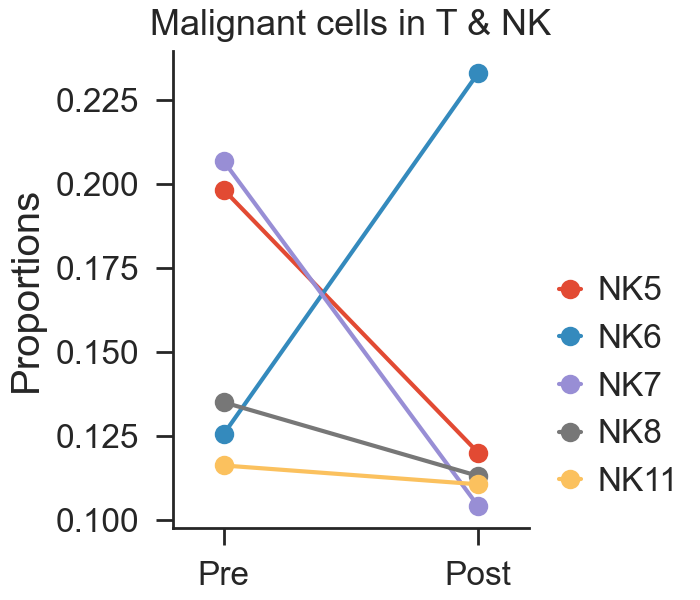

In [ ]:
plt.rcParams["font.size"] = 12
fig, ax = plt.subplots(1,1,figsize=(3.5,3), constrained_layout=True)
data = pd.melt(df1,id_vars='Sample', var_name='Group', value_name='Value')
for sample in df1['Sample']:
  sample_data = data[data['Sample'] == sample]
  ax.plot(sample_data['Group'], sample_data['Value'], marker='o', label=sample, linestyle='-')
ax.set_xlim(-0.2,1.2)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Proportions')
ax.legend( bbox_to_anchor=(1, 0), 
          handletextpad=0.5, frameon=False,
                      borderpad=0.4,
                      columnspacing=1,
                      handlelength=0.65,
          loc='lower left')
ax.set_title("Malignant cells in T & NK", fontsize=13)
fig.savefig(f"{figPath}/Figure5a.svg", bbox_inches='tight')

In [ ]:
plt.rcParams["font.size"] = 14

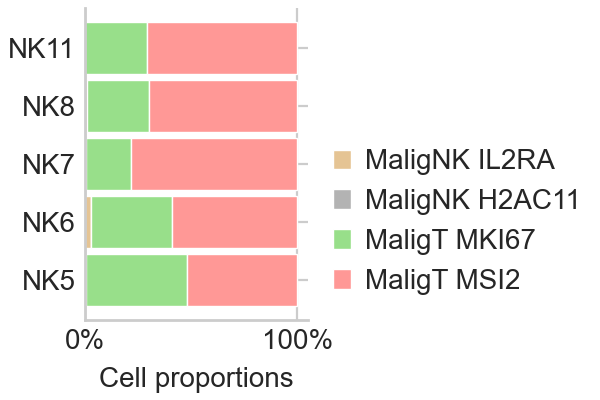

In [ ]:
barlabels = list(df2.index)
fig, ax = plt.subplots(1,1,figsize=(3,2), constrained_layout=True)
propPlot(df3, barlabels, ax, colors=['#e5c494', '#b3b3b3', '#98df8a', '#ff9896'], xlabel='', show_y=True)
fig.savefig(f"{figPath}/Figure5a2.svg", bbox_inches='tight')

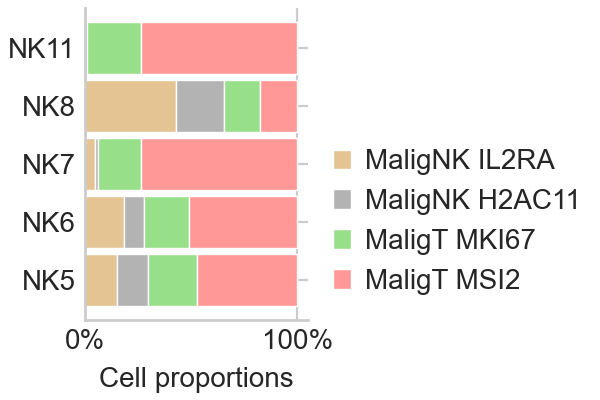

In [ ]:
barlabels = list(df2.index)
fig, ax = plt.subplots(1,1,figsize=(3,2), constrained_layout=True)
propPlot(df2, barlabels, ax, colors=['#e5c494', '#b3b3b3', '#98df8a', '#ff9896'], xlabel='', show_y=True)
fig.savefig(f"{figPath}/Figure5a1.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


拒绝原假设，至少有一组均值与其他组有显著差异。

Tukey's HSD 配对检验结果:
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
 NK6_0  NK6_1   -0.037 0.6866 -0.1434  0.0694  False
 NK6_0  RR6_0  -0.0918  0.032 -0.1771 -0.0064   True
 NK6_1  RR6_0  -0.0548 0.2061 -0.1309  0.0214  False
----------------------------------------------------


/tmp/ipykernel_3008400/996864555.py:34: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['NK6_0', 'NK6_1', 'RR6_0'])


Text(0.5, 0, '')

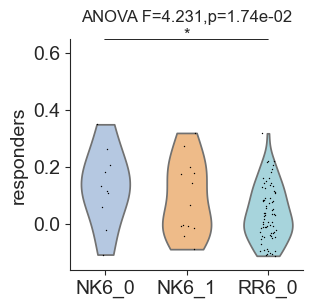

In [403]:
fig, ax = plt.subplots(1,1, figsize=(3,3))
ax = Gexplot_adata(mdata_pres['gex'], 'responders', ax=ax, group='batch')
ax.set_xlabel('')

<AxesSubplot: title={'center': 'Alpha diversity of clone_id by gex:batch'}, ylabel='Normalized Shannon Entropy'>

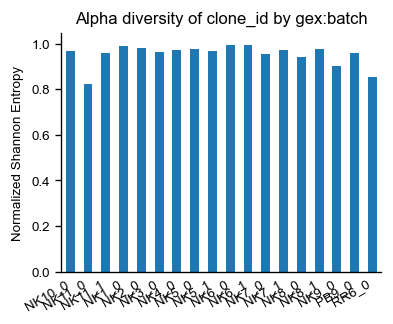

In [226]:
ir.pl.alpha_diversity(mdata_T, groupby='gex:batch')

In [247]:
cloneCounts_post.sort_values(ascending=False)

24203    72
24139    26
24671    25
24572    19
24684    18
         ..
7921      1
6357      1
26337     1
7700      1
1984      1
Name: airr:clone_id, Length: 604, dtype: int64

In [ ]:
cloneCounts_post

24565    15
24792     7
24974     7
25066     5
24525     5
         ..
25430     2
25437     2
24543     2
25472     2
39865     2
Name: airr:clone_id, Length: 202, dtype: int64

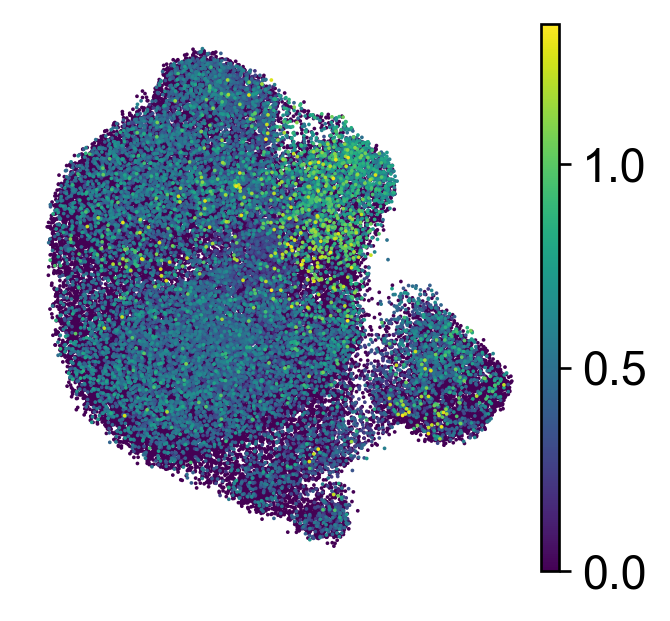

In [1613]:
sc.tl.score_genes(adata_T, gene_list=['MKI67', 'STMN1', 'TOP2A'], score_name='proliferation')
import seaborn as sns
for gene in ['MSI2']: # 'CytoTRACE2_Relative', 'proliferation', 'cnv_status'
  fig, ax = plt.subplots(1, 1, figsize=(3, 3))
  palette = sns.color_palette("pastel", 5)
  sc.pl.umap(adata_T, color=[gene],palette=['darkred', 'lightgray'], size=5,title='', ax=ax, show=False)
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_ylabel("")
  fig.savefig(f'{figPath}/EBV-T-{gene}.png', dpi=400, bbox_inches='tight')

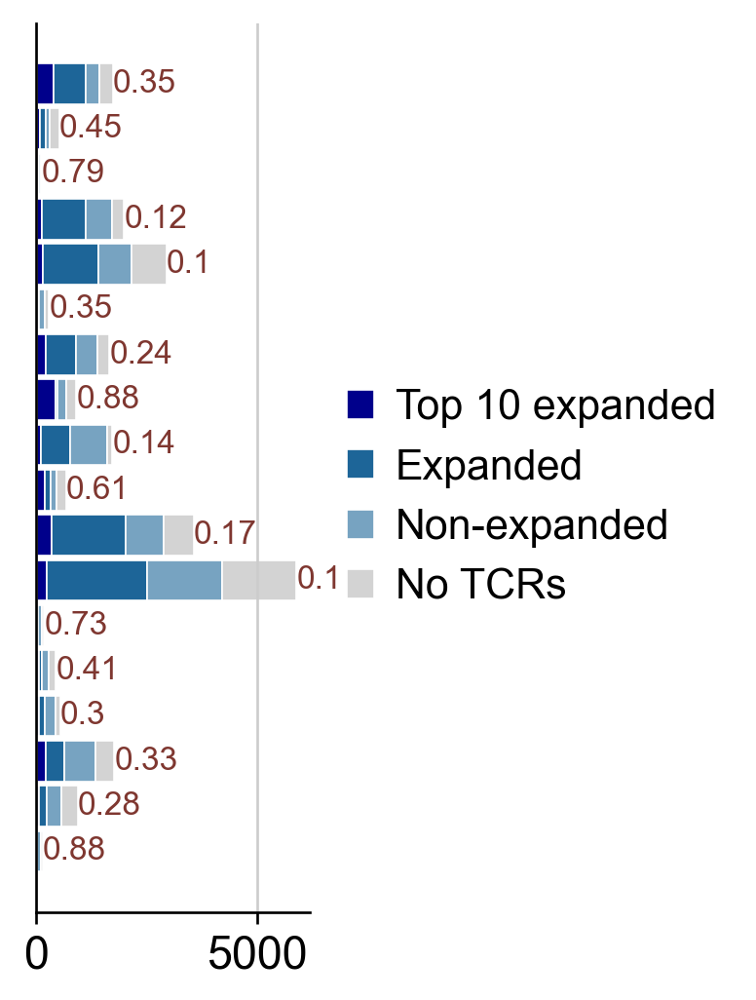

In [1394]:
age_df = get_expand_clonotypes(mdata_CD8T, groupby='gex:batch', ntop=10)
fig0, ax0 = plt.subplots(figsize=(1.5, 5))
colors=['darkblue','#1d6598', '#77a3c1', 'lightgrey']
age_df.columns = ['Top 10 expanded','Expanded', 'Non-expanded', 'No TCRs']
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0', 'RR6_0']
countPlot(age_df, ax=ax0, barlabels=barlabels, colors=colors, bar_label='topRate', xlabel='', show_y=False)
fig0.savefig(f"{figPath}/EBV-CD8TCR-batch-counts.svg",bbox_inches='tight')

In [1619]:
adata_T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-4.4.h5ad")

In [ ]:
barlabels = [ 'NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0', 
             'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1',
             'NK11_1', 'PB9_0']

In [1334]:
adata_CD4T = adata_T[adata_T.obs['leiden-T'].isin(['1', '5', '7'])]
# adata_CD4T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-gexCD4T-2.19.h5ad")

In [ ]:
adata_CD4T = clu(adata_CD4T, key_added='leiden-CD4T', do_har=True)

In [ ]:
annot = {
  'C08_Tn_LEF1':['1'],  # CCR7
  'C09_Tm_SELL': ['0','3','6', '7'],  # SELL,IL7R
  'C10_Tex_CXCL13': ['8'], # CCL5
  'C11_Treg_FOXP3':['4', '5'], # FOXP3
  'C12_Th_PGAM1': ['2'], # XCL1
  'RBCs':['9'], # HBB
  'Platelet':['10'], # PF4
}
adata_CD4T = anno(adata=adata_CD4T, obsKey='anno-CD4T', obsVal='leiden-CD4T', annoDict=annot)
sc.pl.umap(adata_CD4T, color=['anno-CD4T', 'CD4'], legend_loc='on data')

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_CD4T, color=['anno-CD4T'], show=False, ax=ax, )
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/CD4T_anno.png', dpi=400, bbox_inches='tight')

In [298]:
mdata_CD4T = mu.MuData({'gex': adata_CD4T, "airr":nktcl_ir})
mdata_CD4T

MuData object with n_obs × n_vars = 61020 × 33772
  2 modalities
    gex:	17634 x 33772
      obs:	'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'cnv_status', 'leiden-T', 'leiden-CD4T', 'leiden-CD8T-1.2', 'leiden-CD8T-1.3', 'leiden-CD8T-1.4', 'leiden-CD8T-1.5', 'leiden-CD8T-1.6', 'anno-CD4T', 'proliferation', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency'
      var:	'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'airr:chain_pairing_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'gex:batch_colors', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-pca_colors', 'log1p', 'neighbors', 'pca', 'scrublet', 'treatment_colors', 'umap', 'leiden-T_colors', 'rank_genes_groups', 'dendrogram_leiden-T', 'leiden-CD4T_colors', 'anno-CD4T_colors', 'CytoTRACE2_Potency_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      varm:	'PCs'
      layers:	'Raw'
      obsp:	'connectivities', 'distances'
    airr:	57916 x 0
      obs:	'receptor_type', 'receptor_subtype', 'chain_pairing', 'clone_id', 'clone_id_size', 'clonal_expansion'
      uns:	'chain_indices', 'scirpy_version', 'ir_dist_nt_identity', 'clone_id'
      obsm:	'airr', 'chain_indices'

In [500]:
sc.tl.score_genes(adata_CD4T, gene_list=exgenes, score_name='exhaustion')
sc.tl.score_genes(adata_CD4T, gene_list=exgenes, score_name='cytotoxicity')

Prepare data for cytotrace2

In [658]:
import datatable as dt
def prep_cyto(adata:ad.AnnData, anno:str, rawpath:str, annopath:str):
  print("Converting AnnData to CytoTrace2 format...")
  cyto = adata.layers['Raw'].astype('int')
  adata.obs_names_make_unique()
  adata.var_names_make_unique()
  cyto = pd.DataFrame(cyto.todense(), index=list(adata.obs_names), columns=list(adata.var_names)).T
  cyto = cyto.reset_index()
  cyto = dt.Frame(cyto)
  print("Writing CytoTrace2 files...")
  cyto.to_csv(rawpath, sep='\t', compression='gzip')
  cyto_anno = pd.DataFrame(list(adata.obs_names), columns=['cell IDs'])
  cyto_anno['phenotype'] = list(adata.obs[anno])
  cyto_anno.to_csv(annopath, sep='\t', index=False, header=True)
  print("Writing CytoTrace2 files finished...")

In [659]:
prep_cyto(adata_CD8T, anno='anno-CD8T', 
          rawpath='/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-cytotrace2-3.9.tsv.gz', 
          annopath='/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-cytotrace2-anno-3.9.tsv')

Converting AnnData to CytoTrace2 format...
Writing CytoTrace2 files...
Writing CytoTrace2 files finished...


In [660]:
from cytotrace2_py.cytotrace2_py import cytotrace2
cyto_CD8T = cytotrace2('/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-cytotrace2-3.9.tsv.gz',
                     annotation_path = '/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-cytotrace2-anno-3.9.tsv',
                     species='human',
                     batch_size=10000,
                     smooth_batch_size=1000,
                     max_cores=24,
                     seed=14,
                     disable_plotting = True,
                     disable_parallelization=False)

cytotrace2: Input parameters
    Input file: /data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-cytotrace2-3.9.tsv.gz
    Species: human
    Parallelization enabled: True
    Batch size: 10000
    Smoothing batch size: 1000
    Seed: 14
    Output directory: cytotrace2_results
    Plotting enabled: False
    Verbose mode enabled: True
    User-provided limit for number of cores to use: 24
cytotrace2: Dataset characteristics
    Number of input genes:  33727
    Number of input cells:  26064
cytotrace2: Checking models...
All model files are present.
cytotrace2: Preprocessing
cytotrace2: Running 3 prediction batch(es) sequentially using 10 cores per batch.
cytotrace2: Initiated processing batch 1/3 with 8688 cells
    Mapped 13786 input gene names to mouse orthologs
    13785 input genes are present in the model features.
cytotrace2: Performing initial model prediction
cytotrace2: Performing smoothing by diffusion
cytotrace2: Performing smoothing by adaptive KNN
cytotrace2: Initiated processin

In [1486]:
prep_cyto(adata_T, anno='anno-T', 
          rawpath='/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-cytotrace2-3.9.tsv.gz', 
          annopath='/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-cytotrace2-anno-3.9.tsv')

Converting AnnData to CytoTrace2 format...
Writing CytoTrace2 files...
Writing CytoTrace2 files finished...


In [1470]:
from cytotrace2_py.cytotrace2_py import cytotrace2

In [1487]:
cyto_T = cytotrace2('/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-cytotrace2-3.9.tsv.gz',
                     annotation_path = '/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-cytotrace2-anno-3.9.tsv',
                     species='human',
                     batch_size=10000,
                     smooth_batch_size=1000,
                     max_cores=24,
                     seed=42,
                     disable_plotting = True,
                     disable_parallelization=False)

cytotrace2: Input parameters
    Input file: /data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-cytotrace2-3.9.tsv.gz
    Species: human
    Parallelization enabled: True
    Batch size: 10000
    Smoothing batch size: 1000
    Seed: 42
    Output directory: cytotrace2_results
    Plotting enabled: False
    Verbose mode enabled: True
    User-provided limit for number of cores to use: 24
cytotrace2: Dataset characteristics
    Number of input genes:  33727
    Number of input cells:  59153
cytotrace2: Checking models...
All model files are present.
cytotrace2: Preprocessing
cytotrace2: Running 6 prediction batch(es) sequentially using 10 cores per batch.
cytotrace2: Initiated processing batch 1/6 with 9859 cells
    Mapped 13786 input gene names to mouse orthologs
    13785 input genes are present in the model features.
cytotrace2: Performing initial model prediction
cytotrace2: Performing smoothing by diffusion
cytotrace2: Performing smoothing by adaptive KNN
cytotrace2: Initiated processing b

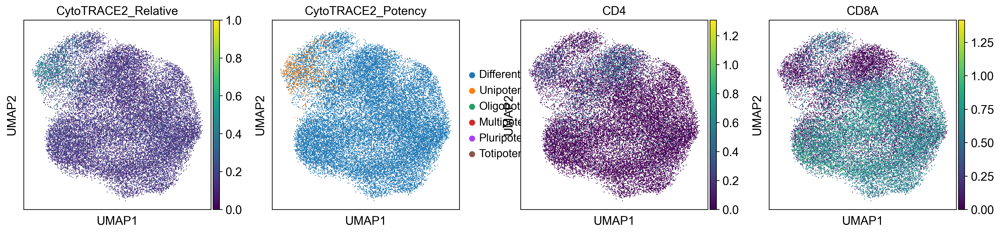

In [1497]:
# adata_CD8T.obs = pd.concat([adata_CD8T.obs, cyto_CD8T], axis=1)
sc.pl.umap(adata_CD8T, color=['CytoTRACE2_Relative', 'CytoTRACE2_Potency', 'CD4', 'CD8A'])

In [1411]:
adata_CD4T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-3.18.h5ad")

In [1410]:
adata_CD8T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-3.18.h5ad")

In [1493]:
adata_T.obs=adata_T.obs[['batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1',
       'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation',
       'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T',
       'clonal_size', 'spot_size']]

In [423]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [424]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
anndata2ri.activate()

/tmp/ipykernel_3008400/3599733125.py:4: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [425]:
%load_ext rpy2.ipython

In [417]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation'):
  """
  使用 Memento 包分析单细胞测序数据中的动态变化。

  Args:
      adata (ad.AnnData): 单细胞测序数据的 AnnData 对象,adata.X requires raw data。
      ctleft (list): 左条件列表，表示刺激前的细胞类型或状态。
      ctright (list): 右条件列表，表示刺激后的细胞类型或状态。
      groupby (str, optional): 用于分组的注释列名。默认为 'annotation'。

  Returns:
      pd.DataFrame: Memento 分析的结果，包括差异表达分析、HT 1D moments 分析等。

  """
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  _adata = ad.AnnData(_adata.layers['Raw'], obs = _adata.obs, var = _adata.var)
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.7)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)

In [418]:
import scanpy as sc
import gseapy as gp
from gseapy import Msigdb
def prep_enrichr(adata, groupby):
  # de analysis
  sc.tl.rank_genes_groups(adata, groupby=groupby)
  sc.tl.dendrogram(adata, groupby=groupby)
  # get deg result
  result = adata.uns['rank_genes_groups']
  groups = result['names'].dtype.names
  degs = pd.DataFrame(
      {group + '_' + key: result[key][group]
      for group in groups for key in ['names','scores', 'pvals','pvals_adj','logfoldchanges']})
  return degs

def run_enrichr_genelist(genelist):
  kegg = gp.enrichr(genelist,
                  gene_sets='KEGG_2021_Human',
                  outdir=None)
  cc = gp.enrichr(genelist,
                      gene_sets='GO_Cellular_Component_2023',
                      outdir=None)
  hm = gp.enrichr(genelist,
                      gene_sets=['MSigDB_Hallmark_2020'],
                      outdir=None)
  mf = gp.enrichr(genelist,
                      gene_sets='GO_Molecular_Function_2023',
                      outdir=None)
  bp = gp.enrichr(genelist,
                      gene_sets=['GO_Biological_Process_2023'],
                      outdir=None)
  return kegg, cc, hm, mf, bp

def run_enrichr_scanpy(degs, group,direction='up', top_term=15, all_term=False, plot=True):
  # subset up or down regulated genes
  degs_sig = degs[degs[f'{group}_pvals_adj'] < 0.05]
  degs_up = degs_sig[degs_sig[f'{group}_logfoldchanges'] > 0]
  degs_dw = degs_sig[degs_sig[f'{group}_logfoldchanges'] < 0]
  degs_used = degs_up[f'{group}_names'] if direction == 'up' else degs_dw[f'{group}_names']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(top_term),
                    hm.res2d.head(top_term), 
                    cc.res2d.head(top_term), 
                    bp.res2d.head(top_term), 
                    mf.res2d.head(top_term)])
  if plot:
    ax = gp.barplot(go_res, figsize=(6,20),
                group ='Gene_set',
                top_term=top_term,
                color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
                title ="The Most Enriched Terms")
  else:
    ax = None
  if all_term:
    go_res = pd.concat([kegg.res2d, hm.res2d, cc.res2d, bp.res2d, mf.res2d])
  return go_res, ax
  
def run_enrichr_memento(memento_results,direction='up', top_term=15):
  memento_sig = memento_results[memento_results['de_pval'] < 0.05]
  memento_up = memento_sig[memento_sig['de_coef'] > 0]
  memento_dw = memento_sig[memento_sig['de_coef'] < 0]
  degs_used = memento_up['gene'] if direction == 'up' else memento_dw['gene']
  kegg, cc, hm, mf, bp = run_enrichr_genelist(degs_used)
  go_res = pd.concat([kegg.res2d.head(15),
                      hm.res2d.head(15), 
                      cc.res2d.head(15), 
                      bp.res2d.head(15), 
                      mf.res2d.head(15)])
  ax = gp.barplot(go_res, figsize=(6,20),
              group ='Gene_set',
              top_term=top_term,
              color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
              title ="The Most Enriched Terms")
  return go_res, ax

In [420]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Teff_IFNG', 'C04_XCL1_CD200-',
       'C05_XCL1_CD200+', 'C06_Tex_CD8', 'C07_Tex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_IFNG', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

Malignant Enrichment pathway

In [ ]:
# degs = prep_enrichr(adata_T, groupby='anno-subTfixed')
Malig_res, ax = run_enrichr_scanpy(degs,'C13_Malig_MSI2',direction='up', top_term=15, all_term=True, plot=True)

In [ ]:
Malig_T2, ax = run_enrichr_scanpy(degs,'C12_Tprol_MKI67',direction='up', top_term=15, all_term=True, plot=True)

In [ ]:
ax.figure.savefig(f"{figPath}/Figure5c-Malig T2.svg", bbox_inches='tight')

In [ ]:
NK_degs = prep_enrichr(adata_NK, groupby='anno-NK')

In [ ]:
adata_NK.obs['anno-NK'].cat.categories

Index(['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C05_NKT_FGFBP2', 'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'],
      dtype='object')

In [ ]:
Malig_NK1, ax = run_enrichr_scanpy(NK_degs,'C07_Malig_IL2RA',direction='up', top_term=15, all_term=True, plot=True)

In [ ]:
Malig_NK2, ax = run_enrichr_scanpy(NK_degs,'C08_Malig_H2AC11',direction='up', top_term=15, all_term=True, plot=True)

In [1781]:
adata_NK.obs['anno-NK'].cat.categories

Index(['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C05_NKT_FGFBP2', 'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'],
      dtype='object')

In [ ]:
Mature_NK, ax = run_enrichr_scanpy(NK_degs,'C02_NK_CD56',direction='up', top_term=15, all_term=True, plot=True)

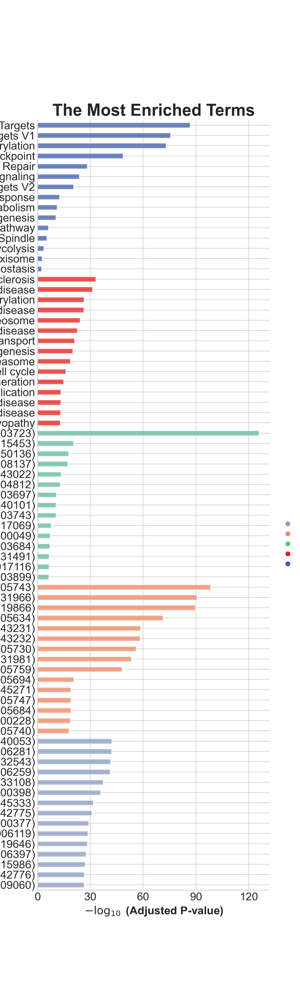

In [1785]:
Immature_NK, ax = run_enrichr_scanpy(NK_degs,'C01_NK_MKI67',direction='up', top_term=15, all_term=True, plot=True)

In [1811]:
list(Immature_NK.sort_values(by='Adjusted P-value', ascending=True).iloc[:30,:]['Term'])

['RNA Binding (GO:0003723)',
 'Mitochondrial Inner Membrane (GO:0005743)',
 'Mitochondrial Membrane (GO:0031966)',
 'Organelle Inner Membrane (GO:0019866)',
 'E2F Targets',
 'Myc Targets V1',
 'Oxidative Phosphorylation',
 'Nucleus (GO:0005634)',
 'Intracellular Membrane-Bounded Organelle (GO:0043231)',
 'Intracellular Non-Membrane-Bounded Organelle (GO:0043232)',
 'Nucleolus (GO:0005730)',
 'Nuclear Lumen (GO:0031981)',
 'G2-M Checkpoint',
 'Mitochondrial Matrix (GO:0005759)',
 'Mitochondrial Gene Expression (GO:0140053)',
 'DNA Repair (GO:0006281)',
 'Mitochondrial Translation (GO:0032543)',
 'DNA Metabolic Process (GO:0006259)',
 'Mitochondrial Respiratory Chain Complex Assembly (GO:0033108)',
 'mRNA Splicing, Via Spliceosome (GO:0000398)',
 'Amyotrophic lateral sclerosis',
 'Cellular Respiration (GO:0045333)',
 'Parkinson disease',
 'Mitochondrial ATP Synthesis Coupled Electron Transport (GO:0042775)',
 'RNA Splicing, Via Transesterification Reactions With Bulged Adenosine As Nucle

In [1786]:
ax.figure.savefig(f"{figPath}/Figure2l-Immature NK.svg", bbox_inches='tight')

In [1816]:
Mature_Pathway = [
 'E2F Targets',
 'Myc Targets V1',
 'G2-M Checkpoint',
 'Mitochondrial Matrix (GO:0005759)',
  'Myc Targets V2',
 'Interferon Gamma Response',
 'TNF-alpha Signaling via NF-kB',
 'Interferon Alpha Response',
 'Epstein-Barr virus infection',
 'Allograft Rejection',
 'Antigen processing and presentation'
]

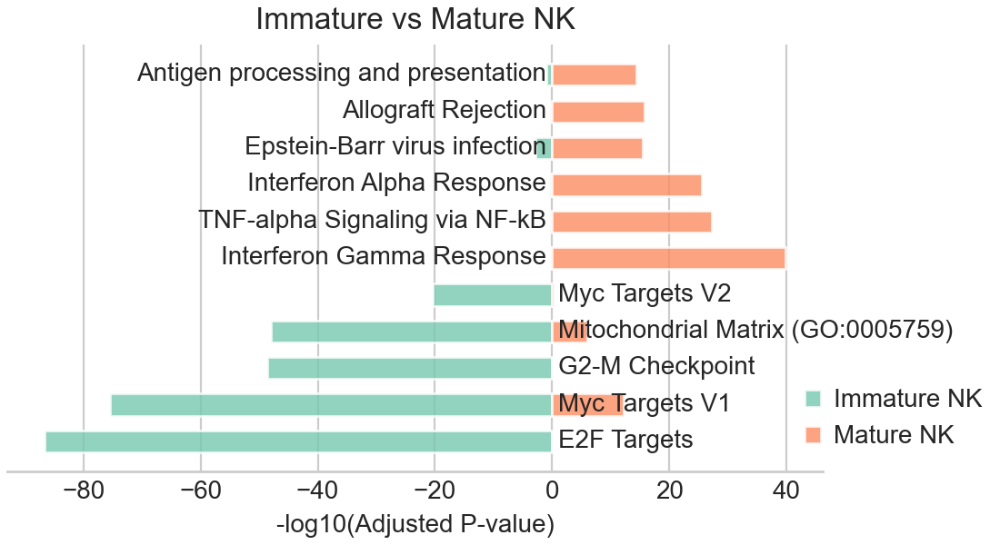

In [1826]:
# 设置图形大小
use_pathway_left = Immature_NK[Immature_NK['Term'].isin(Mature_Pathway)]
use_pathway_right = Mature_NK[Mature_NK['Term'].isin(Mature_Pathway)]
use_pathway_left.index = use_pathway_left['Term']
use_pathway_right.index = use_pathway_right['Term']
use_pathway_left = use_pathway_left.loc[Mature_Pathway, :]
use_pathway_right = use_pathway_right.loc[Mature_Pathway, :]
fig, ax = plt.subplots(figsize=(5.5, 3), constrained_layout=True)

# 绘制柱状图
rects = ax.barh(use_pathway_left['Term'], 
                 np.log10(use_pathway_left['Adjusted P-value']), 
                 height=0.6, alpha=0.8,
                 color='#77c8af',
                 label='Immature NK')
rects = ax.barh(use_pathway_right['Term'], 
                -np.log10(use_pathway_right['Adjusted P-value']), 
                height=0.6, 
                alpha=0.8,
                color='#fc8d62',
                label='Mature NK')
# 绘制基因名称
for i, row in enumerate(use_pathway_left['Term'][:5]):
    ax.text(1, i, row, ha='left', va='center', fontsize=10)
for i, row in enumerate(use_pathway_left['Term'][5:]):
    ax.text(-1, i+5, row, ha='right', va='center', fontsize=10)
ax.legend( bbox_to_anchor=(0.95, 0), 
            handletextpad=0.5, frameon=False,
                        borderpad=0.4,
                        columnspacing=1,
                        handlelength=0.65,
            loc='lower left')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
ax.spines.top.set_visible(False)
ax.spines.left.set_visible(False)
ax.spines.right.set_visible(False)
# 设置刻度
# ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
#                       int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
ax.set_title("Immature vs Mature NK")
fig.savefig(f"{figPath}/Figure2l.svg", bbox_inches='tight')

In [ ]:
Selected_Pathway = [
  'Mitotic Spindle',
  'Protein Serine/Threonine Kinase Activity (GO:0004674)',
  'Phosphorylation (GO:0016310)',
  'Peptidyl-Serine Phosphorylation (GO:0018105)',
  'Phosphatidylinositol signaling system',
  'Inositol phosphate metabolism',
  'GTPase Regulator Activity (GO:0030695)',
  'Guanyl-Nucleotide Exchange Factor Activity (GO:0005085)',
  'T cell receptor signaling pathway',
  'Ubiquitin mediated proteolysis',
  'Epithelial Mesenchymal Transition',
  'Systemic lupus erythematosus',
  'Neutrophil extracellular trap formation',
  'Collagen-Containing Extracellular Matrix (GO:0062023)',
  'E2F Targets',
  'RNA Binding (GO:0003723)',
  'Myc Targets V1',
  'Oxidative Phosphorylation',
  'G2-M Checkpoint',
  'mTORC1 Signaling',
]

/tmp/ipykernel_3008400/3020588203.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
/tmp/ipykernel_3008400/3020588203.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_3008400/3020588203.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_3008400/30205

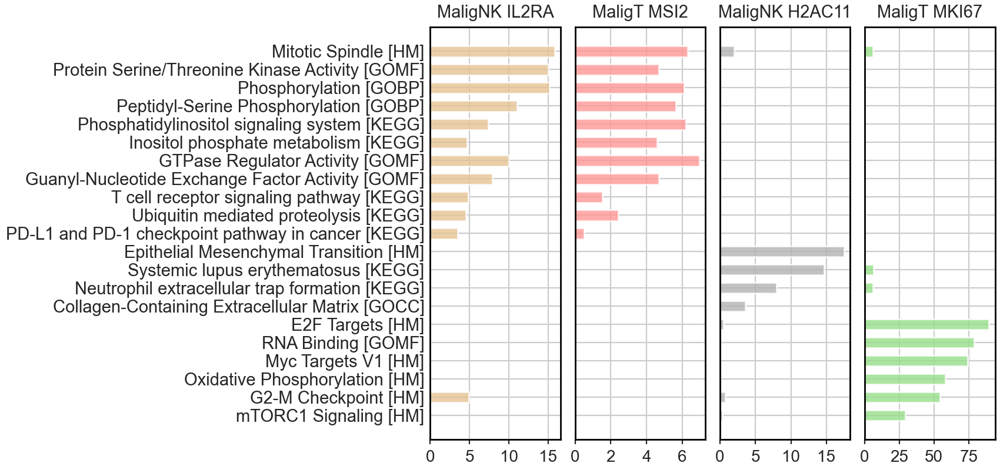

In [ ]:
from matplotlib.ticker import MaxNLocator
plt.style.use('seaborn-whitegrid')
fig, ax = plt.subplots(1, 4, figsize=(8.5, 4), constrained_layout=True)
datas = [Malig_NK1,Malig_res, Malig_NK2,  Malig_T2]
labels = ['MaligNK IL2RA', 'MaligT MSI2', 'MaligNK H2AC11', 'MaligT MKI67']
colors = ['#e5c494', '#ff9896', '#b3b3b3','#98df8a']
for i, d in enumerate(datas):
  data = d.loc[d['Term'].isin(Selected_Pathway),:]
  data['Term'] = pd.Categorical(data['Term'], categories=Selected_Pathway, ordered=True)
  data = data.sort_values(by='Term', ascending=False)
  # 绘制柱状图
  rects = ax[i].barh(data['Term'], 
                  -np.log10(data['Adjusted P-value']), 
                  height=0.6, alpha=0.8,
                  label=labels[i], color=colors[i])
  ax[i].set_title(labels[i], fontsize=10.5)
  ax[i].xaxis.set_major_locator(MaxNLocator(nbins=4))
  ax[i].tick_params(axis='y', which='both', length=0)
  ax[i].tick_params(axis='x', which='both', length=3)
  for spine in ax[i].spines.values():
    spine.set_visible(True)
    spine.set_color('black')
    spine.set_linewidth(1.0)
  if i > 0:
    ax[i].set_yticklabels([])
ax[0].set_yticklabels(['mTORC1 Signaling [HM]',
 'G2-M Checkpoint [HM]',
 'Oxidative Phosphorylation [HM]',
 'Myc Targets V1 [HM]',
 'RNA Binding [GOMF]',
 'E2F Targets [HM]',
 'Collagen-Containing Extracellular Matrix [GOCC]',
 'Neutrophil extracellular trap formation [KEGG]',
 'Systemic lupus erythematosus [KEGG]',
 'Epithelial Mesenchymal Transition [HM]',
 'Ubiquitin mediated proteolysis [KEGG]',
 'T cell receptor signaling pathway [KEGG]',
 'Guanyl-Nucleotide Exchange Factor Activity [GOMF]',
 'GTPase Regulator Activity [GOMF]',
 'Inositol phosphate metabolism [KEGG]',
 'Phosphatidylinositol signaling system [KEGG]',
 'Peptidyl-Serine Phosphorylation [GOBP]',
 'Phosphorylation [GOBP]',
 'Protein Serine/Threonine Kinase Activity [GOMF]',
 'Mitotic Spindle [HM]'], fontsize=10.5)
fig.savefig(f"{figPath}/Figure5c-Selected.svg", bbox_inches='tight')

In [ ]:
ax.figure.savefig(f"{figPath}/Figure5c-Malig NK2.svg", bbox_inches='tight')

Malignant vs. Normal

In [456]:
ctleft = ['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Teff_IFNG', 'C04_XCL1_CD200-',
       'C05_XCL1_CD200+', 'C06_Tex_CD8', 'C07_Tex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_IFNG', 'C14_NK/NKT_NCAM1', ]
ctright = ['C12_Tprol_MKI67', 'C13_Malig_MSI2', ]
MvN_degs = DE_memento_1d(adata_T, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-subTfixed')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [ ]:
ctleft = ['Pre']
ctright = ['Post']
MvN_treat_degs = DE_memento_1d(adata_T[adata_T.obs['anno-subTfixed'].isin(['C12_Tprol_MKI67', 'C13_Malig_MSI2',])], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [457]:
%%R -i MvN_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(MvN_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          custom_label = c('ELMO1', 'HLA-E', 'LRBA','KLF12','EEF1A1', 'NACA','UBE2C', 'RRM2', 'TYMS', 'CTSW', 'RGS1', 'DUSP1', 'CST7', 'MSI2', 'RUNX1'),
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_T_MvN.pdf", p, width = 3.2, height = 4, units = "in")

In [449]:
MvN_degs[MvN_degs['de_coef'] < 0].sort_values(by=['de_pval']).head(30)

,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval
4695,KLF12,stim,-0.628636,0.015783,0.000000e+00,-0.027356,0.060512,7.157068e-01
2703,ELMO1,stim,-0.645510,0.016522,0.000000e+00,0.266723,0.072731,1.240697e-04
1047,ARHGAP15,stim,-0.489686,0.013996,1.750984e-268,0.088677,0.047822,3.186005e-02
2595,ARID1B,stim,-0.598497,0.018044,1.541972e-241,-0.075599,0.068117,7.995231e-01
1479,ZBTB20,stim,-0.534823,0.016476,1.905706e-231,0.157595,0.048075,5.227822e-04
1868,LRBA,stim,-0.529528,0.016353,2.582804e-230,0.326288,0.078425,1.607380e-05
3863,PDE3B,stim,-0.511826,0.016243,3.262210e-218,0.500180,0.060109,4.359646e-17
2276,ATXN1,stim,-0.497835,0.016214,2.593346e-207,0.406612,0.052231,3.492724e-15
2914,EXOC4,stim,-0.607338,0.019901,7.547106e-205,-0.072906,0.071087,7.224698e-01
4500,CHST11,stim,-0.540766,0.017739,2.151463e-204,0.253378,0.057044,4.465186e-06


In [ ]:
adata_CD4T.obs['anno-CD4T'].cat.categories

Index(['C08_Treg_FOXP3', 'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK'], dtype='object')

In [ ]:
ctleft = [ 'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK']
ctright = ['C08_Treg_FOXP3']
Treg_anno_degs = DE_memento_1d(adata_CD4T, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-CD4T')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [1174]:
cpdb_res_post

{'deconvoluted':              gene_name uniprot  is_complex protein_name  \
 multidata_id                                              
 1355           UBASH3B  Q8TF42        True  UBS3B_HUMAN   
 1355           UBASH3B  Q8TF42        True  UBS3B_HUMAN   
 1355           UBASH3B  Q8TF42        True  UBS3B_HUMAN   
 1356           SULT1A1  P50225        True  ST1A1_HUMAN   
 1356           SULT1A1  P50225        True  ST1A1_HUMAN   
 ...                ...     ...         ...          ...   
 11             ATP6AP2  O75787       False   RENR_HUMAN   
 1354              TLR8  Q9NR97       False   TLR8_HUMAN   
 363               CD44  P16070       False   CD44_HUMAN   
 1353           SIGLEC1  Q9BZZ2       False     SN_HUMAN   
 368             PECAM1  P16284       False  PECA1_HUMAN   
 
                               complex_name id_cp_interaction     gene  \
 multidata_id                                                            
 1355          Dehydroepiandrosterone_bySTS   CPI-CS09

In [ ]:
%%R -i Treg_anno_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(Treg_anno_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_Treg_anno.pdf", p, width = 3.2, height = 4, units = "in")

In [428]:
ctleft = ['Pre']
ctright = ['Post']
Treg_degs = DE_memento_1d(adata_CD4T[adata_CD4T.obs['anno-CD4T'] == 'C08_Treg_FOXP3'], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

In [454]:
%%R -i Treg_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(Treg_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_Treg_treat.pdf", p, width = 3.2, height = 4, units = "in")

In [ ]:
%%R -i pTex_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(pTex_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_pTex.pdf", p, width = 3.2, height = 4, units = "in")

In [ ]:
ctleft = ['Pre']
ctright = ['Post']
adata_CD8T_pTex = adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C04_pTex_IFNG'])]
pTex_degs = DE_memento_1d(adata_CD8T_pTex, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

In [ ]:
ctleft = ['C06_tTex_CD8', 'C07_tTex_CD4']
ctright = [ 'C04_pTex_IFNG',]
pTex_anno_degs = DE_memento_1d(adata_CD8T, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-CD8T')

In [ ]:
pTex_up = pTex_anno_degs[pTex_anno_degs['de_coef'] > 0.4]
pTex_up = pTex_up[pTex_up['de_pval'] < 10e-5]

pTex_post = pTex_degs[pTex_degs['de_coef'] > 0.4]
pTex_post = pTex_post[pTex_post['de_pval'] < 10e-5]

up_post = list(set(pTex_up['gene']).intersection(pTex_post['gene']))
pTex_post[pTex_post['gene'].isin(up_post)]

In [ ]:
pTex_genes = list(set(pTex_degs['gene']).intersection(pTex_anno_degs['gene']))
pTex_genes

In [ ]:
pTex_anno_df = pTex_anno_degs[pTex_anno_degs['gene'].isin(pTex_genes)]
pTex_anno_df.index = pTex_anno_df['gene']
pTex_anno_df.columns = [s + '_anno' for s in pTex_anno_df.columns]
pTex_treat_df = pTex_degs[pTex_degs['gene'].isin(pTex_genes)]
pTex_treat_df.index = pTex_treat_df['gene']
pTex_treat_df.columns = [s + '_treat' for s in pTex_treat_df.columns]
pTex_df = pd.concat([pTex_anno_df, pTex_treat_df], axis=1)

In [ ]:
from matplotlib.colors import Normalize
from matplotlib.lines import Line2D
def DEplot_2D(deg_anno:pd.DataFrame, deg_treat:pd.DataFrame, coef=0.5):
    # 线性插值计算size的函数
    def calculate_size(p):
        min_p = 1e-20
        max_p = 1e-5
        min_size = 30
        max_size = 120
        return ((p - min_p) / (max_p - min_p)) * (max_size - min_size) + min_size
    genes = list(set(deg_anno['gene']).intersection(deg_treat['gene']))
    anno_df = deg_anno.copy()
    treat_df = deg_treat.copy()
    anno_df = anno_df[anno_df['gene'].isin(genes)]
    anno_df.index = anno_df['gene']
    anno_df.columns = [s + '_anno' for s in anno_df.columns]
    treat_df = treat_df[treat_df['gene'].isin(genes)]
    treat_df.index = treat_df['gene']
    treat_df.columns = [s + '_treat' for s in treat_df.columns]
    df = pd.concat([anno_df, treat_df], axis=1)
    
    colors = []
    sizes = []
    alphas = []
    color_values = []

    for i in range(len(df)):
        if -coef < df['de_coef_anno'][i] < coef or \
            -coef < df['de_coef_treat'][i] < coef or \
            df['de_pval_anno'][i] > 1e-5 or \
            df['de_pval_treat'][i] > 1e-5:
            sizes.append(20)  # 灰色点大小稍小
            alphas.append(0.3)  # 灰色点透明度更高
            colors.append('gray')
        else:
            # 计算 x 和 y 的综合值
            combined_value = (df['de_coef_anno'][i] + df['de_coef_anno'][i]) / 2
            color_values.append(combined_value)
            colors.append(None)
            sizes.append(calculate_size(df['de_pval_treat'][i]))  # 蓝色点正常大小
            alphas.append(1)  # 蓝色点正常透明度

    # 创建颜色映射
    norm = Normalize(vmin=min(color_values), vmax=max(color_values))
    cmap = plt.get_cmap('coolwarm')


    # 为蓝色点设置颜色
    color_index = 0
    for i, color in enumerate(colors):
        if color is None:
            colors[i] = cmap(norm(color_values[color_index]))
            color_index += 1
    df['sig'] = colors

    ax = sns.scatterplot(df, 
                     x='de_coef_anno', 
                     y='de_coef_treat', 
                     color=colors,
                     s=sizes,
                     alpha=alphas,
                     zorder=0)
    # 为蓝色的点添加标注
    for i, color in enumerate(colors):
        if isinstance(color, tuple):  # 判断是否为蓝色点
            ax.annotate(df['gene_anno'][i], 
                        (df['de_coef_anno'][i], df['de_coef_treat'][i]), textcoords="offset points",
                        xytext=(0, 10), ha='center',zorder=3)

    ax.axvline(x=coef, linestyle='--', color='black',zorder=3, linewidth=0.5)
    ax.axvline(x=-coef, linestyle='--', color='black',zorder=3, linewidth=0.5)
    ax.axhline(y=coef, linestyle='--', color='black',zorder=3, linewidth=0.5)
    ax.axhline(y=-coef, linestyle='--', color='black',zorder=3, linewidth=0.5)

    # 将横纵坐标刻度放到 0 的位置
    ax.spines['left'].set_position('zero')
    ax.spines['bottom'].set_position('zero')
    # 隐藏顶部和右侧的边框
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.set_xlim(-2.5, 1.7)
    ax.set_ylim(-1.8, 1.8)
    ax.set_xticks([-1.5, -1, -0.5, 0.5, 1, 1.5])
    ax.set_yticks([-1.5, -1, -0.5, 0.5, 1, 1.5])
    for tick in ax.get_xticklines() + ax.get_yticklines():
        tick.set_zorder(10)
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_zorder(10)
    ax.set_xlabel('')
    ax.set_ylabel('')


    # 创建大小图例
    size_legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='50', markerfacecolor='black', markersize=np.sqrt(50)),
        Line2D([0], [0], marker='o', color='w', label='10', markerfacecolor='black', markersize=np.sqrt(30)),
        Line2D([0], [0], marker='o', color='w', label='No sig', markerfacecolor='black', markersize=np.sqrt(20))
    ]
    # 添加图例
    first_legend = ax.legend(handles=size_legend_elements, loc='upper left', title='nelogP-value')
    ax.add_artist(first_legend)
    # 显示图形
    ax.figure.set_size_inches(5,4.5)
    return df, ax

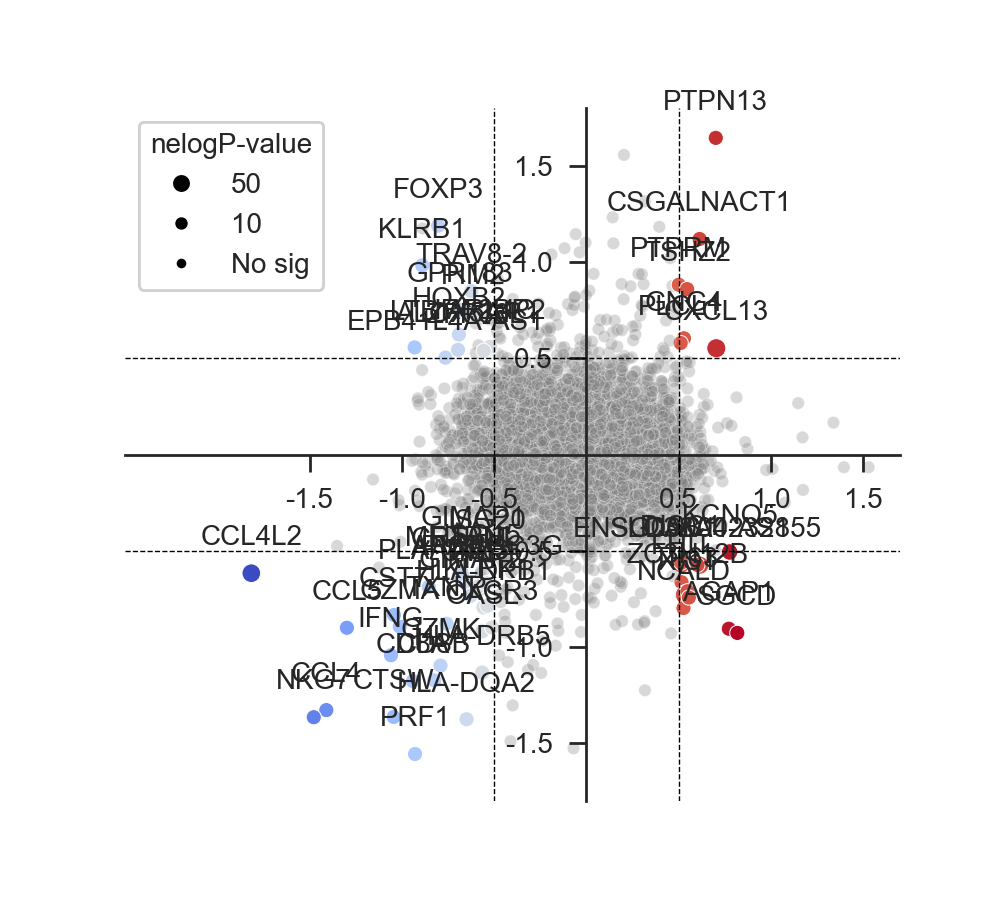

In [ ]:
MvN_df, MvN_ax = DEplot_2D(MvN_degs, MvN_treat_degs)

In [ ]:
MvN_ax.figure.savefig(f"{figPath}/DE_maligT_2D.pdf", bbox_inches='tight')

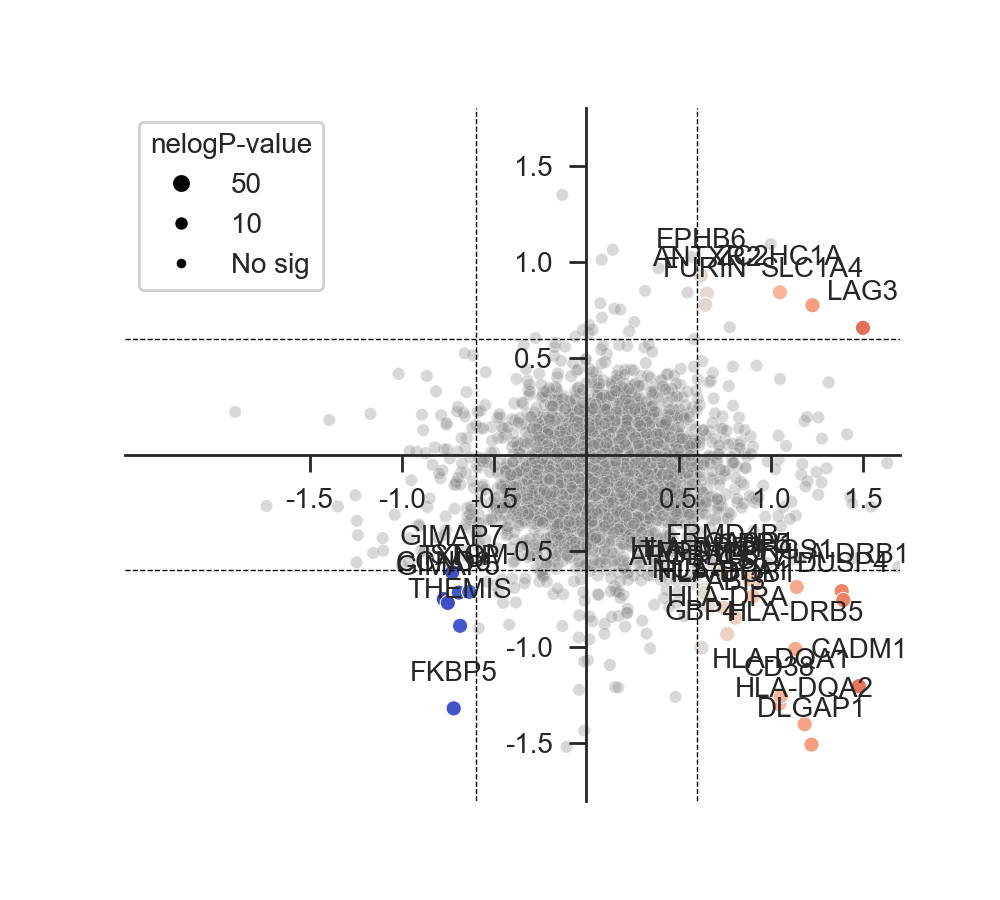

In [ ]:
Treg_df, Treg_ax = DEplot_2D(Treg_anno_degs, Treg_degs, coef=0.6)

In [ ]:
Treg_ax.figure.savefig(f"{figPath}/DE_Treg_2D.pdf", bbox_inches='tight')

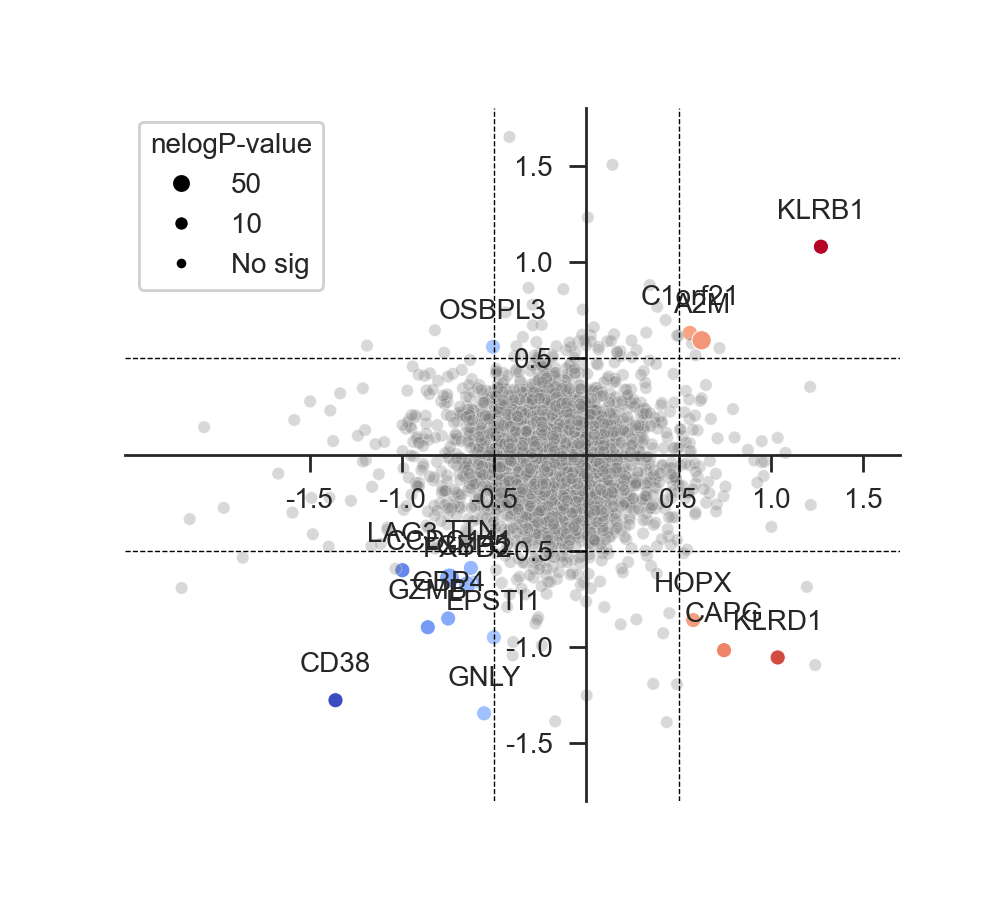

In [ ]:
pTex_df, pTex_ax = DEplot_2D(pTex_anno_degs, pTex_degs)

In [ ]:
pTex_ax.figure.savefig(f"{figPath}/DE_pTex_2D.pdf", bbox_inches='tight')

In [ ]:
%%R -i pTex_anno_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(pTex_anno_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_pTex_anno.pdf", p, width = 3.2, height = 4, units = "in")

In [ ]:
ctleft = ['Pre']
ctright = ['Post']
tTex_CD8_degs = DE_memento_1d(adata_CD8T[adata_CD8T.obs['anno-CD8T'].isin(['C06_tTex_CD8'])], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

In [ ]:
%%R -i tTex_CD8_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(tTex_CD8_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_tTex_CD8.pdf", p, width = 3.2, height = 4, units = "in")

In [ ]:
adata_NK.obs['anno-NK'].cat.categories

Index(['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C05_NKT_FGFBP2', 'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'],
      dtype='object')

In [ ]:
ctleft = ['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C06_NK_KIT', 'C05_NKT_FGFBP2' ]
ctright = ['C07_Malig_IL2RA', 'C08_Malig_H2AC11']
maligNK_anno_degs = DE_memento_1d(adata_NK, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-NK')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requi

In [ ]:
ctleft = ['Pre']
ctright = ['Post', 'PBMC']
maligNK_treat_degs = DE_memento_1d(adata_NK[adata_NK.obs['anno-NK'].isin(['C07_Malig_IL2RA', 'C08_Malig_H2AC11'])], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=16)]: Done 304 tasks      | elapsed:    3.5s
[Parallel(n_jobs=16)]: Done 804 tasks      | elapsed:    9.4s
[Parallel(n_jobs=16)]: Done 1504 tasks      | elapsed:   17.5s
[Parallel(n_jobs=16)]: Done 2071 out of 2102 | elapsed:   23.8s remaining:    0.4s
[Parallel(n_jobs=16)]: Done 2102 out of 2102 | elapsed:   24.1s finished


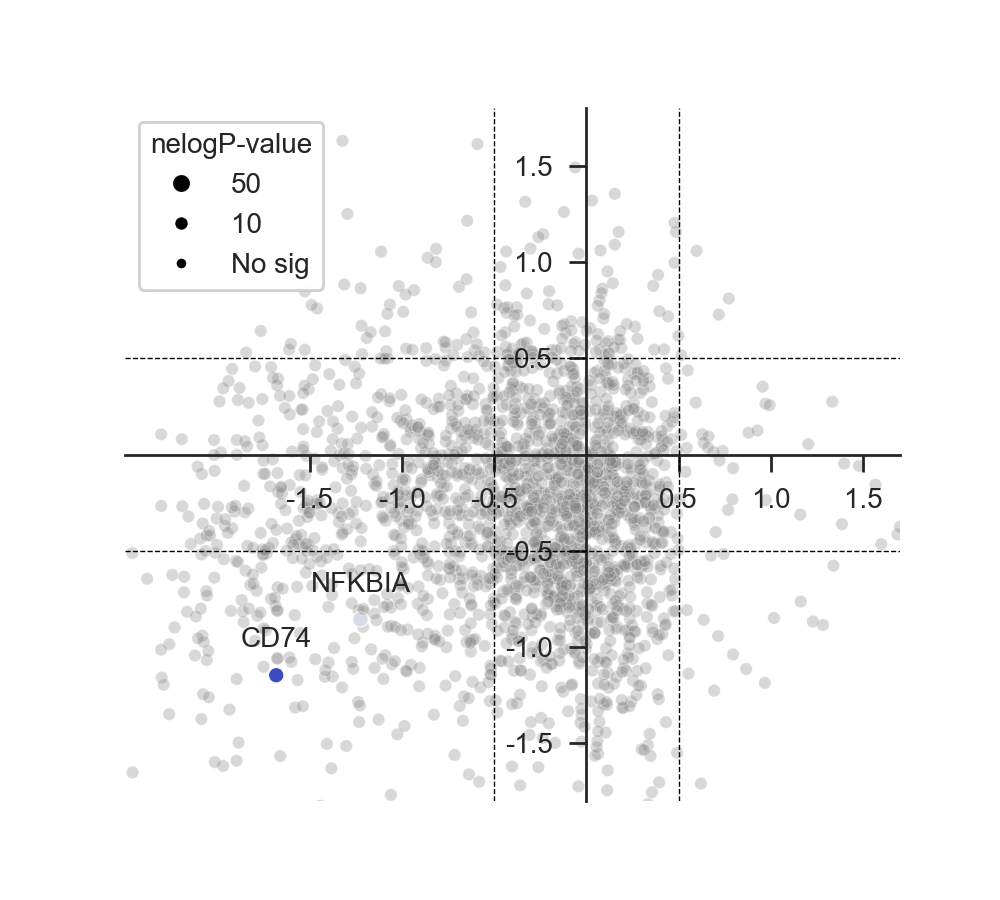

In [ ]:
maligNK_df, maligNK_ax = DEplot_2D(maligNK_anno_degs, maligNK_treat_degs,coef=0.5)

In [ ]:
maligNK_ax.figure.savefig(f"{figPath}/DE_maligNK_2D.pdf", bbox_inches='tight')

In [ ]:
ctleft = ['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11']
ctright = [ 'C05_NKT_FGFBP2']
NKT_anno_degs = DE_memento_1d(adata_NK, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-NK')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(
[Parallel(n_jobs=16)]: Done   1 out of   1 | elapsed:    7.3s finished
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested

In [ ]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

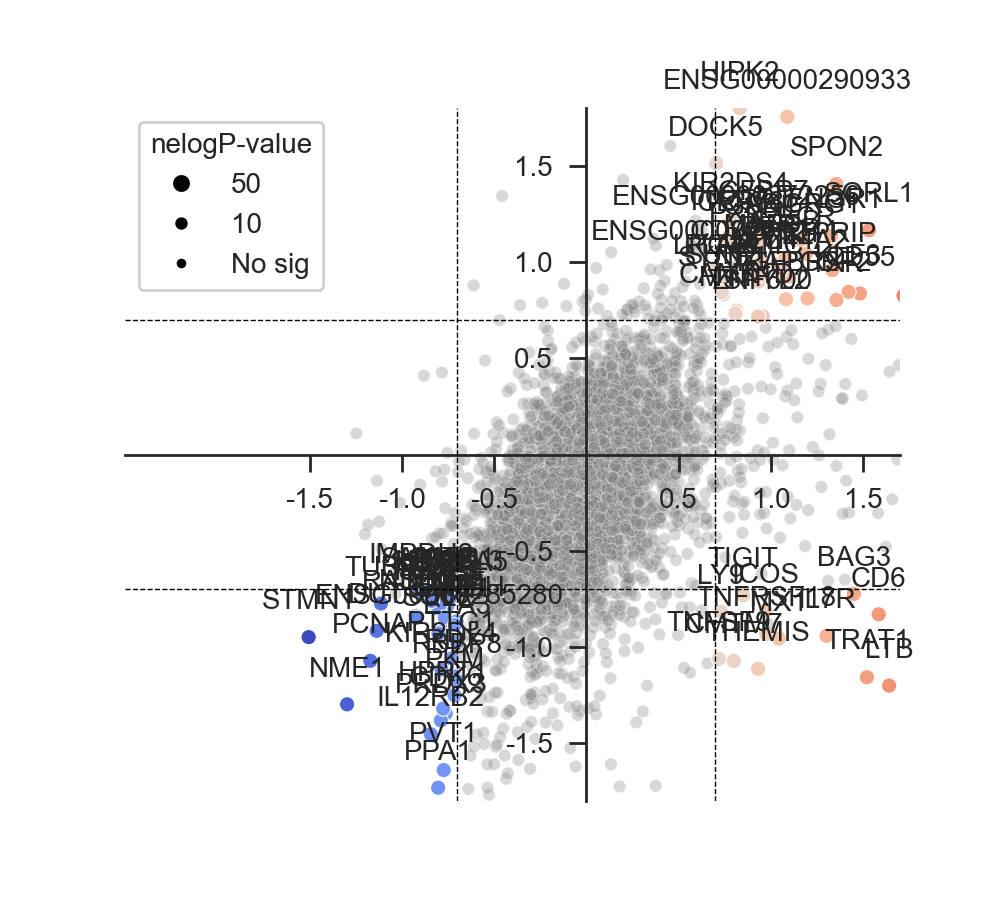

In [ ]:
NKT_df, NKT_ax = DEplot_2D(NKT_anno_degs, NKT_degs,coef=0.7)

In [ ]:
NKT_ax.figure.savefig(f"{figPath}/DE_NKT.pdf", bbox_inches='tight')

In [ ]:
ctleft = ['Pre']
ctright = ['Post', 'PBMC']
NKT_degs = DE_memento_1d(adata_NK[adata_NK.obs['anno-NK'].isin(['C05_NKT_FGFBP2'])], 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='treatment')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=16)]: Done 304 tasks      | elapsed:    3.1s
[Parallel(n_jobs=16)]: Done 804 tasks      | elapsed:    8.3s
[Parallel(n_jobs=16)]: Done 1504 tasks      | elapsed:   15.5s
[Parallel(n_jobs=16)]: Done 2404 tasks      | elapsed:   24.8s
[Parallel(n_jobs=16)]: Done 3504 tasks      | elapsed:   36.4s
[Parallel(n_jobs=16)]: Done 4804 tasks      | elapsed:   53.9s
[Parallel(n_jobs=16)]: Done 6304 tasks      | elapsed:  1.2min
[Parallel(n_jobs=16)]: Done 6487 out of 6518 | elapsed:  1.3min remaining:    0.4s
[Parallel(n_jobs=16)]: Done 6518 out of 6518 | elapsed:  1.3min finished


In [ ]:
%%R -i NKT_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(NKT_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_NKT.pdf", p, width = 3.2, height = 4, units = "in")

In [429]:
ctleft = ['C07_Tex_CD4' ]
ctright = ['C06_Tex_CD8',]
Tex_degs = DE_memento_1d(adata_CD8T, 
                         ctleft = ctleft, 
                         ctright = ctright, 
                         groupby='anno-subTfixed')

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=16)]: Done 304 tasks      | elapsed:    2.8s
[Parallel(n_jobs=16)]: Done 804 tasks      | elapsed:    7.3s
[Parallel(n_jobs=16)]: Done 1504 tasks      | elapsed:   13.5s
[Parallel(n_jobs=16)]: Done 2404 tasks      | elapsed:   21.7s
[Parallel(n_jobs=16)]: Done 3504 tasks      | elapsed:   31.5s
[Parallel(n_jobs=16)]: Done 4804 tasks      | elapsed:   43.2s
[Parallel(n_jobs=16)]: Done 6304 tasks      | elapsed:   56.4s
[Parallel(n_jobs=16)]: Done 6845 out of 6876 | elapsed:  1.0min remaining:    0.3s
[Parallel(n_jobs=16)]: Done 6876 out of 6876 | elapsed:  1.0min finished


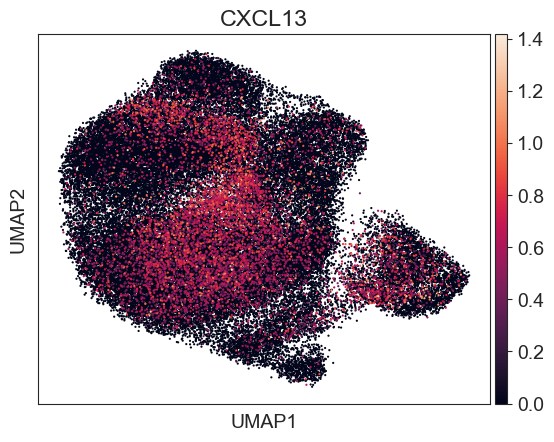

In [445]:
sc.pl.umap(adata_T, color=['CXCL13'], size=10)

In [455]:
%%R -i Tex_degs
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(Tex_degs, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20,
          output = FALSE, legend_position = "UR",
          log2FC_cut = 0.4, FDR_cut = 1e-5) +
    labs(x="correlation", y="-log P-value")
ggsave("~/NKTCL-figure-2.18/DE_T_Tex.pdf", p, width = 3.2, height = 4, units = "in")

In [594]:
adata_NK.obs['anno-NK'].cat.categories

Index(['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C05_NKT_FGFBP2', 'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'],
      dtype='object')

In [595]:
degs = prep_enrichr(adata_NK, "anno-NK")

In [597]:
gores_list = []
# cell_types = adata_NK.obs['anno-NK'].cat.categories
cell_types = ['C05_NKT_FGFBP2']
for ct in cell_types:
  print("Running enrichment for {}...".format(ct))
  go_res, _ = run_enrichr_scanpy(degs, ct,direction='up', top_term=15, all_term=True, plot=False)
  go_res = go_res =  go_res[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
  go_res['anno'] = ct
  gores_list.append(go_res)
gores = pd.concat(gores_list, axis=0, ignore_index=True)
gores

Running enrichment for C05_NKT_FGFBP2...


,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno
0,KEGG_2021_Human,Herpes simplex virus 1 infection,183/498,2.808388e-18,8.649834e-16,2.364896,9.557473e+01,C05_NKT_FGFBP2
1,KEGG_2021_Human,T cell receptor signaling pathway,50/104,1.497707e-10,2.306469e-08,3.703936,8.379014e+01,C05_NKT_FGFBP2
2,KEGG_2021_Human,Yersinia infection,56/137,2.185156e-08,2.243427e-06,2.765084,4.877330e+01,C05_NKT_FGFBP2
3,KEGG_2021_Human,Endocytosis,85/252,2.677870e-07,2.061960e-05,2.039542,3.086453e+01,C05_NKT_FGFBP2
4,KEGG_2021_Human,Shigellosis,83/246,3.630965e-07,2.236674e-05,2.039907,3.024896e+01,C05_NKT_FGFBP2
...,...,...,...,...,...,...,...,...
6475,GO_Molecular_Function_2023,Ligand-Gated Monoatomic Cation Channel Activit...,3/75,9.999874e-01,9.999960e-01,0.164545,2.075307e-06,C05_NKT_FGFBP2
6476,GO_Molecular_Function_2023,Receptor Ligand Activity (GO:0048018),33/319,9.999936e-01,9.999960e-01,0.452905,2.908027e-06,C05_NKT_FGFBP2
6477,GO_Molecular_Function_2023,Olfactory Receptor Activity (GO:0004984),1/362,9.999941e-01,9.999960e-01,0.010735,6.318262e-08,C05_NKT_FGFBP2
6478,GO_Molecular_Function_2023,Hormone Activity (GO:0005179),2/74,9.999953e-01,9.999960e-01,0.109669,5.170835e-07,C05_NKT_FGFBP2


In [1426]:
def HallMarkPlot(adata, anno, left, right, ct, left_label='Pre-ICI', right_label='Post-ICI', title=None):
  degs_pre = prep_enrichr(adata[adata.obs['treatment'].isin(left)], anno)
  degs_post = prep_enrichr(adata[adata.obs['treatment'].isin(right) ], anno)
  print(f"Running enrichment for {left_label} {ct}...")
  go_pre, _ = run_enrichr_scanpy(degs_pre, ct,direction='up', top_term=15, all_term=True, plot=False)
  go_pre =  go_pre[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
  go_pre['anno'] = ct
  go_pre['treatment'] = 'left'

  print(f"Running enrichment for {right_label} {ct}...")
  go_post, _ = run_enrichr_scanpy(degs_post, ct,direction='up', top_term=15, all_term=True, plot=False)
  go_post = go_post[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
  go_post['anno'] = ct
  go_post['treatment'] = 'right'

  left_pathway = go_pre[go_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
  right_pathway = go_post[go_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
  pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

  use_pathway_left = go_pre[go_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
  use_pathway_right = go_post[go_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

  use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
  use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
  use_pathway = pd.concat([use_pathway_left, use_pathway_right], axis=0)
  ax = gp.dotplot(use_pathway,figsize=(2,5),
                x='treatment',
                title="",
                size=2.5,
                cmap='viridis',
                top_term=10,
                show_ring=True)
  ax.set_xticklabels(['Pre-ICI', 'Post-ICI'],rotation=0)
  ax.set_yticklabels(ax.get_yticklabels(),rotation=0,fontsize=11)
  ax.set_xlabel('')
  if title is None:
    ax.set_title(ct)
  else:
    ax.set_title(title)
  ax.figure.savefig(f"{figPath}/Hallmark_{ct}.svg", bbox_inches='tight')
  return use_pathway, ax

Running enrichment for Pre-ICI C04_pTex_IFNG...
Running enrichment for Post-ICI C04_pTex_IFNG...


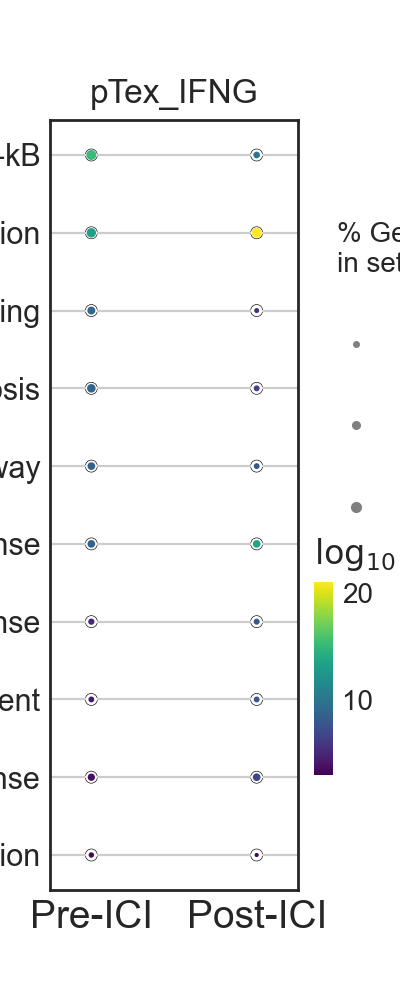

In [1868]:
use_pathway_pTex, ax_pTex = HallMarkPlot(adata_CD8T, 'anno-CD8T', ['Pre'], ['Post', 'PBMC'], 'C04_pTex_IFNG', title='pTex_IFNG')

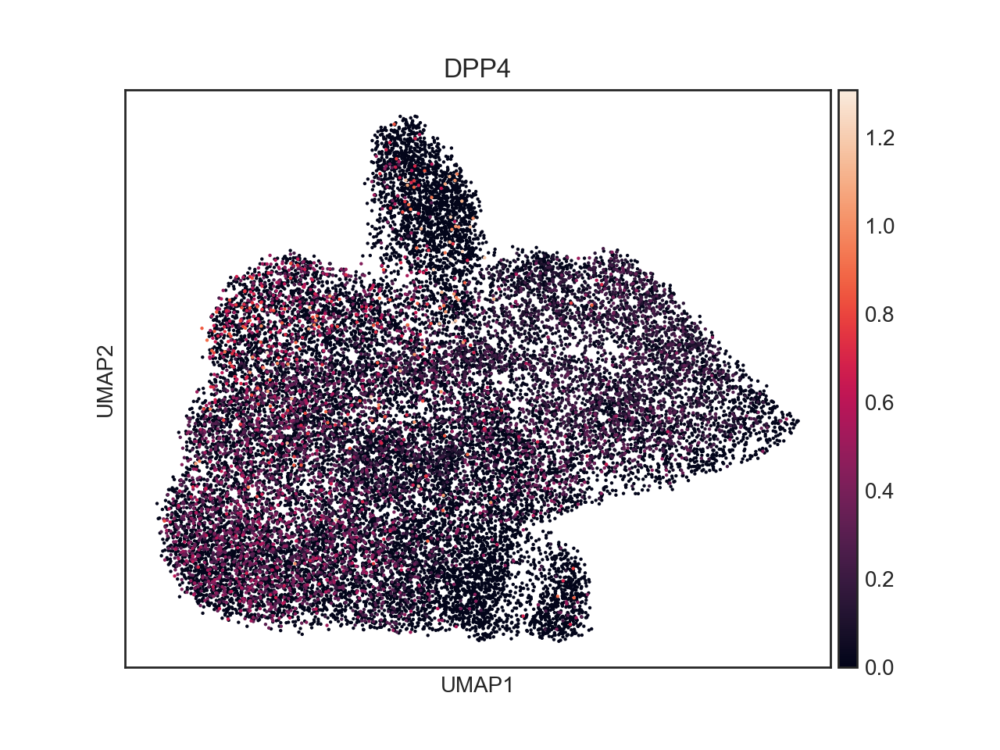

In [1870]:
sc.pl.umap(adata_NK, color=['DPP4'], size=10)

Running enrichment for Pre-ICI C05_tTex_TCF7...
Running enrichment for Post-ICI C05_tTex_TCF7...


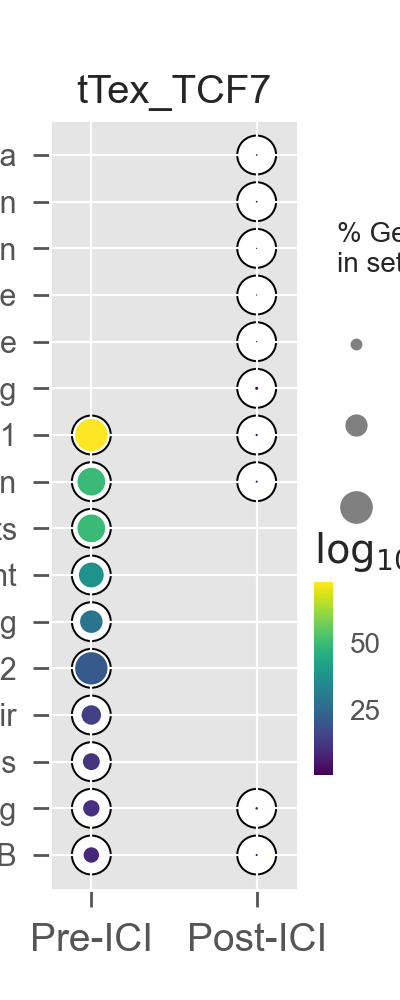

In [1428]:
use_pathway_tTex_TCF7, ax_tTex_TCF7 = HallMarkPlot(adata_CD8T, 'anno-CD8T', ['Pre'], ['Post', 'PBMC'], 'C05_tTex_TCF7', title='tTex_TCF7')

Running enrichment for Pre-ICI C06_tTex_CD8...
Running enrichment for Post-ICI C06_tTex_CD8...


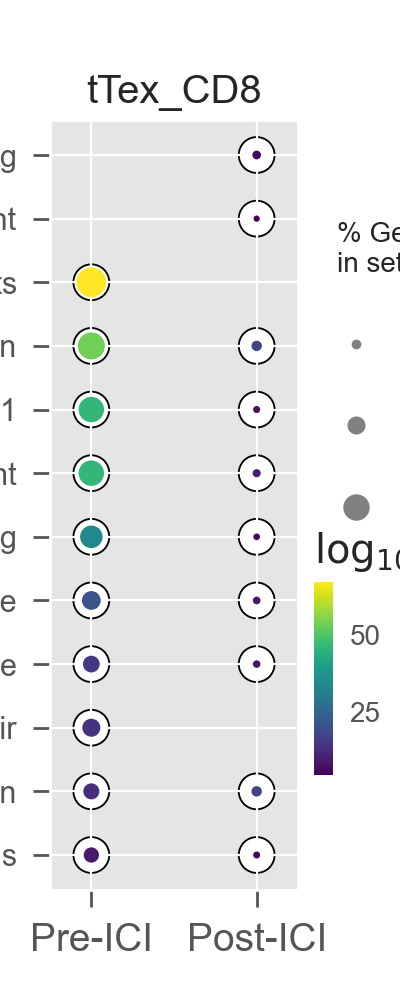

In [1432]:
use_pathway_tTex_CD8, ax_tTex_CD8 = HallMarkPlot(adata_CD8T, 'anno-CD8T', ['Pre'], ['Post', 'PBMC'], 'C06_tTex_CD8', title='tTex_CD8')

Running enrichment for Pre-ICI C07_tTex_CD4...
Running enrichment for Post-ICI C07_tTex_CD4...


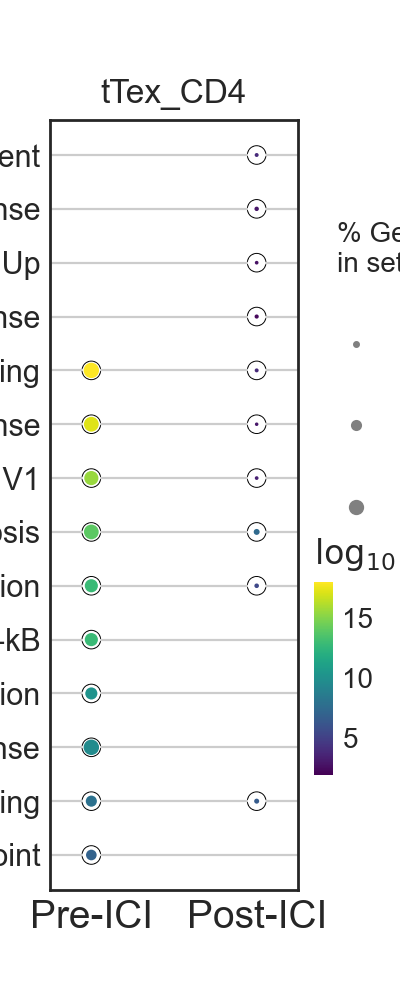

In [1867]:
use_pathway_tTex_CD4, ax_tTex_CD4 = HallMarkPlot(adata_CD8T, 'anno-CD8T', ['Pre'], ['Post', 'PBMC'], 'C07_tTex_CD4', title='tTex_CD4')

Running enrichment for Pre-ICI C08_Treg_FOXP3...
Running enrichment for Post-ICI C08_Treg_FOXP3...


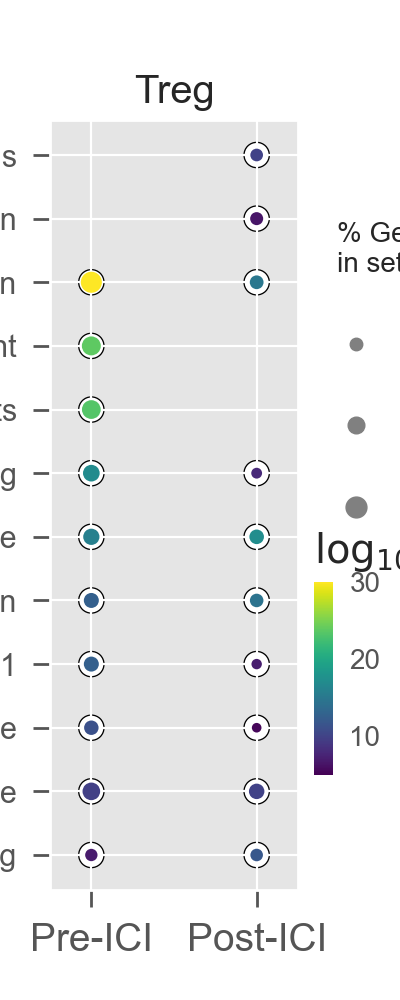

In [1430]:
use_pathway_Treg, ax_Treg = HallMarkPlot(adata_CD4T, 'anno-CD4T', ['Pre'], ['Post', 'PBMC'], 'C08_Treg_FOXP3', title='Treg')

Running enrichment for Pre-ICI C05_NKT_FGFBP2...
Running enrichment for Post-ICI C05_NKT_FGFBP2...


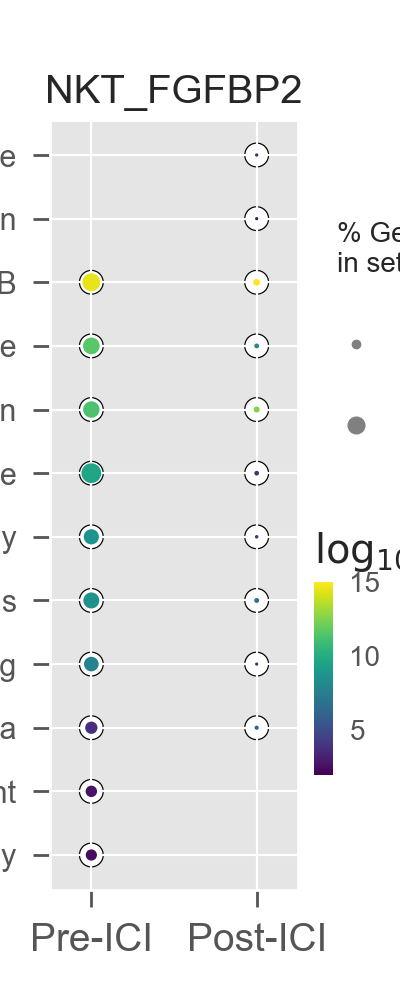

In [1431]:
use_pathway_NKT, ax_NKT = HallMarkPlot(adata_NK, 'anno-NK', ['Pre'], ['Post', 'PBMC'], 'C05_NKT_FGFBP2', title='NKT_FGFBP2')

In [ ]:
degs_NKT_pre = prep_enrichr(adata_NK[adata_NK.obs['treatment'] == 'Pre'], "anno-NK")
degs_NKT_post = prep_enrichr(adata_NK[adata_NK.obs['treatment'].isin(['Post', 'PBMC']) ], "anno-NK")

In [1221]:

ct = 'C05_NKT_FGFBP2'
print("Running enrichment for Pre {}...".format(ct))
go_NKT_pre, _ = run_enrichr_scanpy(degs_NKT_pre, ct,direction='up', top_term=15, all_term=True, plot=False)
go_NKT_pre =  go_NKT_pre[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
go_NKT_pre['anno'] = ct
go_NKT_pre['treatment'] = 'Pre'

print("Running enrichment for Post {}...".format(ct))
go_NKT_post, _ = run_enrichr_scanpy(degs_NKT_post, ct,direction='up', top_term=15, all_term=True, plot=False)
go_NKT_post =  go_NKT_post[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
go_NKT_post['anno'] = ct
go_NKT_post['treatment'] = 'Post'

In [1308]:
degs_CD8T_pre = prep_enrichr(adata_CD8T[adata_CD8T.obs['treatment'] == 'Pre'], "anno-CD8T")
degs_CD8T_post = prep_enrichr(adata_CD8T[adata_CD8T.obs['treatment'].isin(['Post', 'PBMC']) ], "anno-CD8T")

In [1311]:
ct = 'C05_tTex_TCF7'# 'C04_pTex_IFNG'
print("Running enrichment for Pre {}...".format(ct))
go_CD8T_pre, _ = run_enrichr_scanpy(degs_CD8T_pre, ct,direction='up', top_term=15, all_term=True, plot=False)
go_CD8T_pre =  go_CD8T_pre[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
go_CD8T_pre['anno'] = ct
go_CD8T_pre['treatment'] = 'Pre'

print("Running enrichment for Post {}...".format(ct))
go_CD8T_post, _ = run_enrichr_scanpy(degs_CD8T_post, ct,direction='up', top_term=15, all_term=True, plot=False)
go_CD8T_post =  go_CD8T_post[['Gene_set', 'Term', 'Overlap', 'P-value', 'Adjusted P-value', 'Odds Ratio', 'Combined Score']]
go_CD8T_post['anno'] = ct
go_CD8T_post['treatment'] = 'Post'

Running enrichment for Pre C05_tTex_TCF7...
Running enrichment for Post C05_tTex_TCF7...


Text(0.5, 1.0, 'NK5_FGFBP2')

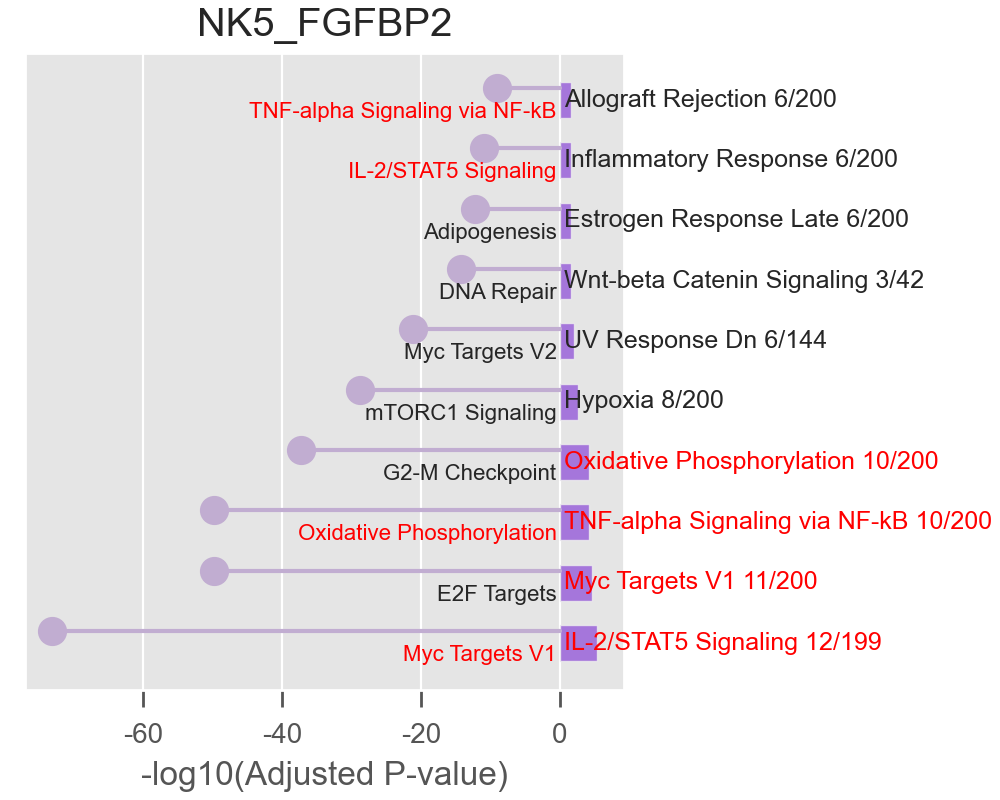

In [1409]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle, Circle

left_pathway = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
# 设置图形大小
fig, ax = plt.subplots(figsize=(5, 4), constrained_layout=True)

# 绘制柱状图
for i, row in enumerate(use_pathway_left['Adjusted P-value']):
    ax.plot([0, np.log10(row)], [i+0.2, i+0.2], 'k-', linewidth=1.5, 
                color='#c1add1',
                label='Pre-ICI')
    ax.scatter(np.log10(row), i+0.2, s=100, color='#c1add1', marker='o')
# rects = ax.barh(range(10), 
#                  np.log10(use_pathway_left['Adjusted P-value']), 
#                  height=0.6, alpha=0.8,color='#c1add1',
#                  label='Pre-ICI')

rects = ax.barh(range(10), 
                 -np.log10(use_pathway_right['Adjusted P-value']), 
                 height=0.6, alpha=0.8,color='#955ad9',
                 label='Pre-ICI')
# rects = ax.barh(range(len(pathway)), 
#                 -np.log10(use_pathway_right['Adjusted P-value']), 
#                 height=0.6, 
#                 alpha=0.8,
#                 label='Post-ICI')
# 绘制基因名称
for i, row in enumerate(use_pathway_left['Term']):
    if row in pathway:
        ax.text(-0.5, i-0.2, f"{row}", ha='right', va='center', fontsize=8, color='red')
    else:
        ax.text(-0.5, i-0.2, f"{row}", ha='right', va='center', fontsize=8)

for i, row in enumerate(use_pathway_right['Term']):
    if row in pathway:
        ax.text(0.5, i, f"{row} {use_pathway_right['Overlap'][i]}", ha='left', va='center', fontsize=9, color='red')
    else:
        ax.text(0.5, i, f"{row} {use_pathway_right['Overlap'][i]}", ha='left', va='center', fontsize=9)

# for i, row in enumerate(use_pathway_left['Overlap']):
#     ax[0].text(1, i, row, ha='left', va='center', fontsize=10)

# for i, row in enumerate(use_pathway_right['Overlap']):
#     ax[1].text(-0.1, i, row, ha='right', va='center', fontsize=10)
# ax.legend( bbox_to_anchor=(1, 0.3), 
#             handletextpad=0.5, frameon=False,
#                         borderpad=0.4,
#                         columnspacing=1,
#                         handlelength=0.65,
#             loc='lower left')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
# ax.spines.top.set_visible(False)
# ax.spines.left.set_visible(False)
# ax.spines.right.set_visible(False)
# 设置刻度
# ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
#                       int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
# ax[1].set_yticks([])
ax.set_title("NK5_FGFBP2")

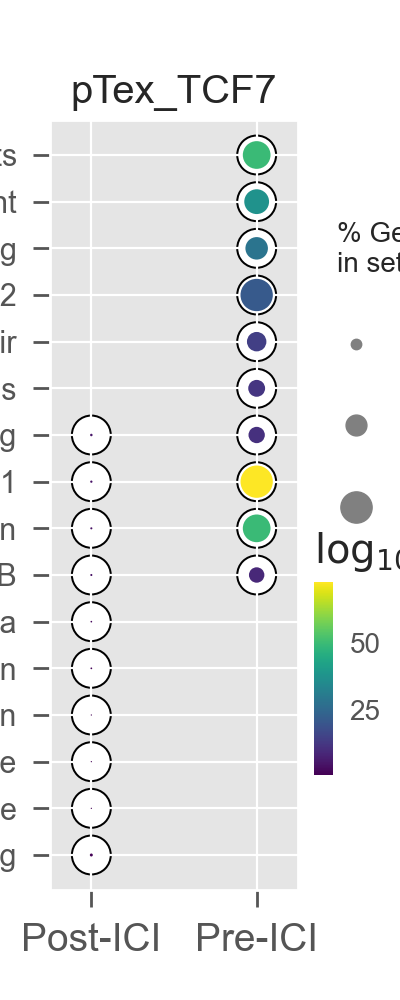

In [1422]:
left_pathway = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
use_pathway = pd.concat([use_pathway_left, use_pathway_right], axis=0)
# sci = SciPalette()
# NbDr = sci.create_colormap() 

ax = gp.dotplot(use_pathway,figsize=(2,5),
                x='treatment',
                title="",
                size=2.5,
                cmap='viridis',
                top_term=10,
                show_ring=True)
ax.set_xticklabels(['Post-ICI', 'Pre-ICI'],rotation=0)
ax.set_yticklabels(ax.get_yticklabels(),rotation=0,fontsize=11)
ax.set_xlabel('')
ax.set_title("pTex_TCF7")
ax.figure.savefig(f"{figPath}/Hallmark_pTex_TCF7.svg", bbox_inches='tight')

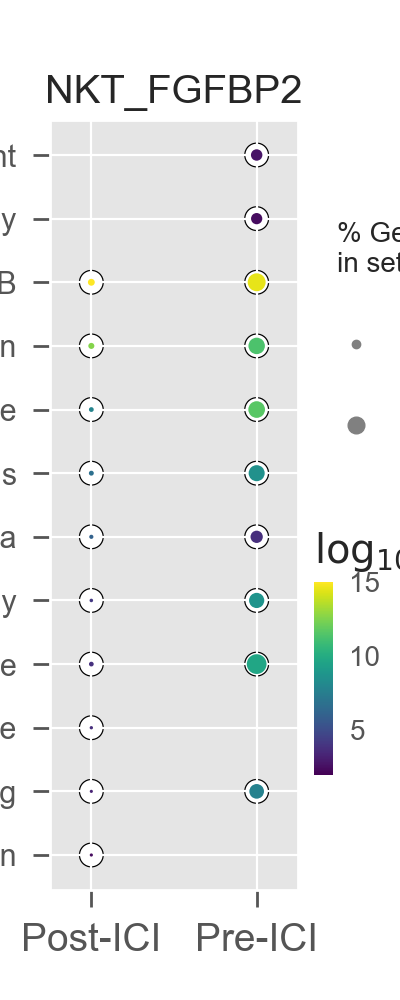

In [1423]:
left_pathway = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
use_pathway = pd.concat([use_pathway_left, use_pathway_right], axis=0)
# sci = SciPalette()
# NbDr = sci.create_colormap() 

ax = gp.dotplot(use_pathway,figsize=(2,5),
                x='treatment',
                title="",
                size=2.5,
                cmap='viridis',
                top_term=10,
                show_ring=True)
ax.set_xticklabels(['Post-ICI', 'Pre-ICI'],rotation=0)
ax.set_yticklabels(ax.get_yticklabels(),rotation=0,fontsize=11)
ax.set_xlabel('')
ax.set_title("NKT_FGFBP2")
ax.figure.savefig(f"{figPath}/Hallmark_NKT_FGFBP2.svg", bbox_inches='tight')

Text(0.5, 1.0, 'NK5_FGFBP2')

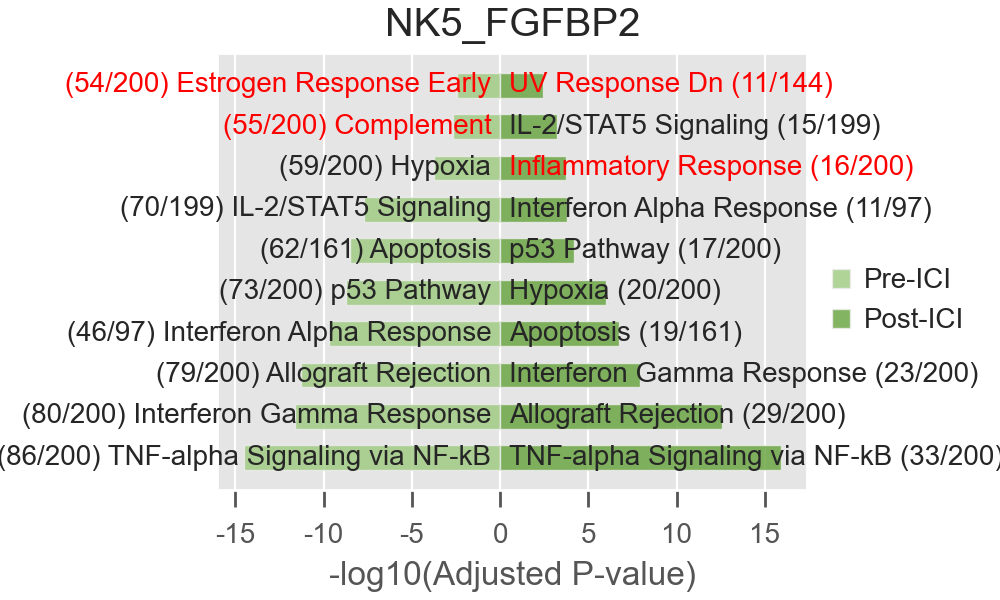

In [ ]:
left_pathway = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
# 设置图形大小
fig, ax = plt.subplots(figsize=(5, 3), constrained_layout=True)

# 绘制柱状图
rects = ax.barh(range(10), 
                 np.log10(use_pathway_left['Adjusted P-value']), 
                 height=0.6, alpha=0.8,color='#9dc97d',
                 label='Pre-ICI')
rects = ax.barh(range(10), 
                 -np.log10(use_pathway_right['Adjusted P-value']), 
                 height=0.6, alpha=0.8,color='#64a23b',
                 label='Post-ICI')
# rects = ax.barh(range(len(pathway)), 
#                 -np.log10(use_pathway_right['Adjusted P-value']), 
#                 height=0.6, 
#                 alpha=0.8,
#                 label='Post-ICI')
# 绘制基因名称
for i, row in enumerate(use_pathway_left['Term']):
    if row in pathway:
        ax.text(-0.5, i, f"{use_pathway_left['Overlap'][i]} {row}", ha='right', va='center', fontsize=10)
    else:
        ax.text(-0.5, i, f"{use_pathway_left['Overlap'][i]} {row}", ha='right', va='center', fontsize=10, color='red')

for i, row in enumerate(use_pathway_right['Term']):
    if row in pathway:
        ax.text(0.5, i, f"{row} {use_pathway_right['Overlap'][i]}", ha='left', va='center', fontsize=10)
    else:
        ax.text(0.5, i, f"{row} {use_pathway_right['Overlap'][i]}", ha='left', va='center', fontsize=10, color='red')

# for i, row in enumerate(use_pathway_left['Overlap']):
#     ax[0].text(1, i, row, ha='left', va='center', fontsize=10)

# for i, row in enumerate(use_pathway_right['Overlap']):
#     ax[1].text(-0.1, i, row, ha='right', va='center', fontsize=10)
ax.legend( bbox_to_anchor=(1, 0.3), 
            handletextpad=0.5, frameon=False,
                        borderpad=0.4,
                        columnspacing=1,
                        handlelength=0.65,
            loc='lower left')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
# ax.spines.top.set_visible(False)
# ax.spines.left.set_visible(False)
# ax.spines.right.set_visible(False)
# 设置刻度
# ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
#                       int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
# ax[1].set_yticks([])
ax.set_title("NK5_FGFBP2")

In [1358]:
pathway

['TNF-alpha Signaling via NF-kB',
 'IL-2/STAT5 Signaling',
 'Myc Targets V1',
 'Oxidative Phosphorylation']

In [1341]:
use_pathway_left

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno,treatment
0,MSigDB_Hallmark_2020,Myc Targets V1,155/200,1.542515e-75,7.712575e-74,16.226741,2795.225999,C05_tTex_TCF7,Pre
1,MSigDB_Hallmark_2020,E2F Targets,133/200,1.017519e-51,1.695865e-50,9.280181,1089.627578,C05_tTex_TCF7,Pre
2,MSigDB_Hallmark_2020,Oxidative Phosphorylation,133/200,1.017519e-51,1.695865e-50,9.280181,1089.627578,C05_tTex_TCF7,Pre
3,MSigDB_Hallmark_2020,G2-M Checkpoint,119/200,4.111190e-39,5.138988e-38,6.834858,604.113283,C05_tTex_TCF7,Pre
4,MSigDB_Hallmark_2020,mTORC1 Signaling,108/200,1.823634e-30,1.823634e-29,5.440623,372.555998,C05_tTex_TCF7,Pre
8,MSigDB_Hallmark_2020,IL-2/STAT5 Signaling,78/199,1.994813e-12,1.108229e-11,2.957031,79.663817,C05_tTex_TCF7,Pre
9,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,74/200,1.773136e-10,8.865680e-10,2.690199,60.403306,C05_tTex_TCF7,Pre
23,MSigDB_Hallmark_2020,Hypoxia,51/200,5.549710e-03,1.156190e-02,1.555557,8.079576,C05_tTex_TCF7,Pre


Text(0.5, 1.0, 'T05_tTex_TCF7')

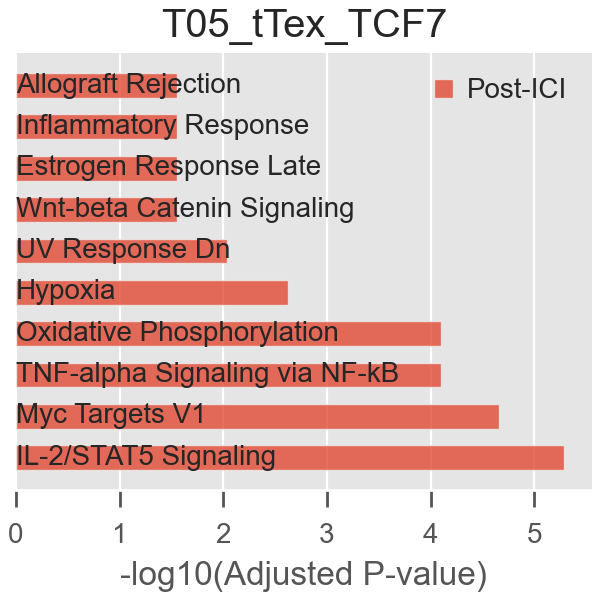

In [1319]:
left_pathway = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_CD8T_pre[go_CD8T_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_CD8T_post[go_CD8T_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

# use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(left_pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(right_pathway)]
# 设置图形大小
fig, ax = plt.subplots(figsize=(3, 3), constrained_layout=True)

# 绘制柱状图
# rects = ax.barh(use_pathway_left['Term'], 
#                  -np.log10(use_pathway_left['Adjusted P-value']), 
#                  height=0.6, alpha=0.8,
#                  label='Pre-ICI')
rects = ax.barh(use_pathway_right['Term'], 
                -np.log10(use_pathway_right['Adjusted P-value']), 
                height=0.6, 
                alpha=0.8,
                label='Post-ICI')
# 绘制基因名称
for i, row in enumerate(use_pathway_right['Term']):
    ax.text(0, i, row, ha='left', va='center', fontsize=10)
ax.legend( #bbox_to_anchor=(1, 0.3), 
            handletextpad=0.5, frameon=False,
                        borderpad=0.4,
                        columnspacing=1,
                        handlelength=0.65,
            loc='best')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
ax.spines.top.set_visible(False)
ax.spines.left.set_visible(False)
ax.spines.right.set_visible(False)
# 设置刻度
# ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
#                       int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
ax.set_title("T05_tTex_TCF7")

Text(0.5, 1.0, 'NK5_FGFBP2')

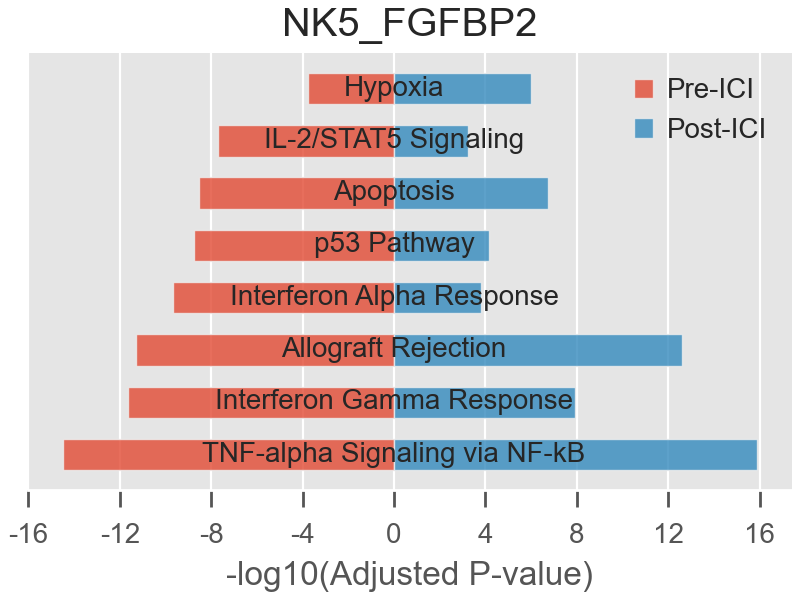

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle, Circle

left_pathway = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
right_pathway = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])][:10]['Term']
pathway = list(set(list(left_pathway)).intersection(list(right_pathway)))

use_pathway_left = go_NKT_pre[go_NKT_pre['Gene_set'].isin(['MSigDB_Hallmark_2020'])]
use_pathway_right = go_NKT_post[go_NKT_post['Gene_set'].isin(['MSigDB_Hallmark_2020'])]

use_pathway_left = use_pathway_left[use_pathway_left['Term'].isin(pathway)]
use_pathway_right = use_pathway_right[use_pathway_right['Term'].isin(pathway)]
# 设置图形大小
fig, ax = plt.subplots(figsize=(4, 3), constrained_layout=True)

# 绘制柱状图
rects = ax.barh(use_pathway_left['Term'], 
                 np.log10(use_pathway_left['Adjusted P-value']), 
                 height=0.6, alpha=0.8,
                 label='Pre-ICI')
rects = ax.barh(use_pathway_right['Term'], 
                -np.log10(use_pathway_right['Adjusted P-value']), 
                height=0.6, 
                alpha=0.8,
                label='Post-ICI')
# 绘制基因名称
for i, row in enumerate(use_pathway_left['Term']):
    ax.text(0, i, row, ha='center', va='center', fontsize=10)
ax.legend( #bbox_to_anchor=(1, 0.3), 
            handletextpad=0.5, frameon=False,
                        borderpad=0.4,
                        columnspacing=1,
                        handlelength=0.65,
            loc='best')

# 设置轴标签和标题
ax.set_xlabel('-log10(Adjusted P-value)')
ax.set_ylabel('')
ax.spines.top.set_visible(False)
ax.spines.left.set_visible(False)
ax.spines.right.set_visible(False)
# 设置刻度
ax.set_xticks(np.arange(int(-np.max(-np.log10(use_pathway_left['Adjusted P-value']))-2),
                      int(np.max(-np.log10(use_pathway_right['Adjusted P-value']))+2), 4))
ax.set_yticks([])
ax.set_title("NK5_FGFBP2")

In [1278]:
use_pathway_right

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno,treatment
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,33/200,2.771423e-18,1.302569e-16,8.420401,340.413010,C05_NKT_FGFBP2,Post
1,MSigDB_Hallmark_2020,Allograft Rejection,29/200,1.087522e-14,2.555676e-13,7.162057,230.276540,C05_NKT_FGFBP2,Post
2,MSigDB_Hallmark_2020,Interferon Gamma Response,23/200,7.494295e-10,1.174106e-08,5.415059,113.779652,C05_NKT_FGFBP2,Post
3,MSigDB_Hallmark_2020,Apoptosis,19/161,1.482769e-08,1.742254e-07,5.538236,99.836500,C05_NKT_FGFBP2,Post
4,MSigDB_Hallmark_2020,Hypoxia,20/200,1.028183e-07,9.664923e-07,4.599810,74.012328,C05_NKT_FGFBP2,Post
5,MSigDB_Hallmark_2020,p53 Pathway,17/200,8.584597e-06,6.724601e-05,3.820602,44.569392,C05_NKT_FGFBP2,Post
6,MSigDB_Hallmark_2020,Interferon Alpha Response,11/97,2.404590e-05,1.614510e-04,5.220271,55.520429,C05_NKT_FGFBP2,Post
7,MSigDB_Hallmark_2020,Inflammatory Response,16/200,3.323651e-05,1.952645e-04,3.568541,36.798296,C05_NKT_FGFBP2,Post
8,MSigDB_Hallmark_2020,IL-2/STAT5 Signaling,15/199,1.139996e-04,5.953314e-04,3.338419,30.310557,C05_NKT_FGFBP2,Post
9,MSigDB_Hallmark_2020,UV Response Dn,11/144,8.140120e-04,3.825857e-03,3.367347,23.953742,C05_NKT_FGFBP2,Post


In [1279]:
use_pathway_left

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Combined Score,anno,treatment
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,86/200,6.316341e-17,3.158171e-15,3.560126,132.795589,C05_NKT_FGFBP2,Pre
1,MSigDB_Hallmark_2020,Interferon Gamma Response,80/200,9.388924e-14,2.347231e-12,3.139562,94.176367,C05_NKT_FGFBP2,Pre
2,MSigDB_Hallmark_2020,Allograft Rejection,79/200,2.950625e-13,4.917709e-12,3.073620,88.678827,C05_NKT_FGFBP2,Pre
3,MSigDB_Hallmark_2020,Interferon Alpha Response,46/97,1.704338e-11,2.130422e-10,4.224174,104.739501,C05_NKT_FGFBP2,Pre
4,MSigDB_Hallmark_2020,p53 Pathway,73/200,1.830256e-10,1.830256e-09,2.700334,60.545260,C05_NKT_FGFBP2,Pre
5,MSigDB_Hallmark_2020,Apoptosis,62/161,3.506217e-10,2.921847e-09,2.937829,63.960401,C05_NKT_FGFBP2,Pre
6,MSigDB_Hallmark_2020,IL-2/STAT5 Signaling,70/199,2.684852e-09,1.917752e-08,2.546706,50.260864,C05_NKT_FGFBP2,Pre
7,MSigDB_Hallmark_2020,Hypoxia,59/200,2.897801e-05,1.811126e-04,1.956197,20.440247,C05_NKT_FGFBP2,Pre
8,MSigDB_Hallmark_2020,Complement,55/200,3.925545e-04,2.180859e-03,1.770803,13.888113,C05_NKT_FGFBP2,Pre
9,MSigDB_Hallmark_2020,Estrogen Response Early,54/200,7.101231e-04,3.550616e-03,1.726098,12.514335,C05_NKT_FGFBP2,Pre


In [1243]:
pathway

{'Allograft Rejection',
 'Apoptosis',
 'Hypoxia',
 'Interferon Alpha Response',
 'Interferon Gamma Response',
 'TNF-alpha Signaling via NF-kB',
 'p53 Pathway'}

In [1242]:
list(use_pathway_left['Term'])

['Apoptosis',
 'TNF-alpha Signaling via NF-kB',
 'Interferon Gamma Response',
 'Allograft Rejection',
 'Interferon Alpha Response',
 'p53 Pathway',
 'Apoptosis',
 'Hypoxia']

In [1207]:
use_pathway.iterrows()

<generator object DataFrame.iterrows at 0x7f1b12da55b0>

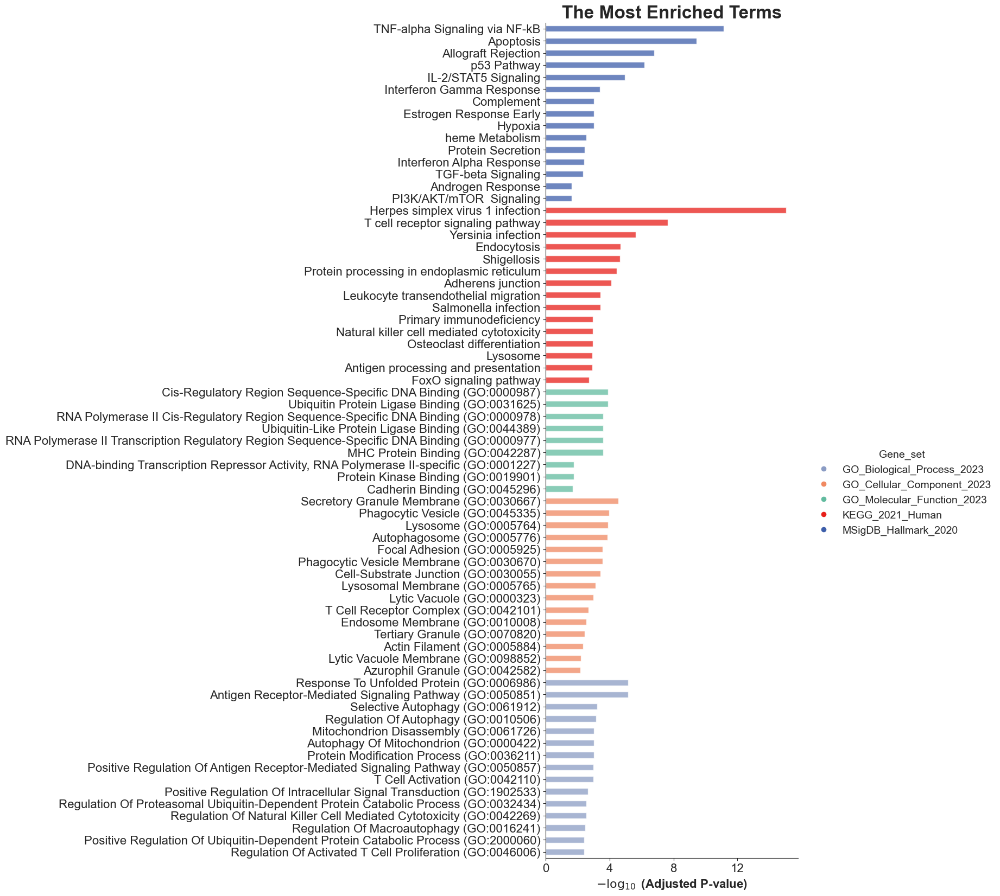

In [598]:
ax = gp.barplot(go_res, figsize=(6,20),
            group ='Gene_set',
            top_term=15,
            color = ['#8b9cc4', '#f08961', '#62bb9f', '#e71f19', '#3d5eaa'],
            title ="The Most Enriched Terms")

In [699]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

In [701]:
adata_T.obs['annotation'] = adata_T.obs['anno-subTfixed']
adata_NK.obs['annotation'] = adata_NK.obs['anno-NK']

In [702]:
adata_CC = adata_NK.concatenate(adata_T[adata_T.obs['annotation'].isin(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2',])], batch_key='major', batch_categories=['NK', 'T'])

Ignoring processing doublet cells...


2025-04-24 06:05:54,224 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7f1b49340790>
Traceback (most recent call last):
  File "/home/rzh/BCY/lib/python3.10/site-packages/threadpoolctl.py", line 847, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/home/rzh/BCY/lib/python3.10/site-packages/threadpoolctl.py", line 984, in _make_controller_from_path
    lib_controller = controller_class(filepath=filepath, prefix=prefix)
  File "/home/rzh/BCY/lib/python3.10/site-packages/threadpoolctl.py", line 111, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
  File "/usr/lib/python3.10/ctypes/__init__.py", line 374, in __init__
    self._handle = _dlopen(self._name, mode)
OSError: /home/rzh/BCY/lib/python3.10/site-packages/numpy.libs/libopenblas64_p-r0-742d56dc.3.2

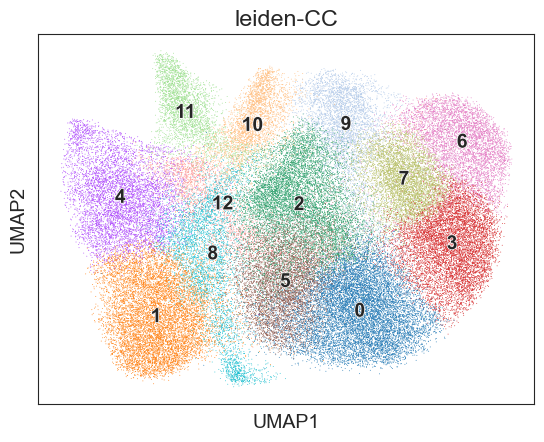

In [707]:
adata_CC = clu(adata_CC, key_added='leiden-CC', do_har=True)

In [710]:
from cellphonedb.src.core.methods import cpdb_statistical_analysis_method
import ktplotspy as kpy

In [732]:
groupby = 'annotation'  # adata.obs['annotation'] for sc data
adata_in = adata_CC.copy() # use highly variable genes
adata_in.write_h5ad("adata-NKTCL-CC.h5ad")
meta = pd.DataFrame(adata_in.obs[groupby].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("./meta.txt", sep='\t', index=False)

cpdb_res = cpdb_statistical_analysis_method.call(
cpdb_file_path="./cellphonedb.zip",
meta_file_path="./meta.txt",
counts_file_path=f"adata-NKTCL-CC.h5ad",
counts_data='hgnc_symbol',
output_path="./cpdb",
threads=16,
)

Reading user files...
The following user files were loaded successfully:
adata-NKTCL-CC.h5ad
./meta.txt
[ ][CORE][24/04/25-07:11:20][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][24/04/25-07:11:25][INFO] Running Real Analysis
[ ][CORE][24/04/25-07:11:25][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [19:54<00:00,  1.19s/it]


[ ][CORE][24/04/25-07:31:27][INFO] Building Pvalues result
[ ][CORE][24/04/25-07:31:29][INFO] Building results
Saved deconvoluted to ./cpdb/statistical_analysis_deconvoluted_04_24_2025_073129.txt
Saved deconvoluted_percents to ./cpdb/statistical_analysis_deconvoluted_percents_04_24_2025_073129.txt
Saved means to ./cpdb/statistical_analysis_means_04_24_2025_073129.txt
Saved pvalues to ./cpdb/statistical_analysis_pvalues_04_24_2025_073129.txt
Saved significant_means to ./cpdb/statistical_analysis_significant_means_04_24_2025_073129.txt


In [733]:
groupby = 'anno-CC'  # adata.obs['annotation'] for sc data
adata_in = adata_CC[adata_CC.obs['treatment'].isin(['Pre'])].copy() # use highly variable genes
adata_in.write_h5ad("adata-NKTCL-CC-Pre.h5ad")
meta = pd.DataFrame(adata_in.obs[groupby].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("./meta.txt", sep='\t', index=False)

cpdb_res_pre = cpdb_statistical_analysis_method.call(
cpdb_file_path="./cellphonedb.zip",
meta_file_path="./meta.txt",
counts_file_path=f"adata-NKTCL-CC-Pre.h5ad",
counts_data='hgnc_symbol',
output_path="./cpdb",
threads=16,
)

Reading user files...
The following user files were loaded successfully:
adata-NKTCL-CC-Pre.h5ad
./meta.txt
[ ][CORE][25/04/25-06:16:36][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][25/04/25-06:16:40][INFO] Running Real Analysis
[ ][CORE][25/04/25-06:16:40][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [13:01<00:00,  1.28it/s]


[ ][CORE][25/04/25-06:29:51][INFO] Building Pvalues result
[ ][CORE][25/04/25-06:29:52][INFO] Building results
Saved deconvoluted to ./cpdb/statistical_analysis_deconvoluted_04_25_2025_062953.txt
Saved deconvoluted_percents to ./cpdb/statistical_analysis_deconvoluted_percents_04_25_2025_062953.txt
Saved means to ./cpdb/statistical_analysis_means_04_25_2025_062953.txt
Saved pvalues to ./cpdb/statistical_analysis_pvalues_04_25_2025_062953.txt
Saved significant_means to ./cpdb/statistical_analysis_significant_means_04_25_2025_062953.txt


In [734]:
groupby = 'anno-CC'  # adata.obs['annotation'] for sc data
adata_in = adata_CC[adata_CC.obs['treatment'].isin(['Post', 'PBMC'])].copy() # use highly variable genes
adata_in.write_h5ad("adata-NKTCL-CC-Post.h5ad")
meta = pd.DataFrame(adata_in.obs[groupby].copy())
meta = meta.reset_index()
meta.columns=['Cell', 'cell_type']
meta.to_csv("./meta.txt", sep='\t', index=False)

cpdb_res_post = cpdb_statistical_analysis_method.call(
cpdb_file_path="./cellphonedb.zip",
meta_file_path="./meta.txt",
counts_file_path=f"adata-NKTCL-CC-Post.h5ad",
counts_data='hgnc_symbol',
output_path="./cpdb",
threads=16,
)

Reading user files...
The following user files were loaded successfully:
adata-NKTCL-CC-Post.h5ad
./meta.txt
[ ][CORE][25/04/25-06:30:03][INFO] [Cluster Statistical Analysis] Threshold:0.1 Iterations:1000 Debug-seed:-1 Threads:16 Precision:3
[ ][CORE][25/04/25-06:30:05][INFO] Running Real Analysis
[ ][CORE][25/04/25-06:30:05][INFO] Running Statistical Analysis


100%|██████████| 1000/1000 [04:35<00:00,  3.63it/s]


[ ][CORE][25/04/25-06:34:49][INFO] Building Pvalues result
[ ][CORE][25/04/25-06:34:51][INFO] Building results
Saved deconvoluted to ./cpdb/statistical_analysis_deconvoluted_04_25_2025_063451.txt
Saved deconvoluted_percents to ./cpdb/statistical_analysis_deconvoluted_percents_04_25_2025_063451.txt
Saved means to ./cpdb/statistical_analysis_means_04_25_2025_063451.txt
Saved pvalues to ./cpdb/statistical_analysis_pvalues_04_25_2025_063451.txt
Saved significant_means to ./cpdb/statistical_analysis_significant_means_04_25_2025_063451.txt


In [711]:
ax = kpy.plot_cpdb_heatmap(pvals=cpdb_res['pvalues'],return_tables=True)

In [1180]:
cpdb_res_pre.keys()

dict_keys(['deconvoluted', 'deconvoluted_percents', 'means', 'pvalues', 'significant_means', 'CellSign_active_interactions', 'CellSign_active_interactions_deconvoluted'])

In [1176]:
cpdb_res_pre.keys()

dict_keys(['deconvoluted', 'deconvoluted_percents', 'means', 'pvalues', 'significant_means', 'CellSign_active_interactions', 'CellSign_active_interactions_deconvoluted'])

In [ ]:
%%R
library(circlize)

# 创建一个数据框，包含节点和边的信息
data <- data.frame(
  from = c("A", "B", "C", "D", "A"),
  to = c("B", "C", "D", "A", "C"),
  value = c(3, 2, 1, 4, 2)
)

# 绘制弦图
chordDiagram(data,
             grid.col = rainbow(n = length(unique(data$from))),
             transparency = 0.5,
             annotationTrack = c("name", "grid"),
             preAllocateTracks = list(track.height = 0.1))

# 添加图例
legend("topright", legend = unique(data$from), fill = rainbow(n = length(unique(data$from))))

In [ ]:
df_heat = kpy.plot_cpdb(
            adata=adata_in,
            cell_type1= 'C05_NKT_FGFBP2',
            cell_type2='.',
            means=cpdb_res['means'],
            pvals=cpdb_res['pvalues'],
            celltype_key=groupby,
            keep_significant_only=True # 其实默认都是true的，保留p<0.05的
        )
df_heat = df_heat.data

In [ ]:
annot = {
  'NK1_MKI67': ['C01_NK_MKI67'],
  'NK2_CD56': ['C02_NK_CD56'],
  'NK3_CD16': ['C03_NK_CD16'],
  'NK4_CD200R1': ['C04_NK_CD200R1'],
  'NK5_FGFBP2': ['C05_NKT_FGFBP2'],
  'NK6_KIT': ['C06_NK_KIT'],
  'NK7_Malig_IL2RA': ['C07_Malig_IL2RA'],
  'NK8_Malig_H2AC11': ['C08_Malig_H2AC11'],
  'T01_Tn_CCR7': ['C01_Tn_CCR7'],
  'T02_Tcm_SELL': ['C02_Tcm_SELL'],
  'T03_Tcm_XCL1': ['C03_Tcm_XCL1'],
  'T04_pTex_IFNG': ['C04_pTex_IFNG'],
  'T05_tTex_TCF7': ['C05_tTex_TCF7'],
  'T06_tTex_CD8': ['C06_tTex_CD8'],
  'T07_tTex_CD4': ['C07_tTex_CD4'],
  'T08_Treg_FOXP3': ['C08_Treg_FOXP3'],
  'T09_Th_CXCL13': ['C09_Th_CXCL13'],
  'T10_Tn/Tcm_IL7R': ['C10_Tn/Tcm_IL7R'],
  'T11_Tctl_GZMK': ['C11_Tctl_GZMK'],
  'T12_Tprol_MKI67': ['C12_Tprol_MKI67'],
  'T13_Malig_MSI2': ['C13_Malig_MSI2']
}
adata_CC = anno(adata_CC, annot, obsKey='anno-CC', obsVal='annotation')

In [ ]:
df = kpy.plot_cpdb(
        adata=adata_CC[adata_CC.obs['treatment'].isin(['Pre'])],
        cell_type1= 'T05_tTex_TCF7|T06_tTex_CD8|T07_tTex_CD4',
        cell_type2='NK2_CD56|NK7_Malig_IL2RA|T12_Tprol_MKI67|T13_Malig_MSI2',
        means=cpdb_res_pre['means'],
        pvals=cpdb_res_pre['pvalues'],
        genes=["PDCD1", 'CTLA4', 'TIGIT', 'CD274', 'HLE', 'CXC', 'CCL', 'CD2', 'ENTPD1', 'CD86', 'IL10', 'DPP4'],
        # gene_family="inhibitory",
        # custom_gene_family={"inhibitory": ["PDCD1", 'CD274','TIGIT', 'ENTPD1','CTLA4', 'DPP4','CCL',]},
        max_size=4,
        max_highlight_size=1,
        highlight_size=0.75,
        degs_analysis=False,
        standard_scale=True,
        return_table=True,
        celltype_key=groupby,
        keep_significant_only=True, # 其实默认都是true的，保留p<0.05的
        figsize=(7,7),
        )

In [ ]:
from plotnine import (
    aes,
    element_blank,
    element_rect,
    element_text,
    geom_point,
    ggplot,
    ggtitle,
    guide_colourbar,
    guide_legend,
    guides,
    options,
    scale_alpha_continuous,
    scale_colour_continuous,
    scale_colour_manual,
    scale_fill_continuous,
    scale_fill_manual,
    scale_size_continuous,
    theme,
    theme_bw,
    theme_matplotlib
)

In [ ]:
df1 = df.copy()

In [ ]:
# DEFAULT_SEP = ">@<"
# df.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df.interaction_group]
y_order = ['IL10-IL10-receptor', 
           'CD274-PDCD1', 
           'CD274-CD80', 
           'NECTIN3-TIGIT',
           'ENTPD1-ADORA2A',
           'CD80-CTLA4',
           'CD86-CTLA4', 
           'CD200-CD200R1',
           'CD70-CD27',
         'CXCL2-DPP4',
         'CXCL9-DPP4',
           'CXCL10-DPP4',
           'CCL22-DPP4',
           'CCL3-CCR1', 
           'CCL3-CCR5',
           'CCL4-CCR5', 
           'CCL5-CCR1',
         'CCL5-CCR5', 
           'CD58-CD2', 
           'CD86-CD28',
             'CD80-CD28',
             'CD48-CD244',
             'CXCL10-CXCR3',
             'CXCL9-CXCR3',
             'CXCL13-CXCR5']
y_order.reverse()
df['interaction_group'] = pd.Categorical(df['interaction_group'], categories=y_order, ordered=True)

In [ ]:
def myplot_cpdb(df, figure_size = (5,6)):
    options.figure_size = figure_size
    colm = "scaled_means"
    highlight_size = 0.75
    max_size = 4
    max_highlight_size = 1
    stroke = "x_stroke"
    default_style = True
    highlight_col = "#d62728"
    cmap_name = "viridis"
    DEFAULT_SEP = ">@<"
    # set global figure size

    g = ggplot(
        df,
        aes(
            x="celltype_group",
            y="interaction_group",
            colour="significant",
            fill=colm,
            size='neglog10p',
            stroke=stroke,
        ),
    )
    g = (
        g
        + geom_point(
            na_rm=True,
        )
        + theme_bw()
        # + theme_matplotlib(rc={"figure.figsize": (4,6), 'font.family': 'Arial'})
        + theme(
            axis_text_x=element_text(angle=90, hjust=0, colour="#000000"),
            axis_text_y=element_text(colour="#000000"),
            axis_ticks=element_blank(),
            axis_title_x=element_blank(),
            axis_title_y=element_blank(),
            legend_key=element_rect(alpha=0, width=0, height=0),
            legend_direction="vertical",
            legend_box="vertical",
        )
        + scale_size_continuous(range=(0, max_size), aesthetics=["size"])
        + scale_size_continuous(range=(0, max_highlight_size), aesthetics=["stroke"])
    )
    if default_style:
        g = (
            g
            + scale_colour_manual(values=highlight_col, na_translate=False)
            + guides(
                fill=guide_colourbar(barwidth=4, label=True, ticks=True, draw_ulim=True, draw_llim=True, order=1),
                size=guide_legend(
                    reverse=True,
                    order=2,
                ),
                stroke=guide_legend(
                    reverse=True,
                    order=3,
                ),
            )
            + scale_fill_continuous(cmap_name=cmap_name)
        )
    if highlight_size is not None:
        g = g + guides(stroke=None)
    return g

In [ ]:
ax_Tex_pre = myplot_cpdb(df, figure_size=(7,6))
ax_Tex_pre.save(f"{figPath}/CPDB-Tex-Pre-filtered1.svg")

In [760]:
df1 = kpy.plot_cpdb(
            adata=adata_CC[adata_CC.obs['treatment'].isin(['Post'])],
            cell_type1= 'T05_tTex_TCF7|T06_tTex_CD8|T07_tTex_CD4',
            cell_type2='NK2_CD56|NK7_Malig_IL2RA|T12_Tprol_MKI67|T13_Malig_MSI2',
            means=cpdb_res_post['means'],
            pvals=cpdb_res_post['pvalues'],
            genes=["PDCD1", 'CTLA4', 'TIGIT', 'CD274', 'HLE', 'CXC', 'CCL', 'CD2', 'ENTPD1', 'CD86', 'IL10', 'DPP4'],
            max_size=4,
            max_highlight_size=1,
            highlight_size=0.75,
            degs_analysis=False,
            cluster_rows=True,
            standard_scale=True,
            celltype_key=groupby,
            keep_significant_only=True, # 其实默认都是true的，保留p<0.05的
            figsize=(7,3.5),
            return_table=True
        )

In [ ]:
DEFAULT_SEP = ">@<"

df1.interaction_group = [c.split(DEFAULT_SEP * 3)[1] for c in df1.interaction_group]
interaction_groups = np.unique(df.interaction_group)
y_order = ['IL10-IL10-receptor', 'CD274-PDCD1', 'CD274-CD80', 'NECTIN3-TIGIT','ENTPD1-ADORA2A','CD80-CTLA4',
           'CD86-CTLA4', 'CD200-CD200R1','CD70-CD27','CXCL2-DPP4','CXCL9-DPP4','CXCL10-DPP4',
           'CCL22-DPP4','CCL3-CCR1', 'CCL3-CCR5','CCL4-CCR5','CCL5-CCR4', 'CCL5-CCR1','CCL5-CCR5', 'CD58-CD2', 
           'CD86-CD28','CD80-CD28','CD48-CD244','CXCL10-CXCR3','CXCL9-CXCR3','CXCL13-CXCR5']
y_order.reverse()

df1['interaction_group'] = pd.Categorical(df1['interaction_group'], categories=y_order, ordered=True)
df1

,interaction_group,celltype_group,scaled_means,pvals,x_means,y_means,x_stroke,neglog10p,significant,is_integrin,directionality,classification
CPI-SS056FF4363>@<>@<>@<CD48-CD244>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7,CD48-CD244,NK2_CD56-T05_tTex_TCF7,0.793750,1.000,0.793750,NaN,0.00,0.0,NaN,False,Ligand-Receptor,NaN
CPI-SS0C2437E0D>@<>@<>@<CXCL13-CXCR5>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7,CXCL13-CXCR5,NK2_CD56-T05_tTex_TCF7,0.073446,1.000,0.073446,NaN,0.00,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
CPI-SS09D4B2070>@<>@<>@<CD274-PDCD1>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7,CD274-PDCD1,NK2_CD56-T05_tTex_TCF7,0.560000,1.000,0.560000,NaN,0.00,0.0,NaN,False,Ligand-Receptor,NaN
CPI-SS0E90C46BC>@<>@<>@<ENTPD1-ADORA2A>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7,ENTPD1-ADORA2A,NK2_CD56-T05_tTex_TCF7,0.623188,1.000,0.623188,NaN,0.00,0.0,NaN,False,Ligand-Receptor,Signaling by Ectonucleoside
CPI-SS0A9E884E0>@<>@<>@<CD200-CD200R1>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7,CD200-CD200R1,NK2_CD56-T05_tTex_TCF7,0.284091,1.000,0.284091,NaN,0.00,0.0,NaN,False,Ligand-Receptor,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
CPI-SS01999882C>@<>@<>@<CD70-CD27>@<>@<>@<T13_Malig_MSI2>@<T07_tTex_CD4,CD70-CD27,T13_Malig_MSI2-T07_tTex_CD4,0.854054,1.000,0.854054,NaN,0.00,0.0,NaN,False,Ligand-Receptor,NaN
CPI-SS029C16DCA>@<>@<>@<CD58-CD2>@<>@<>@<T13_Malig_MSI2>@<T07_tTex_CD4,CD58-CD2,T13_Malig_MSI2-T07_tTex_CD4,0.946342,0.001,NaN,0.946342,0.75,3.0,yes,False,Ligand-Receptor,NaN
CPI-SS0D1D95883>@<>@<>@<CCL4-CCR5>@<>@<>@<T13_Malig_MSI2>@<T07_tTex_CD4,CCL4-CCR5,T13_Malig_MSI2-T07_tTex_CD4,0.243478,0.968,0.243478,NaN,0.00,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines
CPI-SS0EA05941A>@<>@<>@<CCL5-CCR4>@<>@<>@<T13_Malig_MSI2>@<T07_tTex_CD4,CCL5-CCR4,T13_Malig_MSI2-T07_tTex_CD4,0.245098,1.000,0.245098,NaN,0.00,0.0,NaN,False,Ligand-Receptor,Signaling by Chemokines


In [ ]:
ax_Tex_post = myplot_cpdb(df1, figure_size=(7,4))
ax_Tex_post.save(f"{figPath}/CPDB-Tex-post-filtered1.svg")

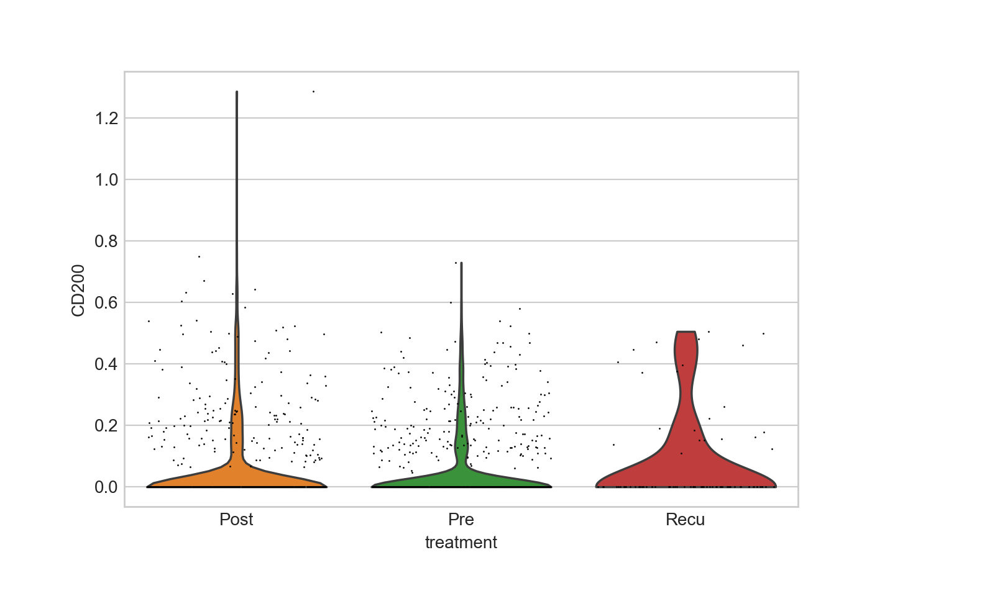

In [1788]:
adata_Tprol = adata_T[adata_T.obs['anno-subTfixed'] == 'C12_Tprol_MKI67']
adata_Tprol = adata_Tprol[adata_Tprol.obs['batch'].isin(['NK5_0', 
             'NK6_0','NK7_0',  'NK8_0', 'NK11_0','NK5_1', 'NK6_1','NK7_1', 'NK8_1','NK11_1', 'RR6_0'])]
sc.pl.violin(adata_Tprol, keys=['CD200'], groupby='treatment', jitter=0.4, scale='width')

In [ ]:
df.neglog10p

CPI-SS056FF4363>@<>@<>@<CD48-CD244>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7         0.0
CPI-SS0C090A257>@<>@<>@<CCL3-CCR5>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7          0.0
CPI-SS01999882C>@<>@<>@<CD70-CD27>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7          0.0
CPI-SS029C16DCA>@<>@<>@<CD58-CD2>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7           0.0
CPI-SS0D1D95883>@<>@<>@<CCL4-CCR5>@<>@<>@<NK2_CD56>@<T05_tTex_TCF7          0.0
                                                                           ... 
CPI-SS0C090A257>@<>@<>@<CCL3-CCR5>@<>@<>@<T07_tTex_CD4>@<NK7_Malig_IL2RA    0.0
CPI-SS01999882C>@<>@<>@<CD70-CD27>@<>@<>@<T07_tTex_CD4>@<NK7_Malig_IL2RA    0.0
CPI-SS029C16DCA>@<>@<>@<CD58-CD2>@<>@<>@<T07_tTex_CD4>@<NK7_Malig_IL2RA     0.0
CPI-SS0D1D95883>@<>@<>@<CCL4-CCR5>@<>@<>@<T07_tTex_CD4>@<NK7_Malig_IL2RA    0.0
CPI-SS0B01D306C>@<>@<>@<CCL5-CCR5>@<>@<>@<T07_tTex_CD4>@<NK7_Malig_IL2RA    0.0
Name: neglog10p, Length: 72, dtype: float64

In [766]:
ax.save(f"{figPath}/CPDB-Tex-Post-filtered.svg")

In [774]:
ax = kpy.plot_cpdb(
        adata=adata_CC[adata_CC.obs['treatment'].isin(['Post'])],
        cell_type1= 'C08_Treg_FOXP3',
        cell_type2='C01_NK_MKI67|C02_NK_CD56|C03_NK_CD16|C04_NK_CD200R1|C05_NKT_FGFBP2|C06_NK_KIT|C07_Malig_IL2RA|C08_Malig_H2AC11',
        means=cpdb_res_post['means'],
        pvals=cpdb_res_post['pvalues'],
        genes="PDCD1|IL10|TIGIT|CD200|CTLA4|CD274|CXC|CCL|HLA",
        max_size=4,
        max_highlight_size=1,
        highlight_size=0.75,
        degs_analysis=False,
        standard_scale=True,
        celltype_key=groupby,
        keep_significant_only=True, # 其实默认都是true的，保留p<0.05的
        figsize=(14,14),
        )

In [775]:
ax.save(f"{figPath}/CPDB-Treg-Post.svg")

In [ ]:
ax = kpy.plot_cpdb(
        adata=adata_CC[adata_CC.obs['treatment'].isin(['Post'])],
        cell_type1= 'C08_Treg_FOXP3',
        cell_type2='C01_NK_MKI67|C02_NK_CD56|C03_NK_CD16|C04_NK_CD200R1|C05_NKT_FGFBP2|C06_NK_KIT|C07_Malig_IL2RA|C08_Malig_H2AC11',
        means=cpdb_res_pre['means'],
        pvals=cpdb_res_pre['pvalues'],
        max_size=4,
        max_highlight_size=1,
        highlight_size=0.75,
        degs_analysis=False,
        standard_scale=True,
        celltype_key=groupby,
        keep_significant_only=True, # 其实默认都是true的，保留p<0.05的
        figsize=(14,14),
        )

In [1828]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3', 'ENTPD1', 'CD200', 'TOX']
infgenes = ["CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18"]
stressgenes = ["BAG3", "CALU", "DNAJB1", "DUSP1", "EGR1", "FOS", "FOSB", "HIF1A", "HSP90AA1", "HSP90AB1", "HSP90B1", "HSPA1A", "HSPA1B", "HSPA6", "HSPB1", "HSPH1", "IER2", "JUN", "JUNB", "NFKBIA", "NFKBIZ", "RGS2", "SLC2A3", "SOCS3", "UBC", "ZFAND2A", "ZFP36", "ZFP36L1"]

In [ ]:
sc.tl.score_genes(adata_CD8T, gene_list=cytogenes, score_name='cytotoxicity', use_raw=False)
sc.tl.score_genes(adata_CD8T, gene_list=exgenes, score_name='exhaustion', use_raw=False)
sc.tl.score_genes(adata_CD8T, gene_list=infgenes, score_name='inflammation', use_raw=False)
sc.tl.score_genes(adata_CD8T, gene_list=stressgenes, score_name='stress', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=cytogenes, score_name='cytotoxicity', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=exgenes, score_name='exhaustion', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=infgenes, score_name='inflammation', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=stressgenes, score_name='stress', use_raw=False)

In [ ]:
Tdf_CD8 = adata_CD8T.obs[['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'anno-CD8T']]
Tdf_CD8.columns = ['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'annotation']
Tdf_NK = adata_NK.obs[['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'anno-NK']]
Tdf_NK.columns = ['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'annotation']